In [1]:
def clearall():
    all = [var for var in globals() if var[0] != "_"]
    for var in all:
        del globals()[var]
clearall()

In [2]:
############################
######## LIBRAIRIES ########
############################
print('Importing Librairies...')
from sklearn.linear_model import LinearRegression
from colorama import Fore, Back, Style
from statsmodels.tsa.vector_ar.vecm import coint_johansen as johasen
from factor_analyzer import FactorAnalyzer
from factor_analyzer.factor_analyzer import calculate_bartlett_sphericity
from factor_analyzer.factor_analyzer import calculate_kmo
from sklearn.decomposition import PCA
import pandas as pd
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
import sklearn.preprocessing
from statsmodels.tsa.stattools import adfuller
from colorama import Fore, Back, Style
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
import time
import os
import datetime as dt
import numpy as np
import fxcmpy
import itertools
import shelve
import ppscore as pps
print('Librairies imported\n')
print('version fxcmpy :',fxcmpy.__version__)
%matplotlib inline
plt.style.use('seaborn')
os.system('say "librairie loaded"')

print('Prêt')

Importing Librairies...
Librairies imported

version fxcmpy : 1.2.6
Prêt


In [3]:
os.system('say "Ignition du Lumberjack"')   

##############################################
######## INITIALISATION DES VARIABLES ########
##############################################


# COMPTE TEST #
'''
TOKEN = '039add1dbe2b344ed08c518a98c7a1796f7a33c2'
server = 'demo'
user_id = 'D261219574'
compte = '01215057'
password = '3555'
'''

'''
# COMPTE DEV #
TOKEN = '79f83cbff13d296eb6d9b6c1ed6dccd768ef925a'
server = 'demo'
user_id = 'D261219577'
compte = '01215060'
password = '3877'
'''



# COMPTE POUBELLE #
TOKEN = 'c212b56921e0f43c191b4e4d27fae725e518786e'
server = 'demo'
user_id = 'D261219576'
compte = '01215059'
password = '8029'


# minutes: 'm1' , 'm5' , 'm15' , 'm30' 
# hours: 'H1' , 'H2', 'H3', 'H4', 'H6' 'H8'
# one day: 'D1'
# one week: 'W1'
# one month: 'M1'
period = 'm5'
number = 10000 # Nombre de periodes pour l'historique
invers = 'non'
diloug = 6016 # 7 jours pour le training
target = 300

break_it = 0
stop = 0
full_stop = 1

sens = 'INIT'
name = 'INIT'

_os = 0
ol = 0
cs = 0
cl = 0
buy1 = 0
buy2 = 0
buy3 = 0
sell1 = 0
sell2 = 0
sell3 = 0
nbposs = 0
nbposl = 0
nbpos = 0
nbre_trade = 0
nbre_trade_long = 0
nbre_trade_short = 0
pnll = 0
pnls = 0
dyn_net_pnl = 0
amplitude = 0
cste = 0
mise = 0
mise0 = 0
mise1 = 0
mise2 = 0
mise3 = 0
mise4 = 0
mark = -1
lim_s1 = 1.5
lim_s2 = 2.3
lim_s3 = 3.4
lim_l1 = -1.5
lim_l2 = -2.3
lim_l3 = -3.4
lim_cs = -0.13
lim_cl = 0.13
dyn_S = 0
dynf = 0
_mean = 0
_std = 0
big_len = 0
chi_square_value = 0
p_value = 0
ev = 0
v = 0
jh_results = 0
v1 = 0
v2 = 0
skew = 0
kurtosis = 0
full_stop = 0
residu = 0
p0ol = 0
p1ol = 0
p2ol = 0
p3ol = 0
p4ol = 0
p0os = 0
p1os = 0
p2os = 0
p3os = 0
p4os = 0
deviamax = 0
take_profit = 200 
usable_margin = 999.99

debut = dt.date(1,1,1)
fin = dt.date(1,1,1)
split = dt.date(1,1,1)


base_pair0 = pd.DataFrame()
base_pair1 = pd.DataFrame()
base_pair2 = pd.DataFrame()
base_pair3 = pd.DataFrame()
base_pair4 = pd.DataFrame()
pair = pd.DataFrame()
pair0 = pd.DataFrame()
pair1 = pd.DataFrame()
pair2 = pd.DataFrame()
pair3 = pd.DataFrame()
pair4 = pd.DataFrame()
daf = pd.DataFrame()
dynamic_combo = pd.DataFrame()
dynamic_residu = pd.DataFrame()
combo = pd.DataFrame()

coef = []
S = []
PAIR = []
CSTE = []
DYNS = []
TICKERS = []
BIG_TICKERS = []
TIME_FRAME = []
INDEX = []
INSTRUMENTS = []
PACK = []
SL_PACK = []
SHORT_LIST = []


D = {}
D = {'_os':_os, 'ol':ol, 'cs':cs, 'cl':cl, 'buy1':buy1, 'buy2':buy2, 'buy3':buy3, 'sell1':sell1, 'sell2':sell2, 'sell3':sell3, 'nbposs':nbposs, 'nbposl':nbposl, 'nbpos':nbpos, 'nbre_trade':nbre_trade, 'nbre_trade_long':nbre_trade_long, 'nbre_trade_short':nbre_trade_short, 'pnll':pnll, 'pnls':pnls, 'amplitude':amplitude, 'cste':cste, 'mise':mise, 'mise0':mise0, 'mise1':mise1, 'mise2':mise2, 'mise3':mise3, 'mise4':mise4, 'mark':mark, 'lim_s1':lim_s1, 'lim_s2':lim_s2, 'lim_s3':lim_s3, 'lim_l1':lim_l1, 'lim_l2':lim_l2, 'lim_l3':lim_l3, 'lim_cs':lim_cs, 'lim_cl':lim_cl, 'dyn_S':dyn_S, '_mean':_mean, '_std':_std, 'big_len':big_len, 'chi_square_value':chi_square_value, 'p_value':p_value, 'ev':ev, 'v':v, 'jh_results':jh_results, 'v1':v1, 'v2':v2, 'skew':skew, 'kurtosis':kurtosis, 'dynf':dynf, 'residu':residu, 'p0ol':p0ol, 'p1ol':p1ol, 'p2ol':p2ol, 'p3ol':p3ol, 'p4ol':p4ol, 'p0os':p0os, 'p1os':p1os, 'p2os':p2os, 'p3os':p3os, 'p4os':p4os, 'debut':debut, 'fin':fin, 'split':split, 'base_pair0':base_pair0, 'base_pair1':base_pair1, 'base_pair2':base_pair2, 'base_pair3':base_pair3, 'base_pair4':base_pair4, 'pair':pair, 'pair0':pair0, 'pair1':pair1, 'pair2':pair2, 'pair3':pair3, 'pair4':pair4, 'coef':coef, 'S':S, 'PAIR':PAIR, 'CSTE':CSTE, 'DYNS':DYNS, 'TICKERS':TICKERS, 'BIG_TICKERS':BIG_TICKERS, 'TIME_FRAME':TIME_FRAME, 'INDEX':INDEX, 'INSTRUMENTS':INSTRUMENTS, 'PACK':PACK, 'SL_PACK':SL_PACK, 'SHORT_LIST':SHORT_LIST, 'TOKEN':TOKEN, 'server':server, 'user_id':user_id, 'compte':compte, 'password':password, 'period':period, 'number':number, 'invers':invers, 'diloug':diloug, 'break_it':break_it, 'stop':stop, 'full_stop':full_stop, 'sens':sens, 'name':name, 'dyn_net_pnl':dyn_net_pnl, 'deviamax':deviamax,'take_profit':take_profit}
for key,val in D.items():
    exec(key + '=val')
os.system('say "בסדר"')


print(Style.BRIGHT,Back.LIGHTWHITE_EX,Fore.RED,'Longueur de D',len(D),Style.RESET_ALL)
type(D)

   Longueur de D 104 


dict

In [4]:

############################
######## FONCTIONS ########
###########################


def conX():
    con = fxcmpy.fxcmpy(access_token=TOKEN, log_level='error',server=server)
    if con.is_connected() == True:
        print(Fore.GREEN+'Connexion établie'+Style.RESET_ALL)
        print('Compte utilisé : ',con.get_account_ids())
    else:
        print(Fore.RED+'Connexion non établie'+Style.RESET_ALL)
    return(con)

def deconX():
    con.close()
    if con.is_connected() == True:
        print(Fore.GREEN+'Connexion non intérrompue'+Style.RESET_ALL)
        print('Compte utilisé : ',con.get_account_ids())
    else:
        print(Fore.RED+'Connexion intérrompue'+Style.RESET_ALL)
    return()

def remove_index(INDEX):
    
    for key,val in D.items():
        exec(key + '=val')
    for x in range(big_len):
        for ind in INDEX:
            if ind not in (globals()['uni_df%s' % x]).index :
                INDEX.remove(ind)
    return(INDEX)

def clean_index(df):
    for key,val in D.items():
        exec(key + '=val')
    I = []
    for i in range(0,len(df)):
        if df.index[i] not in INDEX:
            I.append(i)
    df = df.drop(df.index[I])
    return(df)


def scrap_hist(ticker,invers = 'non'):
    data = con.get_candles(ticker,period=period,number=number)
    df = pd.DataFrame(index=data.index)
    df['Open'] = (data['bidopen']+data['askopen'])/2
    df['High'] = (data['bidhigh']+data['askhigh'])/2
    df['Low'] = (data['bidlow']+data['asklow'])/2
    df['Close'] = (data['bidclose']+data['askclose'])/2
    if invers == 'oui':
        df['Open'] = 1 / df['Open']
        df['High'] = 1 / df['High']
        df['Low'] = 1 / df['Low']
        df['Close'] = 1 / df['Close']

    return(df)

def scrap_close(ticker,invers = 'non'):
    print('Scraping des données pour le ticker',ticker,'avec inversion à ',invers)
    data = con.get_candles(ticker,period=period,number=number)
    df = pd.DataFrame(index=data.index)
    df['Close'] = (data['bidclose']+data['askclose'])/2
    if invers == 'oui':
        df['Close'] = 1 / df['Close']

    return(df)

def isname(pair,D):
    #global name
    for key,val in D.items():
        exec(key + '=val')
    if pair.equals(pair0):
        name = TICKERS[0]
    elif pair.equals(pair1):
        name = TICKERS[1]
    elif pair.equals(pair2):
        name = TICKERS[2]
    elif pair.equals(pair3):
        name = TICKERS[3]
    elif pair.equals(pair4):
        name = TICKERS[4]
    
    return(name,D)

def revname(name,D):
    for key,val in D.items():
        exec(key + '=val')
    if name == TICKERS[0]:
        pair = pair0
    elif name == TICKERS[1]:
        pair = pair1
    elif name == TICKERS[2]:
        pair = pair2
    elif name == TICKERS[3]:
        pair = pair3
    elif name == TICKERS[4]:
        pair = pair4
        
    return(pair,D)

def ols(model,results,residuals):
    jb = sm.stats.stattools.jarque_bera(residuals)[0]
    p_value = sm.stats.stattools.jarque_bera(residuals)[1]
    skew = round(sm.stats.stattools.robust_skewness(residuals)[0],4)
    kurtosis = round(sm.stats.stattools.robust_kurtosis(residuals)[0],4)
    durbinwatson = sm.stats.stattools.durbin_watson(residuals, axis=0)
    return(jb,p_value,skew,kurtosis,durbinwatson)

def ols_diff(diff):
    model_diff = sm.OLS(diff[1:],df.index[1:])
    results_diff = model_diff.fit()
    residuals_diff = results_diff.resid
    summary_diff = results_diff.summary()

    jb_diff = sm.stats.stattools.jarque_bera(residuals_diff)[0]
    p_value_diff = sm.stats.stattools.jarque_bera(residuals_diff)[1]
    skew_diff = round(sm.stats.stattools.robust_skewness(residuals_diff)[0],4)
    kurtosis_diff = round(sm.stats.stattools.robust_kurtosis(residuals_diff)[0],4)
    durbinwatson_diff = sm.stats.stattools.durbin_watson(residuals_diff, axis=0)
    return(jb_diff,p_value_diff,skew_diff,kurtosis_diff,durbinwatson_diff)

def jarque_berra(df):
    if p_value <= 0.05:
        stop = 0
    else:
        stop = 1
    return(stop)

def skewness(df):
    if skew < -0.1 or skew > 0.1:
        stop = 0
    else:
        stop = 1
    return(stop)

def kurtos(df):
    if kurtosis > -3.1 or kurtosis < 3.1:
        stop = 0
    else:
        stop = 1
    return(stop)

def autocor(df):
    autocorell = pd.DataFrame()
    autocorell['ACF'] = sm.tsa.stattools.acf(df['Close'],qstat=True,fft=False)[0]
    autocorell['PACF'] = sm.tsa.stattools.pacf(df['Close'])
    QSTAT = list(sm.tsa.stattools.acf(df['Close'],qstat=True,fft=False)[1])
    QSTAT.append(df.iloc[-1]['Close'])
    PROB = list(sm.tsa.stattools.acf(df['Close'],qstat=True,alpha=0.05,fft=False)[3])
    PROB.append(0.5)
    autocorell['QSTAT'] = QSTAT
    autocorell['PROB'] = PROB
    index = 0
    for i in range(len(autocorell)-1):
        if autocorell.iloc[i]['PACF']>autocorell.iloc[i]['PROB']+0.1:
            index += 1
    if index >= 1:
        stop = 0
    else:
        stop = 1
    return(stop)

def autocor_diff(diff):
    autocorell = pd.DataFrame()
    autocorell['ACF'] = sm.tsa.stattools.acf(diff,qstat=True,fft=False)[0]
    autocorell['PACF'] = sm.tsa.stattools.pacf(diff)
    QSTAT = list(sm.tsa.stattools.acf(diff,qstat=True)[1],fft=False)
    QSTAT.append(0)
    PROB = list(sm.tsa.stattools.acf(diff,qstat=True,alpha=0.05)[3],fft=False)
    PROB.append(0.5)
    autocorell['QSTAT'] = QSTAT
    autocorell['PROB'] = PROB
    index = 0
    for i in range(len(autocorell)-1):
        if autocorell.iloc[i]['PACF']>autocorell.iloc[i]['PROB']+0.1:
            index += 1
    if index >= 1:
        p = 1
    else:
        stop = 1
    return()

def test_stationarity(timeseries,lag):
    rolmean = timeseries.rolling(window=12).mean()
    rolstd = timeseries.rolling(window=12).std()

    dftest = adfuller(timeseries, autolag=None,maxlag=lag )#'AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    return(dfoutput)

def test_adf(df):
    X = df['Close'].values
    result_adf = adfuller(X)
    
    for key, value in result_adf[4].items():
        print('\t%s: %.3f' % (key, value))

    if result_adf[1] >= 0.05:
        stop = 1
    else:
        stop = 0
        
    X = diff[1:].values
    result_adf = adfuller(X)
    
    if result_adf[1] >= 0.05 :
        stop = 1

    elif result_adf[0] >= min([result_adf[4]['1%'],result_adf[4]['5%'],result_adf[4]['10%']]):
        stop = 1

    else:
        stop = 0
    return(stop)


def train(base_pair0,base_pair1,base_pair2,base_pair3,base_pair4,TIME_FRAME,TICKERS,D):
    global nbre_trade, PAIR, mise, cs, pnls, _std, sens, name, skew, nbposl, v1, nbre_trade_long, lim_l2, BIG_TICKERS, nbposs, compte, fin, p3ol, full_stop, pnll, buy2, lim_cs, amplitude, lim_s1, break_it, p3os, chi_square_value, period, split, lim_s2, TOKEN, _mean, coef, user_id, p0ol, sell1, sell2, p_value, p2os, buy3, jh_results, kmo_all, DYNS, SL_PACK, cl, p1os, lim_s3, _os, dyn_S, pair4, pair3, v, S, PACK, lim_cl, sell3, nbpos, buy1, SHORT_LIST, stop, daf, p1ol, diloug, p4ol, v2, big_len, invers, lim_l3, dynf, INSTRUMENTS, deviamax, password, pair2, p2ol, cste, kurtosis, CSTE, residu, p4os, lim_l1, server, number, dyn_net_pnl, mark, pair1, ol, ev, pair0, nbre_trade_short, p0os, pair, INDEX, debut, dynamic_combo, dynamic_residu,take_profit,usable_margin, combo

    for key,val in D.items():
        exec(key + '=val')
    
    now = time.localtime(time.time())
    print('\nHeure locale du début du train : ',time.strftime("%Y-%m-%d %H:%M:%S", now),'\n')

    
    print(Style.RESET_ALL,'')
    debut = TIME_FRAME[-diloug]#-576] #suppression des 2 jours
    split = TIME_FRAME[-1]#576] #suppression des 2 jours
    fin = TIME_FRAME[-1]#
    print(Fore.MAGENTA,'')
    print('|||| TIME_FRAME <---> debut :',TIME_FRAME[-diloug],' <---> split : ',split) 
    D['debut'] = debut
    D['split'] = split
    D['fin'] = fin
    for key,val in D.items():
        exec(key + '=val')
    pair0 = base_pair0[(base_pair0.index >= debut)&(base_pair0.index <= split)]
    pair0['Local time'] = pair0.index
    pair0.reset_index(drop=True, inplace=True)
    D['pair0'] = pair0
    print('Récupération pair0 => ',pair0.shape)
    pair1 = base_pair1[(base_pair1.index >= debut)&(base_pair1.index <= split)]
    pair1['Local time'] = pair1.index
    pair1.reset_index(drop=True, inplace=True)
    D['pair1'] = pair1
    print('Récupération pair1 => ',pair1.shape)
    pair2 = base_pair2[(base_pair2.index >= debut)&(base_pair2.index <= split)]
    pair2['Local time'] = pair2.index
    pair2.reset_index(drop=True, inplace=True)
    D['pair2'] = pair2
    print('Récupération pair2 => ',pair2.shape)
    pair3 = base_pair3[(base_pair3.index >= debut)&(base_pair3.index <= split)]
    pair3['Local time'] = pair3.index
    pair3.reset_index(drop=True, inplace=True)
    D['pair3'] = pair3
    print('Récupération pair3 => ',pair3.shape)
    pair4 = base_pair4[(base_pair4.index >= debut)&(base_pair4.index <= split)]
    pair4['Local time'] = pair4.index
    pair4.reset_index(drop=True, inplace=True)
    D['pair4'] = pair4
    print('Récupération pair4 => ',pair4.shape)

    PAIR = [pair0,pair1,pair2,pair3,pair4]
    D['PAIR'] = PAIR
    
    for key,val in D.items():
        exec(key + '=val')
    print('Longueur de PAIR []', len(PAIR))

    for pair in PAIR:
        if pair.equals(pair0):
            name = TICKERS[0]
        elif pair.equals(pair1):
            name = TICKERS[1]
        elif pair.equals(pair2):
            name = TICKERS[2]
        elif pair.equals(pair3):
            name = TICKERS[3]
        elif pair.equals(pair4):
            name = TICKERS[4]
        print('Passage pour',name)
        model = sm.OLS(pair['Close'],pair.index)
        results = model.fit()
        residuals = results.resid
        summary = results.summary()

        jb,p_value,skew,kurtosis,durbinwatson = ols(model,results, residuals)

        jarque_berra(pair)
        skewness(pair)
        kurtos(pair)
        autocor(pair)

    ####################
    daf = pd.DataFrame()
    ####################

    for pair in PAIR:
        if pair.equals(pair0):
            name = TICKERS[0]
        elif pair.equals(pair1):
            name = TICKERS[1]
        elif pair.equals(pair2):
            name = TICKERS[2]
        elif pair.equals(pair3):
            name = TICKERS[3]
        elif pair.equals(pair4):
            name = TICKERS[4]
        daf[name] = list(pair['Close'])
    daf.corr().style.background_gradient(cmap='coolwarm')
    
    D['daf'] = daf
    for key,val in D.items():
        exec(key + '=val')
    
    INTEGRE = []
    for col in range(1,len(daf.corr())):
        for ind in range(col):
            if daf.corr().iloc[ind,col] > 0.5 and daf.corr().iloc[ind,col] != 1:
                INTEGRE.append((daf.corr().index[ind],daf.corr().columns[col]))

    INTEGRE  = list(set(INTEGRE))
    D['INTEGRE'] = INTEGRE
    for key,val in D.items():
        exec(key + '=val')
    kmo_all,kmo_model=calculate_kmo(daf)

    for loop,pair in enumerate(PAIR):
        if pair.equals(pair0):
            name = TICKERS[0]
        elif pair.equals(pair1):
            name = TICKERS[1]
        elif pair.equals(pair2):
            name = TICKERS[2]
        elif pair.equals(pair3):
            name = TICKERS[3]
        elif pair.equals(pair4):
            name = TICKERS[4]
        if kmo_all[loop] >= 0.6:
            print(Fore.GREEN,name,Style.RESET_ALL,' a un kmo considéré comme ',Fore.GREEN,'adéquat',Style.RESET_ALL)
        else:
            print(Fore.RED,name,Style.RESET_ALL,' a un kmo donsidéré comme ',Fore.RED,'inadéquat',Style.RESET_ALL)
            break_it = 1

    chi_square_value,p_value=calculate_bartlett_sphericity(daf)
    if p_value < 0.05:
        stop = 0
    else:
        stop = 1
        if nbposs == 0 and nbposl == 0 : 
            #continue
            print(Back.WHITE,Fore.CYAN,'\n\n\nLIGNE 434\n\n\n',Style.RESET_ALL)

    fa = FactorAnalyzer(rotation=None)
    fa.fit(daf)

    ev, v = fa.get_eigenvalues()

    PRINCIPAL_COMPOSANT = []
    for loop,pair in enumerate(PAIR):
        if pair.equals(pair0):
            name = TICKERS[0]
        elif pair.equals(pair1):
            name = TICKERS[1]
        elif pair.equals(pair2):
            name = TICKERS[2]
        elif pair.equals(pair3):
            name = TICKERS[3]
        elif pair.equals(pair4):
            name = TICKERS[4]
        if ev[loop] >= 1:
            PRINCIPAL_COMPOSANT.append((name,ev[loop]))

    jh_results = johasen(daf,0,1)
    v1 = jh_results.evec[:, 0]
    v2 = jh_results.evec[:, 1]
    if jh_results.eig[0] <= 0.05:
        stop = 0
    else:
        stop = 1
        if nbposs == 0 and nbposl == 0 : 
            #continue
            print(Back.WHITE,Fore.CYAN,'\n\n\nLIGNE 456\n\n\n',Style.RESET_ALL)
    
    X = daf.iloc[:,1:]
    y = daf.iloc[:,0]
    reg = LinearRegression().fit(X, y)
    score = reg.score(X, y) *100
    coef = reg.coef_
    cste = reg.intercept_
    CSTE.append(cste)

    D['coef'] = coef
    D['cste'] = cste
    D['CSTE'] = CSTE
    for key,val in D.items():
        exec(key + '=val')
    
    if score > 70:
        print('SCORE > 70')
        stop = 0
        for loop,pair in enumerate (PAIR):
            if pair.equals(pair0):
                name = TICKERS[0]
            elif pair.equals(pair1):
                name = TICKERS[1]
            elif pair.equals(pair2):
                name = TICKERS[2]
            elif pair.equals(pair3):
                name = TICKERS[3]
            elif pair.equals(pair4):
                name = TICKERS[4]
            if loop == 0:
                #continue
                print('Paire principale :',name)
            #loop += 1
            else:
                try:
                    print(name,' - coef : ',coef[loop-1]) 
                except:
                    print('Problème calculationique')
                    stop = 1
                    if nbposs == 0 and nbposl == 0 : 
                        continue
                        print(Back.WHITE,Fore.CYAN,'\n\n\nLIGNE 481\n\n\n',Style.RESET_ALL)
                           
    elif score > 50:
        print('SCORE > 50')
        loop = 0
        for pair in PAIR:
            if pair.equals(pair0):
                name = TICKERS[0]
            elif pair.equals(pair1):
                name = TICKERS[1]
            elif pair.equals(pair2):
                name = TICKERS[2]
            elif pair.equals(pair3):
                name = TICKERS[3]
            elif pair.equals(pair4):
                name = TICKERS[4]
            if name == TICKERS[0]:
                continue
            loop += 1
            try:
                print(name,' : ',coef[loop])
            except:
                stop = 1
                if nbposs == 0 and nbposl == 0 : 
                    continue
                    print(Back.WHITE,Fore.CYAN,'\n\n\nLIGNE 497\n\n\n',Style.RESET_ALL)

    else:
        print('SCORE < 50')
        stop = 1
        loop = 0
        for pair in PAIR:
            if pair.equals(pair0):
                name = TICKERS[0]
            elif pair.equals(pair1):
                name = TICKERS[1]
            elif pair.equals(pair2):
                name = TICKERS[2]
            elif pair.equals(pair3):
                name = TICKERS[3]
            elif pair.equals(pair4):
                name = TICKERS[4]
            if name == TICKERS[0]:
                continue
            loop += 1
            try:
                print(name,' : ',coef[loop])
            except:
                stop = 1
                if nbposs == 0 and nbposl == 0 : 
                    print(Back.WHITE,Fore.CYAN,'\n\n\nLIGNE 512\n\n\n',Style.RESET_ALL)
                    continue

    combo = coef[0] * daf[TICKERS[1]] + coef[1] * daf[TICKERS[2]] + coef[2] * daf[TICKERS[3]] + coef[3] * daf[TICKERS[4]] + cste
    print('TICKERS : ',TICKERS)
    print('COEF',coef)
    print('CSTE',cste)
    print('Dernière valeur du combo à ',combo.iloc[-1])
    ########
    ### RESIDUS
    ########
    residu = daf[TICKERS[0]] - combo
    print('Derniere valeur du residu',residu.iloc[-1])
    S = (residu - residu.mean())/residu.std()
    print('Dernière valeur du Score',S.iloc[-1])
    _mean = residu.mean()
    print('Mean',_mean)
    _std = residu.std()
    print('Std',_std)

    D['_mean'] = _mean
    D['_std'] = _std
    D['S'] = S
    D['coef'] = coef
    D['residu'] = residu 
    D['combo'] = combo
    for key,val in D.items():
        exec(key + '=val')

    print(' Pour les TICKERS :',TICKERS,', - Moyenne du spread :',_mean,' - Std Dev du spread : ',_std)
    print('La déviation est de :',abs(S.iloc[-1])-S.mean())
    #print('Estimation de la mise pour une target de $200 par déviation:', 200 / _std)
    

    ####
    ## ANALYSE DES RESIDUS
    ###

    jarque_berra(residu)
    skewness(residu)
    kurtos(residu)
    residu_autocor = pd.DataFrame()
    residu_autocor['Close'] = residu.iloc[:]
    autocor(residu_autocor)

    model = sm.OLS(residu,residu.index)
    results = model.fit()
    residuals = results.resid
    summary = results.summary()
    name = 'Analyse des Résidus'
    jb,p_value,skew,kurtosis,durbinwatson = ols(model,results, residuals)

    dfoutput =  test_stationarity(residu,lag = 1)
    if dfoutput[1] < 0.05 and dfoutput[0] < dfoutput[6]:
        print('Le test est ',Fore.GREEN,'VALIDE',Style.RESET_ALL,'et le résidu est : ',Fore.GREEN,'STATIONNAIRE',Style.RESET_ALL)
        
        stop = 0
    else:
        print('Le test est ',Fore.RED,'NON VALIDE',Style.RESET_ALL,'et le résidu  : ',Fore.RED,'NON STATIONNAIRE',Style.RESET_ALL)
        stop = 1
        if nbposs == 0 and nbposl == 0 : 
            #continue
            print(Back.WHITE,Fore.CYAN,'\n\n\nLIGNE 550\n\n\n',Style.RESET_ALL)

    #######
    ### RETOUR A LA MOYENNE
    #######
    dfoutput =  test_stationarity(residu,lag = 0)

    if dfoutput[1] < 0.05 and dfoutput[0] < dfoutput[6]:
        print('Le test est ',Fore.GREEN,'VALIDE',Style.RESET_ALL,'et il y a : ',Fore.GREEN,'RETOUR A LA MOYENNE',Style.RESET_ALL)
        _retmoy1 = dfoutput[1]
        _retmoy6 = dfoutput[6]
        # stop = 0 # => On veut que tout soit validé avant. Donc pas de stop à 0 ici
    else:
        print('Le test est ',Fore.RED,'NON VALIDE',Style.RESET_ALL,"et il n'y a ",Fore.RED,'PAS RETOUR A LA MOYENNE',Style.RESET_ALL)
        stop = 1
        if nbposs == 0 and nbposl == 0 : 
            #continue
            print(Back.WHITE,Fore.CYAN,'\n\n\nLIGNE 565\n\n\n',Style.RESET_ALL)


    chi_square_value,p_value=calculate_bartlett_sphericity(daf)
    if p_value < 0.05:
        print(Fore.GREEN,'Statistically significant',Style.RESET_ALL," ce qui signifie que la matrice de correlation observée n'est pas une identity matrix" )
        #pass
    else:
        print(Fore.RED,'Statistically non significant',Style.RESET_ALL," ce qui signifie que la matrice de correlation observée peut être une identity matrix" )
        #pass

    fa = FactorAnalyzer(rotation=None)
    fa.fit(daf)

    ev, v = fa.get_eigenvalues()



    pca = PCA(n_components=2)
    pca.fit(daf)

    x_pca = pca.transform(daf)
    x_pca.shape


    for loop,pair in enumerate(PAIR):
        if pair.equals(pair0):
            name = TICKERS[0]
        elif pair.equals(pair1):
            name = TICKERS[1]
        elif pair.equals(pair2):
            name = TICKERS[2]
        elif pair.equals(pair3):
            name = TICKERS[3]
        elif pair.equals(pair4):
            name = TICKERS[4]

    jh_results = johasen(daf,0,1)

    v1 = jh_results.evec[:, 0]
    v2 = jh_results.evec[:, 1]

    if jh_results.eig[0] <= 0.05:
        print('\nTest de cointiégration de Johasen ',Fore.GREEN,'VALIDE!',Style.RESET_ALL)
        #pass
    else:
        print('\nTest de cointiégration de Johasen',Fore.RED,'INVALIDE!',Style.RESET_ALL)
        #pass
    print('\nTEST DU FULL STOP - et stop à ',stop,' - ','\n')
    if stop == 0 and break_it != 1:
        print('\nFull Stop à 0\n')
        os.system('say "בול! מצוין! הודו להשם כי טוב!"')
        full_stop = 0
        print('Trader, trader, pour information, la constante vaut ',cste)
        print(Back.LIGHTBLUE_EX,Fore.YELLOW,' P A C K     V A L I D E     = >      S L _ P A C K ',Style.RESET_ALL)
        SL_PACK.append([TICKERS,_mean,_std,S,coef,residu,combo,daf,cste])
        print('\n\n')
        
    else:
        print('\nFull Stop à 1\n')
        os.system('say "לא טוב"')
        os.system('say "עוד פעם"')
        full_stop = 1
        break_it = 0
    
    for key,val in D.items():
        exec(key + '=val')
    
    return(pair0,pair1,pair2,pair3,pair4,PAIR,split,S,SL_PACK,D)

def new_dyns(D):

    global nbre_trade, PAIR, mise, cs, pnls, _std, sens, name, skew, nbposl, v1, nbre_trade_long, lim_l2, BIG_TICKERS, nbposs, compte, fin, p3ol, full_stop, pnll, buy2, lim_cs, amplitude, lim_s1, break_it, base_pair0, p3os, chi_square_value, period, split, lim_s2, TOKEN, _mean, coef, base_pair2, base_pair1, user_id, p0ol, sell1, sell2, p_value, p2os, buy3, jh_results, TICKERS, kmo_all, DYNS, SL_PACK, cl, p1os, lim_s3, _os, dyn_S, pair4, pair3, v, S, PACK, lim_cl, sell3, nbpos, buy1, SHORT_LIST, stop, daf, p1ol, diloug, p4ol, v2, big_len, invers, lim_l3, dynf, INSTRUMENTS, base_pair4, deviamax, password, pair2, TIME_FRAME, p2ol, cste, kurtosis, CSTE, residu, p4os, lim_l1, server, number, base_pair3, dyn_net_pnl, mark, pair1, ol, ev, pair0, nbre_trade_short, p0os, pair, INDEX, debut, dynamic_combo, dynamic_residu,dynf0,dynf1,dynf2,dynf3,dynf4,mise1,mise2, mise3, mise4, mise0,take_profit,usable_margin

    for key,val in D.items():
        exec(key + '=val')

    print(Back.LIGHTBLUE_EX,Fore.YELLOW,' C A L C U L    D E    D Y N _ S ',Style.RESET_ALL)
    
    print('Rappel des TICKERS',TICKERS)
    print('Rappel des coef',coef)
    print('Rappel de cste',cste)
    
    print('Rappel du std',_std)
    print('Rappel du mean',_mean)

    for x in range(5):
        if TICKERS[x] == 'BTC/USD':
            globals()['mise%s' % x] = mise / 100
        elif TICKERS[x] == 'USD/ZAR':
            globals()['mise%s' % x] = mise / 1000
        elif TICKERS[x] == 'ETH/USD' or TICKERS[x] == 'BCH/USD':
            globals()['mise%s' % x] = mise / 10
        elif TICKERS[x] == 'XAU/USD' or TICKERS[x] == 'XAG/USD' or TICKERS[x] == 'XLM/USD' or TICKERS[x] == 'EOS/USD' or TICKERS[x] == 'XRP/USD' \
        or TICKERS[x] == 'LTC/USD':
            globals()['mise%s' % x] = mise
        else:
            globals()['mise%s' % x] = mise / 1000


    print('\n\nTAILLES DES POSITIONS (coef x mise en kilo devise):')
    print('Pour rappel les coef sont à ',coef)
    print('les tickers sont',TICKERS)
    print('la constante est cste',cste)
    print('et la mise :',mise)

    try:
        if '/USD' in TICKERS[0]:
            print(TICKERS[0],' : ', mise0)
        if 'USD/' in TICKERS[0]:
            print(TICKERS[0],' : ', mise0 * 1/((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2))
    except:
        print(TICKERS[0],' => NON VALIDE')

    try:
        if '/USD' in TICKERS[1]:
            print(TICKERS[1],' : ', mise1 * (coef[0]))
        if 'USD/' in TICKERS[1]:
            print(TICKERS[1],' : ', mise1 * coef[0] * 1/((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2))
    except:
        print(TICKERS[1],' => NON VALIDE')
    try:
        if '/USD' in TICKERS[2]:
            print(TICKERS[2],' : ', mise2 * (coef[1]))
        if 'USD/' in TICKERS[2]:
            print(TICKERS[2],' : ', mise2 * coef[1] * 1/((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2))
    except:
        print(TICKERS[2],' => NON VALIDE')
    try:
        if '/USD' in TICKERS[3]:
            print(TICKERS[3],' : ', mise3 * (coef[2]))
        if 'USD/' in TICKERS[3]:
            print(TICKERS[3],' : ', mise3 * coef[2] * 1/((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2))
    except:
        print(TICKERS[3],' => NON VALIDE')
    try:
        if '/USD' in TICKERS[4]:
            print(TICKERS[4],' : ', mise4 * (coef[3]))
        if 'USD/' in TICKERS[4]:
            print(TICKERS[4],' : ', mise4 * coef[3] * 1/((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2))
    except:
        print(TICKERS[4],' => NON VALIDE')
    print('\n')
    try:
        if '/USD' in TICKERS[0]:
            dynf0 = ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2)
        if 'USD/' in TICKERS[0]:
            dynf0 = 1 / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2)
    except:
        print(TICKERS[0],' => NON VALIDE')

    try:
        if '/USD' in TICKERS[1]:
            dynf1 = ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2)
        if 'USD/' in TICKERS[1]:
            dynf1 = 1 / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2)
    except:
        print(TICKERS[1],' => NON VALIDE')

    try:
        if '/USD' in TICKERS[2]:
            dynf2 = ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2)
        if 'USD/' in TICKERS[2]:
            dynf2 = 1 / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2)
    except:
        print(TICKERS[2],' => NON VALIDE')

    try:
        if '/USD' in TICKERS[3]:
            dynf3 = ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2)
        if 'USD/' in TICKERS[3]:
            dynf3 = 1 / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2)
    except:
        print(TICKERS[3],' => NON VALIDE')

    try:
        if '/USD' in TICKERS[4]:
            dynf4 = ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2)
        if 'USD/' in TICKERS[4]:
            dynf4 = 1 / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2)
    except:
        print(TICKERS[4],' => NON VALIDE')
    print('')

    print('Derniers closes après stransfo en $:',dynf0,dynf1,dynf2,dynf3,dynf4)
    print(Fore.MAGENTA,'')
    print('(Heure correspondanr à la dernière bougie récupérée)')
    print(Style.RESET_ALL,'')
    print(Back.RED,Fore.BLACK,' A C T I V A T I O N   D U   D Y N _ C O M B O   E T   D E S   L I M I T E S',Style.RESET_ALL,'\n')
    
    dynamic_combo = coef[0] * dynf1 + coef[1] * dynf2 + coef[2] * dynf3 + coef[3] * dynf4 + cste
    
    print('dynamic combo :',dynamic_combo)

    dynamic_residu = dynf0 - dynamic_combo
    print('dynamic residu',dynamic_residu)
    dyn_S = (dynamic_residu - _mean)/_std
    print('dyn_S',dyn_S)
    
    # dyn_S = dyn_S.iloc[-1]
    DYNS.append(dyn_S)
    
    print('Limite short 1 : ',lim_s1,'Limite short 2 : ',lim_s2,'Limite short 3 : ',lim_s3)
    print('Limite long 1 : ' ,lim_l1,'Limite long 2 : ',lim_l2,'Limite long 3 : ',lim_l3)
    print('Limite close short : ',lim_cs)
    print('Limite close long : ',lim_cl)
    print(Back.LIGHTBLUE_EX,Fore.YELLOW,'Dyn_S : ',dyn_S,Style.RESET_ALL)
    print('Pour mémoire le spread (résidu) dynamique est de :',dynamic_residu)

    plt.ion() 
    plt.figure(figsize=(22,5)) 
    plt.plot(DYNS,label='Score',c='dodgerblue')
    plt.scatter(x=len(DYNS),y=DYNS[-1],c='gold')
    plt.axhline(y=lim_s1,c='olivedrab',alpha=0.8,linestyle='--',label='Open Short signal 1')
    plt.axhline(y=lim_s2,c='olivedrab',alpha=0.4,linestyle='--',label='Open Short signal 2')
    plt.axhline(y=lim_s3,c='olivedrab',alpha=0.2,linestyle='--',label='Open Short signal 3')
    plt.axhline(y=lim_cl,c='crimson',alpha=0.4,linestyle='-',label='Close Buy signal')
    plt.axhline(y=lim_cs,c='blueviolet',alpha=0.4,linestyle='-',label='Close Short signal')
    plt.axhline(y=lim_l1,c='green',alpha=0.8,linestyle='--',label='Open Buy signal 1')
    plt.axhline(y=lim_l2,c='green',alpha=0.4,linestyle='--',label='Open Buy signal 2')
    plt.axhline(y=lim_l3,c='green',alpha=0.2,linestyle='--',label='Open Buy signal 3')
    plt.axhline(y=(lim_cl+lim_cs)/2,c='magenta',alpha=0.4,linestyle=':',label='Zéro')
    plt.legend()
    plt.title('Plot Signaux Achat / Vente sur le Score -- Compte : '+str(user_id)+' - ('+str(compte)+')')
    plt.pause(0.05)
    
    D['dynf0'] = dynf0
    D['dynf1'] = dynf1
    D['dynf2'] = dynf2
    D['dynf3'] = dynf3
    D['dynf4'] = dynf4
    D['dynamic_combo'] = dynamic_combo
    D['dynamic_residu'] = dynamic_residu
    
    D['dyn_S'] = dyn_S
    D['DYNS'] = DYNS

    for key,val in D.items():
        exec(key + '=val')

    return(D)



def shoot(D):
    global nbre_trade, PAIR, mise, mise0, mise1, mise2, mise3, mise4, cs, pnls, _std, sens, name, skew, nbposl, v1, nbre_trade_long, lim_l2, BIG_TICKERS, nbposs, compte, fin, p3ol, full_stop, pnll, buy2, lim_cs, amplitude, lim_s1, break_it, base_pair0, p3os, chi_square_value, period, split, lim_s2, TOKEN, _mean, coef, base_pair2, base_pair1, user_id, p0ol, sell1, sell2, p_value, p2os, buy3, jh_results, TICKERS, kmo_all, DYNS, SL_PACK, cl, p1os, lim_s3, _os, dyn_S, pair4, pair3, v, S, PACK, lim_cl, sell3, nbpos, buy1, SHORT_LIST, stop, daf, p1ol, diloug, p4ol, v2, big_len, invers, lim_l3, dynf, INSTRUMENTS, base_pair4, deviamax, password, pair2, TIME_FRAME, p2ol, cste, kurtosis, CSTE, residu, p4os, lim_l1, server, number, base_pair3, dyn_net_pnl, mark, pair1, ol, ev, pair0, nbre_trade_short, p0os, pair, INDEX, debut, dynamic_combo, dynamic_residu,m0,m1,m2,m3,m4,take_profit,usable_margin, combo

    for key,val in D.items():
        exec(key + '=val')

    print('\n\n')
    print(Back.YELLOW,Fore.BLACK,'./\_-°oO-_____S H O O T_____-Oo°-_./\\',Style.RESET_ALL)
    mark = -1
    
    if dyn_S > lim_s1 and dyn_S < lim_s2 and _os == 0 and ol == 0 and sell1 == 0 and sell2 == 0 and sell3 == 0:
        #_os = scatter =  plt.scatter(x=mark,y=bt_S.iloc[mark],c='r',marker='o',label='Open Short')
        _os = 1
        ol = 0
        cl = 0
        cs = 0
        sell1 = 1
        sell2 = 0
        sell3 = 0
        buy1 = 0
        buy2 = 0
        buy3 = 0
        nbposs = 1
        nbposl = 0
        sens = 'SHORT 1'

        D['_os'] = _os
        D['ol'] = ol
        D['cl'] = cl
        D['cs'] = cs
        D['sell1'] = sell1
        D['sell2'] = sell2
        D['sell3'] = sell3
        D['buy1'] = buy1
        D['buy2'] = buy2
        D['buy3'] = buy3
        D['nbposs'] = nbposs
        D['nbposl'] = nbposl
        D['sens'] = sens
        for key,val in D.items():
            exec(key + '=val')
        print('\nSauvegarde du ficher Log\n')
        d = shelve.open('varlog'+compte)
        d['D'] = D 
        d.close()


        for x in range(5):
            if TICKERS[x] == 'BTC/USD':
                globals()['mise%s' % x] = mise / 100
            elif TICKERS[x] == 'USD/ZAR':
                globals()['mise%s' % x] = mise / 1000
            elif TICKERS[x] == 'ETH/USD' or TICKERS[x] == 'BCH/USD':
                globals()['mise%s' % x] = mise / 10
            elif TICKERS[x] == 'XAU/USD' or TICKERS[x] == 'XAG/USD' or TICKERS[x] == 'XLM/USD' or TICKERS[x] == 'EOS/USD' or TICKERS[x] == 'XRP/USD' \
            or TICKERS[x] == 'LTC/USD':
                globals()['mise%s' % x] = mise
            else:
                globals()['mise%s' % x] = mise / 1000

        print('\n\nTAILLES DES POSITIONS (coef x mise en devise):')
        try:
            if '/USD' in TICKERS[0]:
                print(TICKERS[0],' : ', mise0)
                m0 = mise0
            if 'USD/' in TICKERS[0]:
                print(TICKERS[0],' : ', mise0 / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2))
                m0 = mise0 / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2)
        except:
            print(TICKERS[0],' => NON VALIDE')

        try:
            if '/USD' in TICKERS[1]:
                print(TICKERS[1],' : ', mise1 * (coef[0]))
                m1 = mise1 * (coef[0])
            if 'USD/' in TICKERS[1]:
                print(TICKERS[1],' : ', mise1 * (coef[0]) / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2))
                m1 = mise1 * (coef[0]) / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2)
        except:
            print(TICKERS[1],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[2]:
                print(TICKERS[2],' : ', mise2 * (coef[1]))
                m2 = mise2 * (coef[1])
            if 'USD/' in TICKERS[2]:
                print(TICKERS[2],' : ', mise2 * (coef[1]) / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2))
                m2 = mise2 * (coef[1]) / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2) 
        except:
            print(TICKERS[2],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[3]:
                print(TICKERS[3],' : ', mise3 * (coef[2]))
                m3 = mise3 * (coef[2])
            if 'USD/' in TICKERS[3]:
                print(TICKERS[3],' : ', mise3 * (coef[2]) / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2))
                m3 = mise3 * (coef[2]) / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2)
        except:
            print(TICKERS[3],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[4]:
                print(TICKERS[4],' : ', mise4 * (coef[3]))
                m4 = mise4 * (coef[3])
            if 'USD/' in TICKERS[4]:
                print(TICKERS[4],' : ', mise4 * (coef[3]) / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2))
                m4 = mise4 * (coef[3]) / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2)
        except:
            print(TICKERS[4],' => NON VALIDE')
        print('\n')

        print('')
        
        D['mise0'] = mise0
        D['mise1'] = mise1
        D['mise2'] = mise2
        D['mise3'] = mise3
        D['mise4'] = mise4
        for key,val in D.items():
            exec(key + '=val')

        if '/USD' in TICKERS[0]:
            p0os = con.create_market_sell_order(TICKERS[0],abs(m0))
            print('Taille pour',TICKERS[0],' : ',abs(m0))
        elif 'USD/' in TICKERS[0]:
            p0os = con.create_market_buy_order(TICKERS[0],abs(m0))
            print('Taille pour',TICKERS[0],' : ',abs(m0))
        
        if coef[0] > 0:
            if '/USD' in TICKERS[1]:
                p1os =  con.create_market_buy_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
            elif 'USD/' in TICKERS[1]:
                p1os =  con.create_market_sell_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
        else :
            if '/USD' in TICKERS[1]:
                p1os =  con.create_market_sell_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
            elif 'USD/' in TICKERS[1]:
                p1os =  con.create_market_buy_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
        
        if coef[1] > 0:
            if '/USD' in TICKERS[2]:
                p2os =  con.create_market_buy_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
            elif 'USD/' in TICKERS[2]:
                p2os =  con.create_market_sell_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
        else :
            if '/USD' in TICKERS[2]:
                p2os =  con.create_market_sell_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
            elif 'USD/' in TICKERS[2]:
                p2os =  con.create_market_buy_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
        
        if coef[2] > 0:
            if '/USD' in TICKERS[3]:
                p3os =  con.create_market_buy_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
            elif 'USD/' in TICKERS[3]:
                p3os =  con.create_market_sell_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
        else :
            if '/USD' in TICKERS[3]:
                p3os =  con.create_market_sell_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
            elif 'USD/' in TICKERS[3]:
                p3os =  con.create_market_buy_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
        
        if coef[3] > 0:
            if '/USD' in TICKERS[4]:
                p4os =  con.create_market_buy_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
            elif 'USD/' in TICKERS[4]:
                p4os =  con.create_market_sell_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
        else :
            if '/USD' in TICKERS[4]:
                p4os =  con.create_market_sell_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
            elif 'USD/' in TICKERS[4]:
                p4os =  con.create_market_buy_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))

        #print('\n\nDate : ',df.index[mark])
        now = time.localtime(time.time())
        print ('Heure locale du trade :',time.strftime("%Y-%m-%d %H:%M:%S", now))
        print(Fore.GREEN,'ACTION OPEN SHORT',Fore.MAGENTA,'Niveau 1',Style.RESET_ALL)
        
        print(con.get_open_positions_summary().T)

    elif dyn_S >= lim_s2 and dyn_S < lim_s3 and ol == 0 and sell2 == 0 and sell3 == 0:
        #_os = scatter =  plt.scatter(x=mark,y=bt_S.iloc[mark],c='r',marker='o',label='Open Short')
        _os = 1
        ol = 0
        cl = 0
        cs = 0
        sell1 = 0
        sell2 = 1
        sell3 = 0
        buy1 = 0
        buy2 = 0
        buy3 = 0
        nbposs = 1
        nbposl = 0
        sens = 'SHORT 2'
        
        D['_os'] = _os
        D['ol'] = ol
        D['cl'] = cl
        D['cs'] = cs
        D['sell1'] = sell1
        D['sell2'] = sell2
        D['sell3'] = sell3
        D['buy1'] = buy1
        D['buy2'] = buy2
        D['buy3'] = buy3
        D['nbposs'] = nbposs
        D['nbposl'] = nbposl
        D['sens'] = sens
        for key,val in D.items():
            exec(key + '=val')
        print('\nSauvegarde du ficher Log\n')
        
        d = shelve.open('varlog'+compte)
        d['D'] = D 
        d.close()

        for x in range(5):
            if TICKERS[x] == 'BTC/USD':
                globals()['mise%s' % x] = mise / 100
            elif TICKERS[x] == 'USD/ZAR':
                globals()['mise%s' % x] = mise / 1000
            elif TICKERS[x] == 'ETH/USD' or TICKERS[x] == 'BCH/USD':
                globals()['mise%s' % x] = mise / 10
            elif TICKERS[x] == 'XAU/USD' or TICKERS[x] == 'XAG/USD' or TICKERS[x] == 'XLM/USD' or TICKERS[x] == 'EOS/USD' or TICKERS[x] == 'XRP/USD' \
            or TICKERS[x] == 'LTC/USD':
                globals()['mise%s' % x] = mise
            else:
                globals()['mise%s' % x] = mise / 1000

        print('\n\nTAILLES DES POSITIONS (coef x mise en devise):')
        try:
            if '/USD' in TICKERS[0]:
                print(TICKERS[0],' : ', mise0)
                m0 = mise0
            if 'USD/' in TICKERS[0]:
                print(TICKERS[0],' : ', mise0 / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2))
                m0 = mise0 / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2)
        except:
            print(TICKERS[0],' => NON VALIDE')

        try:
            if '/USD' in TICKERS[1]:
                print(TICKERS[1],' : ', mise1 * (coef[0]))
                m1 = mise1 * (coef[0])
            if 'USD/' in TICKERS[1]:
                print(TICKERS[1],' : ', mise1 * (coef[0]) / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2))
                m1 = mise1 * (coef[0]) / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2)
        except:
            print(TICKERS[1],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[2]:
                print(TICKERS[2],' : ', mise2 * (coef[1]))
                m2 = mise2 * (coef[1])
            if 'USD/' in TICKERS[2]:
                print(TICKERS[2],' : ', mise2 * (coef[1]) / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2))
                m2 = mise2 * (coef[1]) / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2) 
        except:
            print(TICKERS[2],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[3]:
                print(TICKERS[3],' : ', mise3 * (coef[2]))
                m3 = mise3 * (coef[2])
            if 'USD/' in TICKERS[3]:
                print(TICKERS[3],' : ', mise3 * (coef[2]) / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2))
                m3 = mise3 * (coef[2]) / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2)
        except:
            print(TICKERS[3],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[4]:
                print(TICKERS[4],' : ', mise4 * (coef[3]))
                m4 = mise4 * (coef[3])
            if 'USD/' in TICKERS[4]:
                print(TICKERS[4],' : ', mise4 * (coef[3]) / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2))
                m4 = mise4 * (coef[3]) / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2)
        except:
            print(TICKERS[4],' => NON VALIDE')
        print('\n')

        print('')
        
        D['mise0'] = mise0
        D['mise1'] = mise1
        D['mise2'] = mise2
        D['mise3'] = mise3
        D['mise4'] = mise4
        for key,val in D.items():
            exec(key + '=val')

        if '/USD' in TICKERS[0]:
            p0os = con.create_market_sell_order(TICKERS[0],abs(m0))
            print('Taille pour',TICKERS[0],' : ',abs(m0))
        elif 'USD/' in TICKERS[0]:
            p0os = con.create_market_buy_order(TICKERS[0],abs(m0))
            print('Taille pour',TICKERS[0],' : ',abs(m0))
        
        if coef[0] > 0:
            if '/USD' in TICKERS[1]:
                p1os =  con.create_market_buy_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
            elif 'USD/' in TICKERS[1]:
                p1os =  con.create_market_sell_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
        else :
            if '/USD' in TICKERS[1]:
                p1os =  con.create_market_sell_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
            elif 'USD/' in TICKERS[1]:
                p1os =  con.create_market_buy_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
        
        if coef[1] > 0:
            if '/USD' in TICKERS[2]:
                p2os =  con.create_market_buy_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
            elif 'USD/' in TICKERS[2]:
                p2os =  con.create_market_sell_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
        else :
            if '/USD' in TICKERS[2]:
                p2os =  con.create_market_sell_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
            elif 'USD/' in TICKERS[2]:
                p2os =  con.create_market_buy_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
        
        if coef[2] > 0:
            if '/USD' in TICKERS[3]:
                p3os =  con.create_market_buy_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
            elif 'USD/' in TICKERS[3]:
                p3os =  con.create_market_sell_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
        else :
            if '/USD' in TICKERS[3]:
                p3os =  con.create_market_sell_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
            elif 'USD/' in TICKERS[3]:
                p3os =  con.create_market_buy_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
        
        if coef[3] > 0:
            if '/USD' in TICKERS[4]:
                p4os =  con.create_market_buy_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
            elif 'USD/' in TICKERS[4]:
                p4os =  con.create_market_sell_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
        else :
            if '/USD' in TICKERS[4]:
                p4os =  con.create_market_sell_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
            elif 'USD/' in TICKERS[4]:
                p4os =  con.create_market_buy_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))


        #print('\n\nDate : ',df.index[mark])
        now = time.localtime(time.time())
        print ('Heure locale du trade :',time.strftime("%Y-%m-%d %H:%M:%S", now))
        print(Fore.GREEN,'ACTION OPEN SHORT',Fore.MAGENTA,'Niveau 2',Style.RESET_ALL)
        
        print(con.get_open_positions_summary().T)

    elif dyn_S >= lim_s3 and dyn_S < abs(amplitude) and ol == 0 and sell3 == 0:
        #_os = scatter =  plt.scatter(x=mark,y=bt_S.iloc[mark],c='r',marker='o',label='Open Short')
        _os = 1
        ol = 0
        cl = 0
        cs = 0
        sell1 = 0
        sell2 = 0
        sell3 = 1
        buy1 = 0
        buy2 = 0
        buy3 = 0
        nbposs = 1
        nbposl = 0
        sens = 'SHORT 3'

        D['_os'] = _os
        D['ol'] = ol
        D['cl'] = cl
        D['cs'] = cs
        D['sell1'] = sell1
        D['sell2'] = sell2
        D['sell3'] = sell3
        D['buy1'] = buy1
        D['buy2'] = buy2
        D['buy3'] = buy3
        D['nbposs'] = nbposs
        D['nbposl'] = nbposl
        D['sens'] = sens
        for key,val in D.items():
            exec(key + '=val')
        print('\nSauvegarde du ficher Log\n')
        
        d = shelve.open('varlog'+compte)
        d['D'] = D 
        d.close()
        
        for x in range(5):
            if TICKERS[x] == 'BTC/USD':
                globals()['mise%s' % x] = mise / 100
            elif TICKERS[x] == 'USD/ZAR':
                globals()['mise%s' % x] = mise / 1000
            elif TICKERS[x] == 'ETH/USD' or TICKERS[x] == 'BCH/USD':
                globals()['mise%s' % x] = mise / 10
            elif TICKERS[x] == 'XAU/USD' or TICKERS[x] == 'XAG/USD' or TICKERS[x] == 'XLM/USD' or TICKERS[x] == 'EOS/USD' or TICKERS[x] == 'XRP/USD' \
            or TICKERS[x] == 'LTC/USD':
                globals()['mise%s' % x] = mise
            else:
                globals()['mise%s' % x] = mise / 1000

        print('\n\nTAILLES DES POSITIONS (coef x mise en devise):')
        try:
            if '/USD' in TICKERS[0]:
                print(TICKERS[0],' : ', mise0)
                m0 = mise0
            if 'USD/' in TICKERS[0]:
                print(TICKERS[0],' : ', mise0 / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2))
                m0 = mise0 / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2)
        except:
            print(TICKERS[0],' => NON VALIDE')

        try:
            if '/USD' in TICKERS[1]:
                print(TICKERS[1],' : ', mise1 * (coef[0]))
                m1 = mise1 * (coef[0])
            if 'USD/' in TICKERS[1]:
                print(TICKERS[1],' : ', mise1 * (coef[0]) / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2))
                m1 = mise1 * (coef[0]) / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2)
        except:
            print(TICKERS[1],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[2]:
                print(TICKERS[2],' : ', mise2 * (coef[1]))
                m2 = mise2 * (coef[1])
            if 'USD/' in TICKERS[2]:
                print(TICKERS[2],' : ', mise2 * (coef[1]) / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2))
                m2 = mise2 * (coef[1]) / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2) 
        except:
            print(TICKERS[2],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[3]:
                print(TICKERS[3],' : ', mise3 * (coef[2]))
                m3 = mise3 * (coef[2])
            if 'USD/' in TICKERS[3]:
                print(TICKERS[3],' : ', mise3 * (coef[2]) / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2))
                m3 = mise3 * (coef[2]) / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2)
        except:
            print(TICKERS[3],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[4]:
                print(TICKERS[4],' : ', mise4 * (coef[3]))
                m4 = mise4 * (coef[3])
            if 'USD/' in TICKERS[4]:
                print(TICKERS[4],' : ', mise4 * (coef[3]) / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2))
                m4 = mise4 * (coef[3]) / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2)
        except:
            print(TICKERS[4],' => NON VALIDE')
        print('\n')

        print('')
        
        D['mise0'] = mise0
        D['mise1'] = mise1
        D['mise2'] = mise2
        D['mise3'] = mise3
        D['mise4'] = mise4
        for key,val in D.items():
            exec(key + '=val')

        if '/USD' in TICKERS[0]:
            p0os = con.create_market_sell_order(TICKERS[0],abs(m0))
            print('Taille pour',TICKERS[0],' : ',abs(m0))
        elif 'USD/' in TICKERS[0]:
            p0os = con.create_market_buy_order(TICKERS[0],abs(m0))
            print('Taille pour',TICKERS[0],' : ',abs(m0))
        
        if coef[0] > 0:
            if '/USD' in TICKERS[1]:
                p1os =  con.create_market_buy_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
            elif 'USD/' in TICKERS[1]:
                p1os =  con.create_market_sell_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
        else :
            if '/USD' in TICKERS[1]:
                p1os =  con.create_market_sell_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
            elif 'USD/' in TICKERS[1]:
                p1os =  con.create_market_buy_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
        
        if coef[1] > 0:
            if '/USD' in TICKERS[2]:
                p2os =  con.create_market_buy_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
            elif 'USD/' in TICKERS[2]:
                p2os =  con.create_market_sell_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
        else :
            if '/USD' in TICKERS[2]:
                p2os =  con.create_market_sell_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
            elif 'USD/' in TICKERS[2]:
                p2os =  con.create_market_buy_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
        
        if coef[2] > 0:
            if '/USD' in TICKERS[3]:
                p3os =  con.create_market_buy_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
            elif 'USD/' in TICKERS[3]:
                p3os =  con.create_market_sell_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
        else :
            if '/USD' in TICKERS[3]:
                p3os =  con.create_market_sell_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
            elif 'USD/' in TICKERS[3]:
                p3os =  con.create_market_buy_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
        
        if coef[3] > 0:
            if '/USD' in TICKERS[4]:
                p4os =  con.create_market_buy_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
            elif 'USD/' in TICKERS[4]:
                p4os =  con.create_market_sell_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
        else :
            if '/USD' in TICKERS[4]:
                p4os =  con.create_market_sell_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
            elif 'USD/' in TICKERS[4]:
                p4os =  con.create_market_buy_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))


        #print('\n\nDate : ',df.index[mark])
        now = time.localtime(time.time())
        print ('Heure locale du trade :',time.strftime("%Y-%m-%d %H:%M:%S", now))
        print(Fore.GREEN,'ACTION OPEN SHORT',Fore.MAGENTA,'Niveau 3',Style.RESET_ALL)
        
        print(con.get_open_positions_summary().T) 

    elif dyn_S < lim_cs and _os == 1 :
        #_cs = scatter = plt.scatter(x=mark,y=bt_S.iloc[mark],c='r',marker='x',label='Close Short : ')
        nbpos = sell1+sell2+sell3
        _os = 0
        ol = 0
        cl = 0
        cs = 1
        sell1 = 0
        sell2 = 0
        sell3 = 0
        buy1 = 0
        buy2 = 0
        buy3 = 0
        nbposs = 0
        nbposl = 0
        sens = 'NONE'

        D['_os'] = _os
        D['ol'] = ol
        D['cl'] = cl
        D['cs'] = cs
        D['sell1'] = sell1
        D['sell2'] = sell2
        D['sell3'] = sell3
        D['buy1'] = buy1
        D['buy2'] = buy2
        D['buy3'] = buy3
        D['nbposs'] = nbposs
        D['nbposl'] = nbposl
        D['sens'] = sens
        for key,val in D.items():
            exec(key + '=val')
        #print('\n\nDate : ',df.index[mark])
        now = time.localtime(time.time())
        print ('Heure locale du trade :',time.strftime("%Y-%m-%d %H:%M:%S", now))
        print(Fore.RED,'ACTION CLOSE SHORT',Fore.MAGENTA,'On Signal Close',Style.RESET_ALL)
        
        D = close_all(D)
        for key,val in D.items():
            exec(key + '=val')
        print(con.get_closed_positions_summary().T)
        nbre_trade += 1
        nbre_trade_short +=1 
        D['nbre_trade'] = nbre_trade
        D['nbre_trade_short'] = nbre_trade_short
        for key,val in D.items():
            exec(key + '=val')
        
        D = main_func(D)

        
    elif dyn_net_pnl > take_profit and _os == 1 :
        #_cs = scatter = plt.scatter(x=mark,y=bt_S.iloc[mark],c='r',marker='x',label='Close Short : ')
        nbpos = sell1+sell2+sell3
        _os = 0
        ol = 0
        cl = 0
        cs = 1
        sell1 = 0
        sell2 = 0
        sell3 = 0
        buy1 = 0
        buy2 = 0
        buy3 = 0
        nbposs = 0
        nbposl = 0
        sens = 'NONE'

        D['_os'] = _os
        D['ol'] = ol
        D['cl'] = cl
        D['cs'] = cs
        D['sell1'] = sell1
        D['sell2'] = sell2
        D['sell3'] = sell3
        D['buy1'] = buy1
        D['buy2'] = buy2
        D['buy3'] = buy3
        D['nbposs'] = nbposs
        D['nbposl'] = nbposl
        D['sens'] = sens
        for key,val in D.items():
            exec(key + '=val')
        #print('\n\nDate : ',df.index[mark])
        now = time.localtime(time.time())
        print ('Heure locale du trade :',time.strftime("%Y-%m-%d %H:%M:%S", now))
        print(Fore.RED,'ACTION CLOSE SHORT',Fore.MAGENTA,'Take Profit Close',Style.RESET_ALL)
        
        D = close_all(D)
        for key,val in D.items():
            exec(key + '=val')
        print(con.get_closed_positions_summary().T)
        nbre_trade += 1
        nbre_trade_short +=1 
        D['nbre_trade'] = nbre_trade
        D['nbre_trade_short'] = nbre_trade_short
        for key,val in D.items():
            exec(key + '=val')
        
        D = main_func(D)


    elif dyn_S > abs(amplitude * 1.20) and _os == 1 :
        #_cs = scatter = plt.scatter(x=mark,y=bt_S.iloc[mark],c='r',marker='x',label='Close Short : ')
        nbpos = sell1+sell2+sell3
        _os = 0
        ol = 0
        cl = 0
        cs = 1
        sell1 = 0
        sell2 = 0
        sell3 = 0
        buy1 = 0
        buy2 = 0
        buy3 = 0
        nbposs = 0
        nbposl = 0
        sens = 'NONE'

        D['_os'] = _os
        D['ol'] = ol
        D['cl'] = cl
        D['cs'] = cs
        D['sell1'] = sell1
        D['sell2'] = sell2
        D['sell3'] = sell3
        D['buy1'] = buy1
        D['buy2'] = buy2
        D['buy3'] = buy3
        D['nbposs'] = nbposs
        D['nbposl'] = nbposl
        D['sens'] = sens
        for key,val in D.items():
            exec(key + '=val')
        #print('\n\nDate : ',df.index[mark])
        now = time.localtime(time.time())
        print ('Heure locale du trade :',time.strftime("%Y-%m-%d %H:%M:%S", now))
        print(Fore.RED,'ACTION CLOSE SHORT',Fore.MAGENTA,'STOP LOSS CLOSE',Style.RESET_ALL)
        
        D = close_all(D)
        for key,val in D.items():
            exec(key + '=val')
        print(con.get_closed_positions_summary().T)
        nbre_trade += 1
        nbre_trade_short +=1 
        D['nbre_trade'] = nbre_trade
        D['nbre_trade_short'] = nbre_trade_short
        for key,val in D.items():
            exec(key + '=val')
        
        D = main_func(D)
        

    elif dyn_S < lim_l1 and dyn_S > lim_l2 and _os == 0 and ol == 0 and buy1 == 0 and buy2 == 0 and buy3 == 0:
        #_ol = scatter = plt.scatter(x=mark,y=bt_S.iloc[mark],c='g',marker='o',label='Open Long')
        _os = 0
        ol = 1
        cl = 0
        cs = 0
        sell1 = 0
        sell2 = 0
        sell3 = 0
        buy1 = 1
        buy2 = 0
        buy3 = 0
        nbposs = 0
        nbposl = 1
        sens = 'LONG 1'

        D['_os'] = _os
        D['ol'] = ol
        D['cl'] = cl
        D['cs'] = cs
        D['sell1'] = sell1
        D['sell2'] = sell2
        D['sell3'] = sell3
        D['buy1'] = buy1
        D['buy2'] = buy2
        D['buy3'] = buy3
        D['nbposs'] = nbposs
        D['nbposl'] = nbposl
        D['sens'] = sens
        for key,val in D.items():
            exec(key + '=val')
        print('\nSauvegarde du ficher Log\n')
        
        d = shelve.open('varlog'+compte)
        d['D'] = D 
        d.close()
        #print('\n\nDate : ',df.index[mark])
        now = time.localtime(time.time())
        print ('Heure locale du trade :',time.strftime("%Y-%m-%d %H:%M:%S", now))
        print(Fore.GREEN,'ACTION OPEN LONG',Fore.MAGENTA,'Niveau 1',Style.RESET_ALL)
        
        for x in range(5):
            if TICKERS[x] == 'BTC/USD':
                globals()['mise%s' % x] = mise / 100
            elif TICKERS[x] == 'USD/ZAR':
                globals()['mise%s' % x] = mise / 1000
            elif TICKERS[x] == 'ETH/USD' or TICKERS[x] == 'BCH/USD':
                globals()['mise%s' % x] = mise / 10
            elif TICKERS[x] == 'XAU/USD' or TICKERS[x] == 'XAG/USD' or TICKERS[x] == 'XLM/USD' or TICKERS[x] == 'EOS/USD' or TICKERS[x] == 'XRP/USD' \
            or TICKERS[x] == 'LTC/USD':
                globals()['mise%s' % x] = mise
            else:
                globals()['mise%s' % x] = mise / 1000

        print('\n\nTAILLES DES POSITIONS (coef x mise en devise):')
        try:
            if '/USD' in TICKERS[0]:
                print(TICKERS[0],' : ', mise0)
                m0 = mise0
            if 'USD/' in TICKERS[0]:
                print(TICKERS[0],' : ', mise0 / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2))
                m0 = mise0 / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2)
        except:
            print(TICKERS[0],' => NON VALIDE')

        try:
            if '/USD' in TICKERS[1]:
                print(TICKERS[1],' : ', mise1 * (coef[0]))
                m1 = mise1 * (coef[0])
            if 'USD/' in TICKERS[1]:
                print(TICKERS[1],' : ', mise1 * (coef[0]) / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2))
                m1 = mise1 * (coef[0]) / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2)
        except:
            print(TICKERS[1],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[2]:
                print(TICKERS[2],' : ', mise2 * (coef[1]))
                m2 = mise2 * (coef[1])
            if 'USD/' in TICKERS[2]:
                print(TICKERS[2],' : ', mise2 * (coef[1]) / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2))
                m2 = mise2 * (coef[1]) / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2) 
        except:
            print(TICKERS[2],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[3]:
                print(TICKERS[3],' : ', mise3 * (coef[2]))
                m3 = mise3 * (coef[2])
            if 'USD/' in TICKERS[3]:
                print(TICKERS[3],' : ', mise3 * (coef[2]) / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2))
                m3 = mise3 * (coef[2]) / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2)
        except:
            print(TICKERS[3],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[4]:
                print(TICKERS[4],' : ', mise4 * (coef[3]))
                m4 = mise4 * (coef[3])
            if 'USD/' in TICKERS[4]:
                print(TICKERS[4],' : ', mise4 * (coef[3]) / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2))
                m4 = mise4 * (coef[3]) / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2)
        except:
            print(TICKERS[4],' => NON VALIDE')
        print('\n')

        print('')
        
        D['mise0'] = mise0
        D['mise1'] = mise1
        D['mise2'] = mise2
        D['mise3'] = mise3
        D['mise4'] = mise4
        for key,val in D.items():
            exec(key + '=val')
        
        
        if '/USD' in TICKERS[0]:
            p0os = con.create_market_buy_order(TICKERS[0],abs(m0))
            print('Taille pour',TICKERS[0],' : ',abs(m0))
        elif 'USD/' in TICKERS[0]:
            p0os = con.create_market_sell_order(TICKERS[0],abs(m0))
            print('Taille pour',TICKERS[0],' : ',abs(m0))
        
        if coef[0] > 0:
            if '/USD' in TICKERS[1]:
                p1os =  con.create_market_sell_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
            elif 'USD/' in TICKERS[1]:
                p1os =  con.create_market_buy_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
        else :
            if '/USD' in TICKERS[1]:
                p1os =  con.create_market_buy_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
            elif 'USD/' in TICKERS[1]:
                p1os =  con.create_market_sell_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
        
        if coef[1] > 0:
            if '/USD' in TICKERS[2]:
                p2os =  con.create_market_sell_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
            elif 'USD/' in TICKERS[2]:
                p2os =  con.create_market_buy_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
        else :
            if '/USD' in TICKERS[2]:
                p2os =  con.create_market_buy_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
            elif 'USD/' in TICKERS[2]:
                p2os =  con.create_market_sell_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
        
        if coef[2] > 0:
            if '/USD' in TICKERS[3]:
                p3os =  con.create_market_sell_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
            elif 'USD/' in TICKERS[3]:
                p3os =  con.create_market_buy_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
        else :
            if '/USD' in TICKERS[3]:
                p3os =  con.create_market_buy_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
            elif 'USD/' in TICKERS[3]:
                p3os =  con.create_market_sell_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
        
        if coef[3] > 0:
            if '/USD' in TICKERS[4]:
                p4os =  con.create_market_sell_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
            elif 'USD/' in TICKERS[4]:
                p4os =  con.create_market_buy_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
        else :
            if '/USD' in TICKERS[4]:
                p4os =  con.create_market_buy_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
            elif 'USD/' in TICKERS[4]:
                p4os =  con.create_market_sell_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
               
        print(con.get_open_positions_summary().T)

    elif dyn_S <= lim_l2 and dyn_S > lim_l3 and _os == 0 and buy2 == 0 and buy3 == 0:
        #_ol = scatter = plt.scatter(x=mark,y=bt_S.iloc[mark],c='g',marker='o',label='Open Long')
        _os = 0
        ol = 1
        cl = 0
        cs = 0
        sell1 = 0
        sell2 = 0
        sell3 = 0
        buy1 = 0
        buy2 = 1
        buy3 = 0
        nbposs = 0
        nbposl = 1
        sens = 'LONG 2'

        D['_os'] = _os
        D['ol'] = ol
        D['cl'] = cl
        D['cs'] = cs
        D['sell1'] = sell1
        D['sell2'] = sell2
        D['sell3'] = sell3
        D['buy1'] = buy1
        D['buy2'] = buy2
        D['buy3'] = buy3
        D['nbposs'] = nbposs
        D['nbposl'] = nbposl
        D['sens'] = sens
        for key,val in D.items():
            exec(key + '=val')
        print('\nSauvegarde du ficher Log\n')
        
        d = shelve.open('varlog'+compte)
        d['D'] = D 
        d.close()

        #print('\n\nDate : ',df.index[mark])
        now = time.localtime(time.time())
        print ('Heure locale du trade :',time.strftime("%Y-%m-%d %H:%M:%S", now))
        print(Fore.GREEN,'ACTION OPEN LONG',Fore.MAGENTA,'Niveau 2',Style.RESET_ALL)
        
        for x in range(5):
            if TICKERS[x] == 'BTC/USD':
                globals()['mise%s' % x] = mise / 100
            elif TICKERS[x] == 'USD/ZAR':
                globals()['mise%s' % x] = mise / 1000
            elif TICKERS[x] == 'ETH/USD' or TICKERS[x] == 'BCH/USD':
                globals()['mise%s' % x] = mise / 10
            elif TICKERS[x] == 'XAU/USD' or TICKERS[x] == 'XAG/USD' or TICKERS[x] == 'XLM/USD' or TICKERS[x] == 'EOS/USD' or TICKERS[x] == 'XRP/USD' \
            or TICKERS[x] == 'LTC/USD':
                globals()['mise%s' % x] = mise
            else:
                globals()['mise%s' % x] = mise / 1000

        print('\n\nTAILLES DES POSITIONS (coef x mise en devise):')
        try:
            if '/USD' in TICKERS[0]:
                print(TICKERS[0],' : ', mise0)
                m0 = mise0
            if 'USD/' in TICKERS[0]:
                print(TICKERS[0],' : ', mise0 / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2))
                m0 = mise0 / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2)
        except:
            print(TICKERS[0],' => NON VALIDE')

        try:
            if '/USD' in TICKERS[1]:
                print(TICKERS[1],' : ', mise1 * (coef[0]))
                m1 = mise1 * (coef[0])
            if 'USD/' in TICKERS[1]:
                print(TICKERS[1],' : ', mise1 * (coef[0]) / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2))
                m1 = mise1 * (coef[0]) / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2)
        except:
            print(TICKERS[1],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[2]:
                print(TICKERS[2],' : ', mise2 * (coef[1]))
                m2 = mise2 * (coef[1])
            if 'USD/' in TICKERS[2]:
                print(TICKERS[2],' : ', mise2 * (coef[1]) / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2))
                m2 = mise2 * (coef[1]) / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2) 
        except:
            print(TICKERS[2],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[3]:
                print(TICKERS[3],' : ', mise3 * (coef[2]))
                m3 = mise3 * (coef[2])
            if 'USD/' in TICKERS[3]:
                print(TICKERS[3],' : ', mise3 * (coef[2]) / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2))
                m3 = mise3 * (coef[2]) / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2)
        except:
            print(TICKERS[3],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[4]:
                print(TICKERS[4],' : ', mise4 * (coef[3]))
                m4 = mise4 * (coef[3])
            if 'USD/' in TICKERS[4]:
                print(TICKERS[4],' : ', mise4 * (coef[3]) / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2))
                m4 = mise4 * (coef[3]) / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2)
        except:
            print(TICKERS[4],' => NON VALIDE')
        print('\n')

        print('')
        
        D['mise0'] = mise0
        D['mise1'] = mise1
        D['mise2'] = mise2
        D['mise3'] = mise3
        D['mise4'] = mise4
        for key,val in D.items():
            exec(key + '=val')
        
        
        if '/USD' in TICKERS[0]:
            p0os = con.create_market_buy_order(TICKERS[0],abs(m0))
            print('Taille pour',TICKERS[0],' : ',abs(m0))
        elif 'USD/' in TICKERS[0]:
            p0os = con.create_market_sell_order(TICKERS[0],abs(m0))
            print('Taille pour',TICKERS[0],' : ',abs(m0))
        
        if coef[0] > 0:
            if '/USD' in TICKERS[1]:
                p1os =  con.create_market_sell_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
            elif 'USD/' in TICKERS[1]:
                p1os =  con.create_market_buy_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
        else :
            if '/USD' in TICKERS[1]:
                p1os =  con.create_market_buy_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
            elif 'USD/' in TICKERS[1]:
                p1os =  con.create_market_sell_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
        
        if coef[1] > 0:
            if '/USD' in TICKERS[2]:
                p2os =  con.create_market_sell_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
            elif 'USD/' in TICKERS[2]:
                p2os =  con.create_market_buy_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
        else :
            if '/USD' in TICKERS[2]:
                p2os =  con.create_market_buy_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
            elif 'USD/' in TICKERS[2]:
                p2os =  con.create_market_sell_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
        
        if coef[2] > 0:
            if '/USD' in TICKERS[3]:
                p3os =  con.create_market_sell_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
            elif 'USD/' in TICKERS[3]:
                p3os =  con.create_market_buy_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
        else :
            if '/USD' in TICKERS[3]:
                p3os =  con.create_market_buy_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
            elif 'USD/' in TICKERS[3]:
                p3os =  con.create_market_sell_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
        
        if coef[3] > 0:
            if '/USD' in TICKERS[4]:
                p4os =  con.create_market_sell_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
            elif 'USD/' in TICKERS[4]:
                p4os =  con.create_market_buy_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
        else :
            if '/USD' in TICKERS[4]:
                p4os =  con.create_market_buy_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
            elif 'USD/' in TICKERS[4]:
                p4os =  con.create_market_sell_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))  

        print(con.get_open_positions_summary().T)


    elif dyn_S <= lim_l3 and dyn_S > -abs(amplitude) and _os == 0 and buy3 == 0:
        #_ol = scatter = plt.scatter(x=mark,y=bt_S.iloc[mark],c='g',marker='o',label='Open Long')
        _os = 0
        ol = 1
        cl = 0
        cs = 0
        sell1 = 0
        sell2 = 0
        sell3 = 0
        buy1 = 0
        buy2 = 0
        buy3 = 1
        nbposs = 0
        nbposl = 1
        sens = 'LONG 3'

        D['_os'] = _os
        D['ol'] = ol
        D['cl'] = cl
        D['cs'] = cs
        D['sell1'] = sell1
        D['sell2'] = sell2
        D['sell3'] = sell3
        D['buy1'] = buy1
        D['buy2'] = buy2
        D['buy3'] = buy3
        D['nbposs'] = nbposs
        D['nbposl'] = nbposl
        D['sens'] = sens
        for key,val in D.items():
            exec(key + '=val')
        print('\nSauvegarde du ficher Log\n')
        
        d = shelve.open('varlog'+compte)
        d['D'] = D 
        d.close()
        #print('\n\nDate : ',df.index[mark])
        now = time.localtime(time.time())
        print ('Heure locale du trade :',time.strftime("%Y-%m-%d %H:%M:%S", now))
        print(Fore.GREEN,'ACTION OPEN LONG',Fore.MAGENTA,'Niveau 3',Style.RESET_ALL)
        
        for x in range(5):
            if TICKERS[x] == 'BTC/USD':
                globals()['mise%s' % x] = mise / 100
            elif TICKERS[x] == 'USD/ZAR':
                globals()['mise%s' % x] = mise / 1000
            elif TICKERS[x] == 'ETH/USD' or TICKERS[x] == 'BCH/USD':
                globals()['mise%s' % x] = mise / 10
            elif TICKERS[x] == 'XAU/USD' or TICKERS[x] == 'XAG/USD' or TICKERS[x] == 'XLM/USD' or TICKERS[x] == 'EOS/USD' or TICKERS[x] == 'XRP/USD' \
            or TICKERS[x] == 'LTC/USD':
                globals()['mise%s' % x] = mise
            else:
                globals()['mise%s' % x] = mise / 1000

        print('\n\nTAILLES DES POSITIONS (coef x mise en devise):')
        try:
            if '/USD' in TICKERS[0]:
                print(TICKERS[0],' : ', mise0)
                m0 = mise0
            if 'USD/' in TICKERS[0]:
                print(TICKERS[0],' : ', mise0 / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2))
                m0 = mise0 / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2)
        except:
            print(TICKERS[0],' => NON VALIDE')

        try:
            if '/USD' in TICKERS[1]:
                print(TICKERS[1],' : ', mise1 * (coef[0]))
                m1 = mise1 * (coef[0])
            if 'USD/' in TICKERS[1]:
                print(TICKERS[1],' : ', mise1 * (coef[0]) / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2))
                m1 = mise1 * (coef[0]) / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2)
        except:
            print(TICKERS[1],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[2]:
                print(TICKERS[2],' : ', mise2 * (coef[1]))
                m2 = mise2 * (coef[1])
            if 'USD/' in TICKERS[2]:
                print(TICKERS[2],' : ', mise2 * (coef[1]) / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2))
                m2 = mise2 * (coef[1]) / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2) 
        except:
            print(TICKERS[2],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[3]:
                print(TICKERS[3],' : ', mise3 * (coef[2]))
                m3 = mise3 * (coef[2])
            if 'USD/' in TICKERS[3]:
                print(TICKERS[3],' : ', mise3 * (coef[2]) / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2))
                m3 = mise3 * (coef[2]) / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2)
        except:
            print(TICKERS[3],' => NON VALIDE')
        try:
            if '/USD' in TICKERS[4]:
                print(TICKERS[4],' : ', mise4 * (coef[3]))
                m4 = mise4 * (coef[3])
            if 'USD/' in TICKERS[4]:
                print(TICKERS[4],' : ', mise4 * (coef[3]) / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2))
                m4 = mise4 * (coef[3]) / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2)
        except:
            print(TICKERS[4],' => NON VALIDE')
        print('\n')

        print('')
        
        D['mise0'] = mise0
        D['mise1'] = mise1
        D['mise2'] = mise2
        D['mise3'] = mise3
        D['mise4'] = mise4
        for key,val in D.items():
            exec(key + '=val')
        
        
        if '/USD' in TICKERS[0]:
            p0os = con.create_market_buy_order(TICKERS[0],abs(m0))
            print('Taille pour',TICKERS[0],' : ',abs(m0))
        elif 'USD/' in TICKERS[0]:
            p0os = con.create_market_sell_order(TICKERS[0],abs(m0))
            print('Taille pour',TICKERS[0],' : ',abs(m0))
        
        if coef[0] > 0:
            if '/USD' in TICKERS[1]:
                p1os =  con.create_market_sell_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
            elif 'USD/' in TICKERS[1]:
                p1os =  con.create_market_buy_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
        else :
            if '/USD' in TICKERS[1]:
                p1os =  con.create_market_buy_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
            elif 'USD/' in TICKERS[1]:
                p1os =  con.create_market_sell_order(TICKERS[1],abs(round(m1,4)))
                print('Taille pour',TICKERS[1],' : ',abs(round(m1,4)))
        
        if coef[1] > 0:
            if '/USD' in TICKERS[2]:
                p2os =  con.create_market_sell_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
            elif 'USD/' in TICKERS[2]:
                p2os =  con.create_market_buy_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
        else :
            if '/USD' in TICKERS[2]:
                p2os =  con.create_market_buy_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
            elif 'USD/' in TICKERS[2]:
                p2os =  con.create_market_sell_order(TICKERS[2],abs(round(m2,4)))
                print('Taille pour',TICKERS[2],' : ',abs(round(m2,4)))
        
        if coef[2] > 0:
            if '/USD' in TICKERS[3]:
                p3os =  con.create_market_sell_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
            elif 'USD/' in TICKERS[3]:
                p3os =  con.create_market_buy_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
        else :
            if '/USD' in TICKERS[3]:
                p3os =  con.create_market_buy_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
            elif 'USD/' in TICKERS[3]:
                p3os =  con.create_market_sell_order(TICKERS[3],abs(round(m3,4)))
                print('Taille pour',TICKERS[3],' : ',abs(round(m3,4)))
        
        if coef[3] > 0:
            if '/USD' in TICKERS[4]:
                p4os =  con.create_market_sell_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
            elif 'USD/' in TICKERS[4]:
                p4os =  con.create_market_buy_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
        else :
            if '/USD' in TICKERS[4]:
                p4os =  con.create_market_buy_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))
            elif 'USD/' in TICKERS[4]:
                p4os =  con.create_market_sell_order(TICKERS[4],abs(round(m4,4)))
                print('Taille pour',TICKERS[4],' : ',abs(round(m4,4)))  

        print(con.get_open_positions_summary().T)


    elif dyn_S > lim_cl and ol == 1 :
        _os = 0
        ol = 0
        cl = 1
        cs = 0
        nbpos = buy1+buy2+buy3
        sell1 = 0
        sell2 = 0
        sell3 = 0
        buy1 = 0
        buy2 = 0
        buy3 = 0
        nbposs = 0
        nbposl = 0
        sens = 'NONE'

        D['_os'] = _os
        D['ol'] = ol
        D['cl'] = cl
        D['cs'] = cs
        D['sell1'] = sell1
        D['sell2'] = sell2
        D['sell3'] = sell3
        D['buy1'] = buy1
        D['buy2'] = buy2
        D['buy3'] = buy3
        D['nbposs'] = nbposs
        D['nbposl'] = nbposl
        D['sens'] = sens
        for key,val in D.items():
            exec(key + '=val')
        #print('\n\nDate : ',df.index[mark])
        now = time.localtime(time.time())
        print ('Heure locale du trade :',time.strftime("%Y-%m-%d %H:%M:%S", now))
        print(Fore.RED,'ACTION CLOSE LONG',Fore.MAGENTA,'On Signal Close',Style.RESET_ALL)
        
        D = close_all(D)
        for key,val in D.items():
            exec(key + '=val')
    
        print('\n',con.get_closed_positions_summary().T)

        nbre_trade += 1
        nbre_trade_long +=1
        D['nbre_trade'] = nbre_trade
        D['nbre_trade_long'] = nbre_trade_long
        for key,val in D.items():
            exec(key + '=val')
        
        D = main_func(D)

    elif dyn_net_pnl > take_profit and ol == 1 :
        _os = 0
        ol = 0
        cl = 1
        cs = 0
        nbpos = buy1+buy2+buy3
        sell1 = 0
        sell2 = 0
        sell3 = 0
        buy1 = 0
        buy2 = 0
        buy3 = 0
        nbposs = 0
        nbposl = 0
        sens = 'NONE'

        D['_os'] = _os
        D['ol'] = ol
        D['cl'] = cl
        D['cs'] = cs
        D['sell1'] = sell1
        D['sell2'] = sell2
        D['sell3'] = sell3
        D['buy1'] = buy1
        D['buy2'] = buy2
        D['buy3'] = buy3
        D['nbposs'] = nbposs
        D['nbposl'] = nbposl
        D['sens'] = sens
        for key,val in D.items():
            exec(key + '=val')
        #print('\n\nDate : ',df.index[mark])
        now = time.localtime(time.time())
        print ('Heure locale du trade :',time.strftime("%Y-%m-%d %H:%M:%S", now))
        print(Fore.RED,'ACTION CLOSE LONG',Fore.MAGENTA,'Take Profit Close',Style.RESET_ALL)
        
        D = close_all(D)
        for key,val in D.items():
            exec(key + '=val')
    
        print('\n',con.get_closed_positions_summary().T)

        nbre_trade += 1
        nbre_trade_long +=1
        D['nbre_trade'] = nbre_trade
        D['nbre_trade_long'] = nbre_trade_long
        for key,val in D.items():
            exec(key + '=val')
        
        D = main_func(D)

    elif dyn_S < -abs(amplitude * 1.20) and ol == 1 :
        #_cl = scatter = plt.scatter(x=mark,y=bt_S.iloc[mark],c='g',marker='x',label='Close Long')
        _os = 0
        ol = 0
        cl = 1
        cs = 0
        nbpos = buy1+buy2+buy3
        sell1 = 0
        sell2 = 0
        sell3 = 0
        buy1 = 0
        buy2 = 0
        buy3 = 0
        nbposs = 0
        nbposl = 0
        sens = 'NONE'

        D['_os'] = _os
        D['ol'] = ol
        D['cl'] = cl
        D['cs'] = cs
        D['sell1'] = sell1
        D['sell2'] = sell2
        D['sell3'] = sell3
        D['buy1'] = buy1
        D['buy2'] = buy2
        D['buy3'] = buy3
        D['nbposs'] = nbposs
        D['nbposl'] = nbposl
        D['sens'] = sens
        for key,val in D.items():
            exec(key + '=val')

        #print('\n\nDate : ',df.index[mark])
        now = time.localtime(time.time())
        print ('Heure locale du trade :',time.strftime("%Y-%m-%d %H:%M:%S", now))
        print(Fore.RED,'ACTION CLOSE LONG',Fore.MAGENTA,'STOP LOSS CLOSE',Style.RESET_ALL)
        
        D = close_all(D)
        for key,val in D.items():
            exec(key + '=val')

        print('\n',con.get_closed_positions_summary().T)

        nbre_trade += 1
        nbre_trade_long +=1
        D['nbre_trade'] = nbre_trade
        D['nbre_trade_long'] = nbre_trade_long
        for key,val in D.items():
            exec(key + '=val')
        
        D = main_func(D)

    else:
        print('\n NONE ===> ITERATION SUIVANTE\n')

    return(D)




def close_all(D):
    global nbre_trade, PAIR, mise, cs, pnls, _std, sens, name, skew, nbposl, v1, nbre_trade_long, lim_l2, BIG_TICKERS, nbposs, compte, fin, p3ol, full_stop, pnll, buy2, lim_cs, amplitude, lim_s1, break_it, base_pair0, p3os, chi_square_value, period, split, lim_s2, TOKEN, _mean, coef, base_pair2, base_pair1, user_id, p0ol, sell1, sell2, p_value, p2os, buy3, jh_results, TICKERS, kmo_all, DYNS, SL_PACK, cl, p1os, lim_s3, _os, dyn_S, pair4, pair3, v, S, PACK, lim_cl, sell3, nbpos, buy1, SHORT_LIST, stop, daf, p1ol, diloug, p4ol, v2, big_len, invers, lim_l3, dynf, INSTRUMENTS, base_pair4, deviamax, password, pair2, TIME_FRAME, p2ol, cste, kurtosis, CSTE, residu, p4os, lim_l1, server, number, base_pair3, dyn_net_pnl, mark, pair1, ol, ev, pair0, nbre_trade_short, p0os, pair, INDEX, debut, dynamic_combo, dynamic_residu,take_profit,usable_margin, combo

    for key,val in D.items():
        exec(key + '=val')
    
    TUP = []
    try:
        dyn_net_pnl = con.get_summary().netPL.sum()
    except:
        dyn_net_pnl = 9999999999
        print('\r'+Fore.GREEN+'Dynamic NET PNL : Pas de positions ouvertes \n'+Style.RESET_ALL,end='')
    if dyn_net_pnl >=0 and dyn_net_pnl != 9999999999:
        print('\r'+Fore.GREEN+'Dynamic NET PNL :',round(dyn_net_pnl,2),'€ --- ',len(con.get_open_positions())/5,'couches'+Style.RESET_ALL,'\n')
    elif (dyn_net_pnl < 0) and (dyn_net_pnl != 9999999999) :
        print('\r'+Fore.RED+'Dynamic NET PNL :',round(dyn_net_pnl,2),'€ ---',len(con.get_open_positions())/5,'couches'+Style.RESET_ALL,'\n')
    try:
        print('Le dyn_S à la clotûre des positions est de :',dyn_S)
    except:
        pass

    for pointer in range(0,len(con.get_open_positions().tradeId)):
        tid=con.get_open_positions().tradeId[pointer]
        amountk = con.get_open_positions().amountK[pointer]
        TUP.append((tid,amountk))
    for tup in TUP:
        con.close_trade(trade_id=tup[0], amount=tup[1],order_type='AtMarket', time_in_force='IOC', rate=0, at_market=0)

    ol = 0
    cs = 0
    cl = 0
    buy1 = 0
    buy2 = 0
    buy3 = 0
    sell1 = 0
    sell2 = 0
    sell3 = 0
    sens = 'NONE'
    
    D['_os'] = _os
    D['ol'] = ol
    D['cl'] = cl
    D['cs'] = cs
    D['sell1'] = sell1
    D['sell2'] = sell2
    D['sell3'] = sell3
    D['buy1'] = buy1
    D['buy2'] = buy2
    D['buy3'] = buy3
    D['nbposs'] = nbposs
    D['nbposl'] = nbposl
    D['sens'] = sens

    balance = con.get_accounts().balance
    balance = balance[0]
    equity = con.get_accounts().equity
    equity = equity[0]
    resum = con.get_open_positions()
    usable_margin = con.get_accounts_summary().usableMargin3Perc[0]
    D['balance'] = balance
    D['equity'] = equity
    D['usable_margin'] = usable_margin
    

    print('Balance : ',balance)

    print('Equity : ',equity)

    print('Marge disponible ;',usable_margin,'%')

    for key,val in D.items():
        exec(key + '=val')
    print('Remise à 0 et sauvegarde du ficher Log')
    d = shelve.open('varlog'+compte)
    d['D'] = D 
    d.close()
    del TUP
    return(D)


def main_func(D):
    global nbre_trade, PAIR, mise, cs, pnls, _std, sens, name, skew, nbposl, v1, nbre_trade_long, lim_l2, BIG_TICKERS, nbposs, compte, fin, p3ol, full_stop, pnll, buy2, lim_cs, amplitude, lim_s1, break_it, base_pair0, p3os, chi_square_value, period, split, lim_s2, TOKEN, _mean, coef, base_pair2, base_pair1, user_id, p0ol, sell1, sell2, p_value, p2os, buy3, jh_results, TICKERS, kmo_all, DYNS, SL_PACK, cl, p1os, lim_s3, _os, dyn_S, pair4, pair3, v, S, PACK, lim_cl, sell3, nbpos, buy1, SHORT_LIST, stop, daf, p1ol, diloug, p4ol, v2, big_len, invers, lim_l3, dynf, INSTRUMENTS, base_pair4, deviamax, password, pair2, TIME_FRAME, p2ol, cste, kurtosis, CSTE, residu, p4os, lim_l1, server, number, base_pair3, dyn_net_pnl, mark, pair1, ol, ev, pair0, nbre_trade_short, p0os, pair, INDEX, debut, dynamic_combo, dynamic_residu, take_profit, usable_margin, combo

    ############################
    ### SELECTION DES PAIRES ###
    ############################
    
    for key,val in D.items():
        exec(key + '=val')
    
    BIG_TICKERS = []
    INSTRUMENTS = con.get_instruments_for_candles()  
    for tick in INSTRUMENTS :
        if 'USD/' in tick:
            BIG_TICKERS.append(tick)
        elif '/USD' in tick:
            BIG_TICKERS.append(tick)

 
    if 'BTC/USD' in BIG_TICKERS:
        BIG_TICKERS.remove('BTC/USD')
    if 'ETH/USD' in BIG_TICKERS :
        BIG_TICKERS.remove('ETH/USD') 
    if 'XRP/USD' in BIG_TICKERS :
        BIG_TICKERS.remove('XRP/USD')
    if 'LTC/USD' in BIG_TICKERS :
        BIG_TICKERS.remove('LTC/USD')
    if 'XRP/USD' in BIG_TICKERS :
        BIG_TICKERS.remove('XRP/USD')
    if 'XLM/USD' in BIG_TICKERS :
        BIG_TICKERS.remove('XLM/USD')
    if 'EOS/USD' in BIG_TICKERS :
        BIG_TICKERS.remove('EOS/USD')
    if 'BCH/USD' in BIG_TICKERS :
        BIG_TICKERS.remove('BCH/USD')
    if 'XAG/USD' in BIG_TICKERS :
        BIG_TICKERS.remove('XAG/USD')

    D['BIG_TICKERS'] = BIG_TICKERS
    big_len = len(BIG_TICKERS)
    D['big_len'] = big_len
    print(Fore.YELLOW+'Il y a',big_len,'tickers retenus'+Style.RESET_ALL)
    print('Les paires sélectionnées dans BIG_TICKERS sont :')
    print(BIG_TICKERS)
    
    for key,val in D.items():
        exec(key + '=val')
    
    ##################################
    ### CHARGEMENT DE L'HISTORIQUE ###
    ##################################

    for x in range(big_len):
        globals()['uni_df%s' % x] = pd.DataFrame()
        print(Fore.YELLOW,BIG_TICKERS[x],'   ',Fore.BLUE,'(',x,')',Style.RESET_ALL)
        if 'USD/' in BIG_TICKERS[x]:
            invers = 'oui'
            print('Chargement du ticker',BIG_TICKERS[x],', avec invertion à ',invers,'\n')
        elif '/USD' in BIG_TICKERS[x]:
            invers = 'non'
            print('Chargement du ticker',BIG_TICKERS[x],', avec invertion à ',invers,'\n')
        globals()['uni_df%s' % x] = scrap_close(ticker=BIG_TICKERS[x],invers = invers)
        D['uni_df'+str(x)] = globals()['uni_df%s' % x]
        for key,val in D.items():
            exec(key + '=val')

    ###########################
    ### NETTOYAGE DES INDEX ###
    ###########################
    
    for key,val in D.items():
        exec(key + '=val')
    
    INDEX = []
    print('Chargement des index')
    for x in range(big_len):
        INDEX.extend(globals()['uni_df%s' % x].index)

    print('Index chargés')   
    print('Avant set',len(INDEX),'\n')
    INDEX = sorted(set(INDEX))
    print('Avant remove',len(INDEX),'\n')

    cpt = 8
    for i in range(0,cpt):
        for x in range(big_len):
            for ind in INDEX:
                if ind not in (globals()['uni_df%s' % x]).index :
                    INDEX.remove(ind)

    for n in range(1):
        print('Tour',n)
        for x in range(big_len):
            #globals()['uni_df%s' % x] = clean_index(globals()['uni_df%s' % x])
            I = []
            for i in range(0,len(globals()['uni_df%s' % x])):
                if globals()['uni_df%s' % x].index[i] not in INDEX:
                    I.append(i)
            globals()['uni_df%s' % x] = globals()['uni_df%s' % x].drop(globals()['uni_df%s' % x].index[I])

    print('Clean Index effectué')
    for x in range(big_len):
        for ind in INDEX:
            if ind not in (globals()['uni_df%s' % x]).index :
                INDEX.remove(ind)
    print('Remove Index effectué')
    
    for x in range(big_len):
        print(Fore.YELLOW,'\n',BIG_TICKERS[x],' : ',Style.RESET_ALL)
        print('Début : ',globals()['uni_df%s' % x].index[0])
        print('Fin : ',globals()['uni_df%s' % x].index[-1])
        print('Shape : ',globals()['uni_df%s' % x].shape)
        print('')

    TIME_FRAME = uni_df0.index.to_list()
    TIME_FRAME = sorted(TIME_FRAME)
    print('\nTaille de la TIME_FRAME',len(TIME_FRAME),'\n')

    D['INDEX'] = INDEX
    D['TIME_FRAME'] = TIME_FRAME
    for key,val in D.items():
        exec(key + '=val')

    ###########################################################
    #### TRAIN SUR LES DERNIERES PERIODES EN ANTERETROGRADE ###
    ###########################################################
    
    big_df = pd.DataFrame()
    for x in range(big_len):
        big_df[BIG_TICKERS[x]] = globals()['uni_df%s' % x]['Close'].to_list()
    
    matrix = pps.matrix(big_df)
    matrix.style.background_gradient(cmap='coolwarm')
    SHORT_LIST = []
    for x in range(big_len):
        SHORT_LIST.append(list(matrix[BIG_TICKERS[x]].sort_values(ascending=False)[:5].index))
    print('Longueur SHORT_LIST',len(SHORT_LIST),'et de BIG_TICKERS',len(BIG_TICKERS))

    D['big_df'] = big_df
    D['SHORT_LIST'] = SHORT_LIST
    for key,val in D.items():
        exec(key + '=val')

    TEMP0 = []
    TEMP1 = []
    TEMP2 = []
    TEMP3 = []
    TEMP4 = []
    TEMP5 = []
    TEMP6 = []
    TEMP7 = []
    TEMP8 = []
    SCORETEMP = []
    DERSTEMP = []
    temp = 0
    temp_S = 2.5

    for xx in range(big_len):
        for x in range(big_len):
            if SHORT_LIST[xx][0] == BIG_TICKERS[x]:
                base_pair0 = pd.DataFrame(index=globals()['uni_df%s' % x].index)
                base_pair0['Close'] = globals()['uni_df%s' % x]['Close'].to_list()
                print('base0 [PAIRE PRINCIPALE]: ',base_pair0.shape)
                
            if SHORT_LIST[xx][1] == BIG_TICKERS[x]:
                base_pair1 = pd.DataFrame(index=globals()['uni_df%s' % x].index)
                base_pair1['Close'] = globals()['uni_df%s' % x]['Close'].to_list()
                print('base1 : ',base_pair1.shape)
                
            if SHORT_LIST[xx][2] == BIG_TICKERS[x]:
                base_pair2 = pd.DataFrame(index=globals()['uni_df%s' % x].index)
                base_pair2['Close'] = globals()['uni_df%s' % x]['Close'].to_list()
                print('base2 : ',base_pair2.shape)
                
            if SHORT_LIST[xx][3] == BIG_TICKERS[x]:
                base_pair3 = pd.DataFrame(index=globals()['uni_df%s' % x].index)
                base_pair3['Close'] = globals()['uni_df%s' % x]['Close'].to_list()
                print('base3 : ',base_pair3.shape)
                
            if SHORT_LIST[xx][4] == BIG_TICKERS[x]:
                base_pair4 = pd.DataFrame(index=globals()['uni_df%s' % x].index)
                base_pair4['Close'] = globals()['uni_df%s' % x]['Close'].to_list()
                print('base4 : ',base_pair0.shape)
        
        TICKERS = SHORT_LIST[xx]
        print('Analyse du pack :',TICKERS,'\n')

        D['TICKERS'] = TICKERS
        D['base_pair0'] = base_pair0
        D['base_pair1'] = base_pair1
        D['base_pair2'] = base_pair2
        D['base_pair3'] = base_pair3
        D['base_pair4'] = base_pair4

        for key,val in D.items():
            exec(key + '=val')

        ####### TRAINING ######
        pair0,pair1,pair2,pair3,pair4,PAIR,split,S,SL_PACK,D = train(base_pair0,base_pair1,base_pair2,base_pair3,base_pair4,TIME_FRAME,TICKERS,D)    
        #######################
    
        D['pair0'] = pair0
        D['pair1'] = pair1
        D['pair2'] = pair2
        D['pair3'] = pair3
        D['pair4'] = pair4
        D['PAIR'] = PAIR
        D['split'] = split
        D['S'] = S
        D['SL_PACK'] = SL_PACK

        for key,val in D.items():
            exec(key + '=val')
        
        
        for x in range(0,len(SL_PACK)): # ORGANISATION DU SL_PACK
            TEMP0.append(SL_PACK[x][0]) # TICKERS
            TEMP1.append(SL_PACK[x][1]) # _mean
            TEMP2.append(SL_PACK[x][2]) # _std
            TEMP3.append(SL_PACK[x][3]) # S
            TEMP4.append(SL_PACK[x][4]) # coef
            TEMP5.append(SL_PACK[x][5]) # residu
            TEMP6.append(SL_PACK[x][6]) # combo
            TEMP7.append(SL_PACK[x][7]) # daf
            TEMP8.append(SL_PACK[x][8]) # cste
            SCORETEMP.append(abs(SL_PACK[x][5].iloc[-1]/SL_PACK[x][2])) # DEVIATION => abs(DERNIER SPREAD/_std)
            DERSTEMP.append(abs(SL_PACK[x][3].iloc[-1]))
        
    for key,val in D.items():
        exec(key + '=val')

    for x in range(0,len(TEMP1)):
        #if SCORETEMP[x] > temp and DERSTEMP[x] < 3:
        if DERSTEMP[x] > temp_S and DERSTEMP[x] < 3:
            #temp = SCORETEMP[x]
            temp = DERSTEMP[x]
            PACK = TEMP0[x]
            _mean = TEMP1[x]
            _std = TEMP2[x]
            S = TEMP3[x]
            coef = TEMP4[x]
            residu = TEMP5[x]
            combo = TEMP6[x]
            daf = TEMP7[x]
            cste = TEMP8[x]
            deviamax = SCORETEMP[x]

    D['PACK'] = PACK
    D['_mean'] = _mean
    D['_std'] = _std
    D['S'] = S
    D['coef'] = coef
    D['residu'] = residu
    D['deviamax'] = deviamax
    D['combo'] = combo
    D['daf'] = daf
    D['cste'] = cste
    D['amplitude'] = amplitude
    
    for key,val in D.items():
        exec(key + '=val')

    print('Le combo le plus dévié est : ',PACK,'avec un score de',deviamax)
    print('Coeficients retenus :',coef)
    print('Mean retenu :',_mean)
    print('Std retenu :',_std)
    amplitude = round(max(S),4) - round(min(S),4)
    print("L'amplitude détectée est de ",amplitude)
    D['amplitude'] = amplitude
    DYNS = S.to_list()
    D['DYNS'] = DYNS
    plt.pause(0.05)
    S.plot(figsize=(22,5))
    plt.pause(0.05)
    residu.plot(figsize=(22,5))
    plt.pause(0.05)
    del TEMP0,TEMP1,TEMP2,TEMP3, TEMP4, TEMP5, SCORETEMP, temp
    os.system('say "ניגמ אר הסיפור"')
    TICKERS = PACK
    D['TICKERS'] = TICKERS
    for key,val in D.items():
        exec(key + '=val')
    ################################################
    ### BOUCLE DE CONTROLE ET PASSAGE DES ORDRES ###
    ################################################
    print('Souscription aux données de Marché...')

    con.subscribe_market_data(TICKERS[0])
    con.subscribe_market_data(TICKERS[1])
    con.subscribe_market_data(TICKERS[2])
    con.subscribe_market_data(TICKERS[3])
    con.subscribe_market_data(TICKERS[4])

    
    taux_pond_list = []
    expo_list = []
    taux = []

    if '/USD' in TICKERS[0]:
        taux.append((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2)
    if 'USD/' in TICKERS[0]:
        taux.append(1/((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2))

    if '/USD' in TICKERS[1]:
        taux.append((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2)
    if 'USD/' in TICKERS[1]:
        taux.append(1/((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2))

    if '/USD' in TICKERS[2]:
        taux.append((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2)
    if 'USD/' in TICKERS[2]:
        taux.append(1/((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2))

    if '/USD' in TICKERS[3]:
        taux.append((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2)
    if 'USD/' in TICKERS[3]:
        taux.append(1/((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2))

    if '/USD' in TICKERS[4]:
        taux.append((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2)
    if 'USD/' in TICKERS[4]:
        taux.append(1/((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2))

    taux_pond_list.append(taux[0])
    for t in range(1,5):
        taux_pond_list.append(abs(coef[t-1] * taux[t]))

    mise = (balance * 4)/(sum(taux_pond_list))
    
    D['mise'] = mise

    for key,val in D.items():
        exec(key + '=val')

    print('\nLa mise est établie à',mise,'\n')
    time.sleep(2)

    print('\n'+Fore.YELLOW+'CALCUL DU DYNAMIC SCORE'+Style.RESET_ALL)
    D = new_dyns(D)
    for key,val in D.items():
        exec(key + '=val')
    timer = con.get_candles(TICKERS[1],period=period,number=1).index[-1].minute 
    print(' (Le timer est à : ',timer,')',end='',flush=True)
    if timer == dt.datetime.now().minute:
        print('\n\n'+Fore.BLUE+'EXECUTION DU PROTOCOLE STAT-ARB'+Style.RESET_ALL,'\n')
        D = shoot(D)
        for key,val in D.items():
            exec(key + '=val')
        print("\nTravaux effectués. Retour à la veille jusqu'à la prochaine fenêtre",'\n')
        try:
            dyn_net_pnl = con.get_summary().netPL.sum()
        except:
            dyn_net_pnl = 0
        if dyn_net_pnl >0:
            print('\r'+Fore.GREEN+'Dynamic NET PNL (',sens,'): ',round(dyn_net_pnl,2),'€ ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')            
        elif dyn_net_pnl <0:
            print('\r'+Fore.RED+'Dynamic NET PNL (',sens,'): ',round(dyn_net_pnl,2),'€  ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')

        while timer == dt.datetime.now().minute:
            
            print('\r'+Fore.BLUE+'Heure Locale : '+str(dt.datetime.now())[:19]+' '+Style.RESET_ALL,end='',flush=True)
            time.sleep(1)
        
    else:
        try:
            dyn_net_pnl = con.get_summary().netPL.sum()
        except:
            dyn_net_pnl = 9999999999
            print('\r'+Fore.GREEN+'Dynamic NET PNL : Pas de positions ouvertes \n'+Style.RESET_ALL,end='')
        if dyn_net_pnl >=0 and dyn_net_pnl != 9999999999:
            print('\r'+Fore.GREEN+'Dynamic NET PNL (',sens,'): ',round(dyn_net_pnl,2),'€  ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')
        elif (dyn_net_pnl < 0) and (dyn_net_pnl != 9999999999) :
            print('\r'+Fore.RED+'Dynamic NET PNL (',sens,'): ',round(dyn_net_pnl,2),'€  ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')
        
        print('\r'+Fore.BLUE+'Heure Locale : '+str(dt.datetime.now())[:19]+' '+Style.RESET_ALL,end='',flush=True)
        time.sleep(29)
        print('\r'+Fore.BLUE+'Heure Locale : '+str(dt.datetime.now())[:19]+' '+Style.RESET_ALL,end='',flush=True)

        print('\nEntrée dans la boucle...\n')

    for loop in range(0,72000000):
        
        timer = con.get_candles(TICKERS[1],period=period,number=1).index[-1].minute 
        print(' (Le timer est à : ',timer,')',end='',flush=True)
        if timer == dt.datetime.now().minute:
            print('\n'+Fore.YELLOW+'CALCUL DU DYNAMIC SCORE'+Style.RESET_ALL)
            D = new_dyns(D)
            for key,val in D.items():
                exec(key + '=val')
            print('\n\n'+Fore.BLUE+'EXECUTION DU PROTOCOLE STAT-ARB'+Style.RESET_ALL)
            D = shoot(D)
            for key,val in D.items():
                exec(key + '=val')
            print("\nTravaux effectués. Retour à la veille jusqu'à la prochaine fenêtre")
            try:
                dyn_net_pnl = con.get_summary().netPL.sum()
            except:
                dyn_net_pnl = 0
                print('\r'+Fore.GREEN+'Dynamic NET PNL : Pas de positions ouvertes \n'+Style.RESET_ALL,end='')
            if dyn_net_pnl >0:
                print('\r'+Fore.GREEN+'Dynamic PNL (',sens,'):',round(dyn_net_pnl,2),'€ ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')            
            elif dyn_net_pnl <0:
                print('\r'+Fore.RED+'Dynamic NET PNL (',sens,'):',round(dyn_net_pnl,2),'€ ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')
            while timer == dt.datetime.now().minute:
                print('\r'+Fore.BLUE+'Heure Locale : '+str(dt.datetime.now())[:19]+' '+Style.RESET_ALL,end='',flush=True)
                time.sleep(1)
                
        else:
            try:
                dyn_net_pnl = con.get_summary().netPL.sum()
            except:
                dyn_net_pnl = 9999999999
                print('\r'+Fore.GREEN+'Dynamic NET PNL : Pas de positions ouvertes \n'+Style.RESET_ALL,end='')
            if dyn_net_pnl >=0 and dyn_net_pnl != 9999999999:
                print('\r'+Fore.GREEN+'Dynamic PNL (',sens,'): ',round(dyn_net_pnl,2),'€ ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')
            elif (dyn_net_pnl < 0) and (dyn_net_pnl != 9999999999) :
                print('\r'+Fore.RED+'Dynamic PNL (',sens,'): ',round(dyn_net_pnl,2),'€ ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')

            print('\r'+Fore.BLUE+'Heure Locale : '+str(dt.datetime.now())[:19]+' '+Style.RESET_ALL,end='',flush=True)
            time.sleep(30)
            print('\r'+Fore.BLUE+'Heure Locale : '+str(dt.datetime.now())[:19]+' '+Style.RESET_ALL,end='',flush=True)

    for key,val in D.items():
        exec(key + '=val')
    return()

def continuum(D):
    global nbre_trade, PAIR, mise, cs, pnls, _std, sens, name, skew, nbposl, v1, nbre_trade_long, lim_l2, BIG_TICKERS, nbposs, compte, fin, p3ol, full_stop, pnll, buy2, lim_cs, amplitude, lim_s1, break_it, base_pair0, p3os, chi_square_value, period, split, lim_s2, TOKEN, _mean, coef, base_pair2, base_pair1, user_id, p0ol, sell1, sell2, p_value, p2os, buy3, jh_results, TICKERS, kmo_all, DYNS, SL_PACK, cl, p1os, lim_s3, _os, dyn_S, pair4, pair3, v, S, PACK, lim_cl, sell3, nbpos, buy1, SHORT_LIST, stop, daf, p1ol, diloug, p4ol, v2, big_len, invers, lim_l3, dynf, INSTRUMENTS, base_pair4, deviamax, password, pair2, TIME_FRAME, p2ol, cste, kurtosis, CSTE, residu, p4os, lim_l1, server, number, base_pair3, dyn_net_pnl, mark, pair1, ol, ev, pair0, nbre_trade_short, p0os, pair, INDEX, debut, dynamic_combo, dynamic_residu, take_profit, usable_margin, combo

    print('###############################################\n############## C O N T I N U U M ##############\n###############################################')

    ########################################################
    ##### APRES DECONNEXION ################################
    ########################################################
    
    for key,val in D.items():
        exec(key + '=val')
    
    ################################################
    ### BOUCLE DE CONTROLE ET PASSAGE DES ORDRES ###
    ################################################
    print('Souscription aux données de Marché...')

    con.subscribe_market_data(TICKERS[0])
    con.subscribe_market_data(TICKERS[1])
    con.subscribe_market_data(TICKERS[2])
    con.subscribe_market_data(TICKERS[3])
    con.subscribe_market_data(TICKERS[4])

    print('La mise est de',mise,'$')
    print('La marge utilisable',usable_margin,'%')
    print('Les variables _os, ol, sell1, sell2, sell3, buy1, buy2, buy3, cs, cl sont de : ',_os, ol, sell1, sell2, sell3, buy1, buy2, buy3, cs, cl)

    print('Les Tickers sont :',TICKERS)
    print('Les coef sont',coef)

    print('\nLa mise est établie à',mise,'\n')
    
    print('\n'+Fore.YELLOW+'CALCUL DU DYNAMIC SCORE'+Style.RESET_ALL)
    D = new_dyns(D)
    for key,val in D.items():
        exec(key + '=val')
    timer = con.get_candles(TICKERS[1],period=period,number=1).index[-1].minute 
    print(' (Le timer est à : ',timer,')',end='',flush=True)
    if timer == dt.datetime.now().minute:
        print('\n\n'+Fore.BLUE+'EXECUTION DU PROTOCOLE STAT-ARB'+Style.RESET_ALL,'\n')
        D = shoot(D)
        for key,val in D.items():
            exec(key + '=val')
        print("\nTravaux effectués. Retour à la veille jusqu'à la prochaine fenêtre",'\n')
        try:
            dyn_net_pnl = con.get_summary().netPL.sum()
        except:
            dyn_net_pnl = 0
        if dyn_net_pnl >0:
            print('\r'+Fore.GREEN+'Dynamic NET PNL (',sens,'): ',round(dyn_net_pnl,2),'€ ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')            
        elif dyn_net_pnl <0:
            print('\r'+Fore.RED+'Dynamic NET PNL (',sens,'): ',round(dyn_net_pnl,2),'€ ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')

        while timer == dt.datetime.now().minute:
            
            print('\r'+Fore.BLUE+'Heure Locale : '+str(dt.datetime.now())[:19]+' '+Style.RESET_ALL,end='',flush=True)
            time.sleep(1)
        
    else:
        try:
            dyn_net_pnl = con.get_summary().netPL.sum()
        except:
            dyn_net_pnl = 9999999999
            print('\r'+Fore.GREEN+'Dynamic NET PNL : Pas de positions ouvertes \n'+Style.RESET_ALL,end='')
        if dyn_net_pnl >=0 and dyn_net_pnl != 9999999999:
            print('\r'+Fore.GREEN+'Dynamic NET PNL (',sens,'): ',round(dyn_net_pnl,2),'€ ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')
        elif (dyn_net_pnl < 0) and (dyn_net_pnl != 9999999999) :
            print('\r'+Fore.RED+'Dynamic NET PNL (',sens,'): ',round(dyn_net_pnl,2),'€ ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')
        
        print('\r'+Fore.BLUE+'Heure Locale : '+str(dt.datetime.now())[:19]+' '+Style.RESET_ALL,end='',flush=True)
        time.sleep(29)
        print('\r'+Fore.BLUE+'Heure Locale : '+str(dt.datetime.now())[:19]+' '+Style.RESET_ALL,end='',flush=True)

        print('\nEntrée dans la boucle...\n')

    for loop in range(0,72000000):
        
        timer = con.get_candles(TICKERS[1],period=period,number=1).index[-1].minute 
        print(' (Le timer est à : ',timer,')',end='',flush=True)
        if timer == dt.datetime.now().minute:
            print('\n'+Fore.YELLOW+'CALCUL DU DYNAMIC SCORE'+Style.RESET_ALL)
            D = new_dyns(D)
            for key,val in D.items():
                exec(key + '=val')
            print('\n\n'+Fore.BLUE+'EXECUTION DU PROTOCOLE STAT-ARB'+Style.RESET_ALL)
            D = shoot(D)
            for key,val in D.items():
                exec(key + '=val')
            print("\nTravaux effectués. Retour à la veille jusqu'à la prochaine fenêtre")
            try:
                dyn_net_pnl = con.get_summary().netPL.sum()
            except:
                dyn_net_pnl = 0
                print('\r'+Fore.GREEN+'Dynamic NET PNL : Pas de positions ouvertes \n'+Style.RESET_ALL,end='')
            if dyn_net_pnl >0:
                print('\r'+Fore.GREEN+'Dynamic PNL (',sens,'):',round(dyn_net_pnl,2),'€ ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')            
            elif dyn_net_pnl <0:
                print('\r'+Fore.RED+'Dynamic NET PNL (',sens,'):',round(dyn_net_pnl,2),'€ ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')
            while timer == dt.datetime.now().minute:
                print('\r'+Fore.BLUE+'Heure Locale : '+str(dt.datetime.now())[:19]+' '+Style.RESET_ALL,end='',flush=True)
                time.sleep(1)
                
        else:
            try:
                dyn_net_pnl = con.get_summary().netPL.sum()
            except:
                dyn_net_pnl = 9999999999
                print('\r'+Fore.GREEN+'Dynamic NET PNL : Pas de positions ouvertes \n'+Style.RESET_ALL,end='')
            if dyn_net_pnl >=0 and dyn_net_pnl != 9999999999:
                print('\r'+Fore.GREEN+'Dynamic  PNL (',sens,'):',round(dyn_net_pnl,2),'€ ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')
            elif (dyn_net_pnl < 0) and (dyn_net_pnl != 9999999999) :
                print('\r'+Fore.RED+'Dynamic  PNL (',sens,'):',round(dyn_net_pnl,2),'€ ---',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')

            print('\r'+Fore.BLUE+'Heure Locale : '+str(dt.datetime.now())[:19]+' '+Style.RESET_ALL,end='',flush=True)
            time.sleep(30)
            print('\r'+Fore.BLUE+'Heure Locale : '+str(dt.datetime.now())[:19]+' '+Style.RESET_ALL,end='',flush=True)

    for key,val in D.items():
        exec(key + '=val')

    return()

def update_dico(D):
    ### DEPRECATED SINCE 1882 - GUENUINE FLAVOUR
    D = {'_os':_os, 'ol':ol, 'cs':cs, 'cl':cl, 'buy1':buy1, 'buy2':buy2, 'buy3':buy3, 'sell1':sell1, 'sell2':sell2, 'sell3':sell3, 'nbposs':nbposs, 'nbposl':nbposl, 'nbpos':nbpos, 'nbre_trade':nbre_trade, 'nbre_trade_long':nbre_trade_long, 'nbre_trade_short':nbre_trade_short, 'pnll':pnll, 'pnls':pnls, 'amplitude':amplitude, 'cste':cste, 'mise':mise, 'mark':mark, 'lim_s1':lim_s1, 'lim_s2':lim_s2, 'lim_s3':lim_s3, 'lim_l1':lim_l1, 'lim_l2':lim_l2, 'lim_l3':lim_l3, 'lim_cs':lim_cs, 'lim_cl':lim_cl, 'dyn_S':dyn_S, '_mean':_mean, '_std':_std, 'big_len':big_len, 'chi_square_value':chi_square_value, 'p_value':p_value, 'ev':ev, 'v':v, 'jh_results':jh_results, 'v1':v1, 'v2':v2, 'skew':skew, 'kurtosis':kurtosis, 'df':df, 'residu':residu, 'p0ol':p0ol, 'p1ol':p1ol, 'p2ol':p2ol, 'p3ol':p3ol, 'p4ol':p4ol, 'p0os':p0os, 'p1os':p1os, 'p2os':p2os, 'p3os':p3os, 'p4os':p4os, 'debut':debut, 'fin':fin, 'split':split, 'base_pair0':base_pair0, 'base_pair1':base_pair1, 'base_pair2':base_pair2, 'base_pair3':base_pair3, 'base_pair4':base_pair4, 'pair':pair, 'pair0':pair0, 'pair1':pair1, 'pair2':pair2, 'pair3':pair3, 'pair4':pair4, 'coef':coef, 'S':S, 'PAIR':PAIR, 'CSTE':CSTE, 'DYNS':DYNS, 'TICKERS':TICKERS, 'BIG_TICKERS':BIG_TICKERS, 'TIME_FRAME':TIME_FRAME, 'INDEX':INDEX, 'INSTRUMENTS':INSTRUMENTS, 'PACK':PACK, 'SL_PACK':SL_PACK, 'SHORT_LIST':SHORT_LIST, 'TOKEN':TOKEN, 'server':server, 'user_id':user_id, 'compte':compte, 'password':password, 'period':period, 'number':number, 'invers':invers, 'diloug':diloug, 'break_it':break_it, 'stop':stop, 'full_stop':full_stop, 'sens':sens, 'name':name, 'dyn_net_pnl':dyn_net_pnl}
    return(D)

os.system('say "functions initiated"')
print('Functions initiated')

Functions initiated


Global Optimized LumberJack Environment Motor for FOR_EX
LumberJack Jyss 5780(c)
 °0Oo_D.A.G._26_oO0°
  --- Go!em ForeX #v0.38 --- 

Connexion établie
Compte utilisé :  [1215059]
Connexion établie
Compte utilisé :  [1215059]
Balance :  44433.55
Equity :  44525.7137
Marge disponible ; 81.12035 %
Récupération des données du Log
Dynamic NET PNL ( LONG 1 ):  92.38 € ---  1.0 couches 
Liste Combo récupérés ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Reprise de la boucle en mode continuum
###############################################
############## C O N T I N U U M ##############
###############################################
Souscription aux données de Marché...
La mise est de 111556.21453682827 $
La marge utilisable 100 %
Les variables _os, ol, sell1, sell2, sell3, buy1, buy2, buy3, cs, cl sont de :  0 1 0 0 0 1 0 0 0 0
Les Tickers sont : ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Les coef sont [1.88766109 0.145292   0.82648598 0.57021808]

La mise est établie 

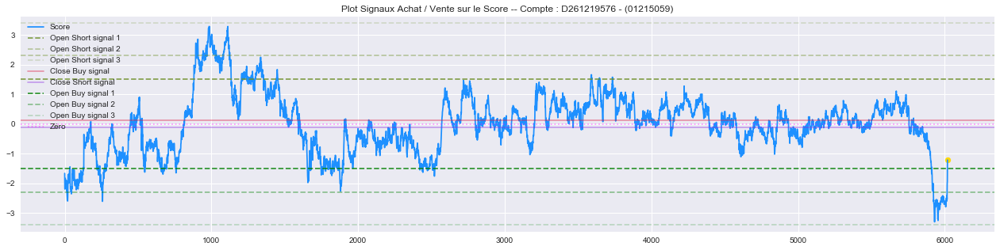

Dynamic NET PNL ( LONG 1 ):  94.56 € --- 1.0 couches 
Heure Locale : 2020-05-28 17:48:10 
Entrée dans la boucle...

Dynamic  PNL ( LONG 1 ): 88.92 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 92.83 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 94.17 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 93.55 € --- 1.0 couches 
Heure Locale : 2020-05-28 17:50:35  (Le timer est à :  50 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILLES DES POSITIONS (coef x mise en kilo devise):
Pour rappel les coef sont à  [1.88766109 0.145292   0.82648598 0.57021808]
les tickers sont ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
la constante est cste -0.253390857276665
et la mise : 111556.21453682827
AUD/USD  :  111.55621453682826
USD/SEK  :  

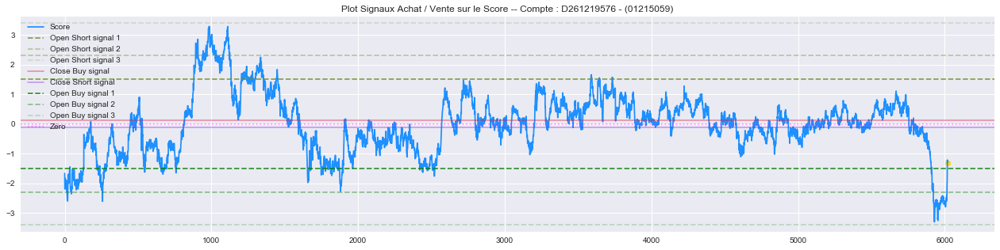



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 77.84 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 77.32 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 60.7 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 59.61 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 62.38 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 69.58 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 66.51 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 65.57 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 59.5 € --- 1.0 couches 
Heure Locale : 2020-05-28 17:55:51  (Le timer est à :  55 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILLES

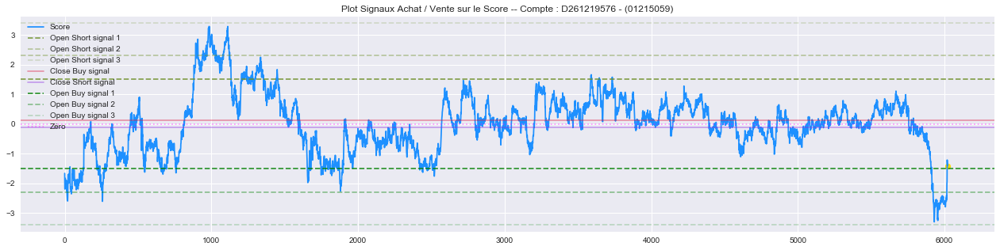



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 57.88 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 59.35 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 60.69 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 58.57 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 49.32 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 50.06 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 63.68 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 63.11 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 74.2 € --- 1.0 couches 
Heure Locale : 2020-05-28 18:00:35  (Le timer est à :  0 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILLES

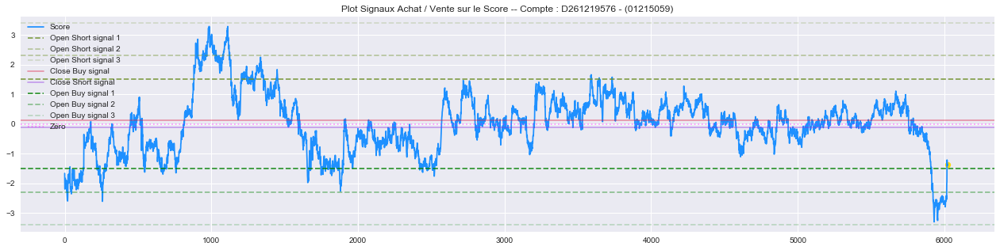



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 86.29 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 81.37 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 86.95 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 77.23 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 75.27 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 78.17 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 75.7 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 79.37 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 66.77 € --- 1.0 couches 
Heure Locale : 2020-05-28 18:05:38  (Le timer est à :  5 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILLES

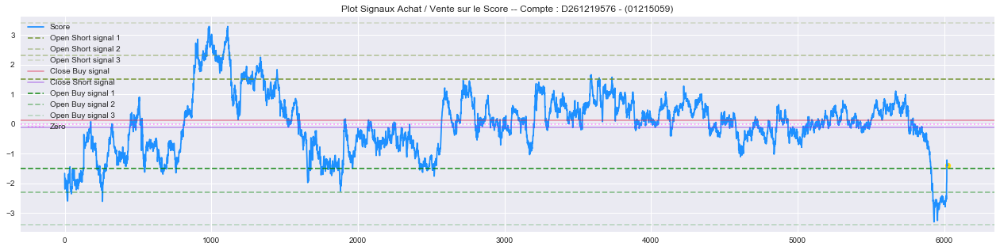



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 65.04 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 68.88 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 75.27 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 72.98 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 59.35 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 60.1 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 55.37 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 60.91 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 59.5 € --- 1.0 couches 
Heure Locale : 2020-05-28 18:10:40  (Le timer est à :  10 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILLES

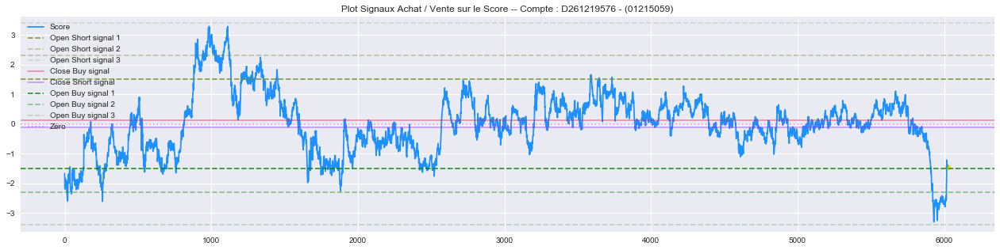



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 54.76 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 49.74 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 40.16 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 38.45 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 42.51 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 51.38 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 46.89 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 47.08 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 30.67 € --- 1.0 couches 
Heure Locale : 2020-05-28 18:15:35  (Le timer est à :  15 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILL

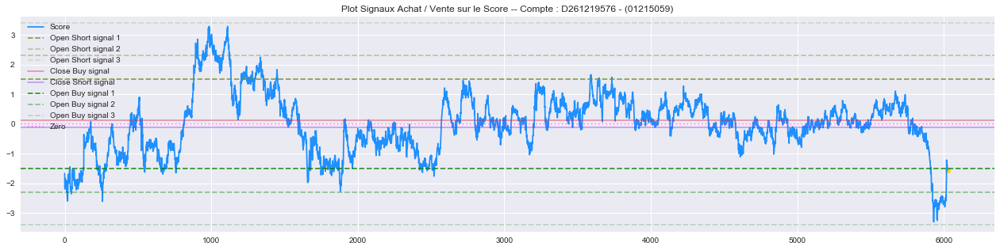



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 32.32 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 38.55 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 34.35 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 33.44 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 28.02 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 16.87 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 31.27 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 24.84 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 23.31 € --- 1.0 couches 
Heure Locale : 2020-05-28 18:20:49  (Le timer est à :  20 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILL

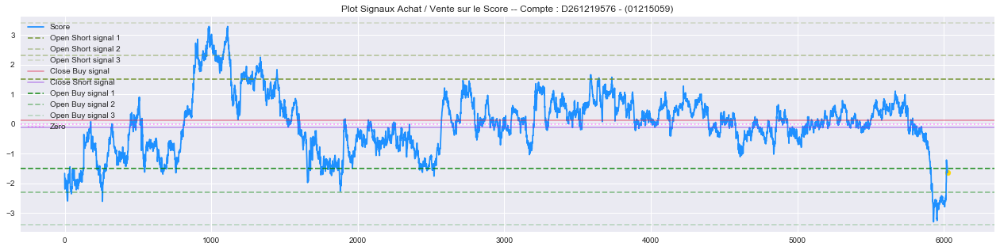



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL : Pas de positions ouvertes 
Dynamic  PNL ( LONG 1 ): 21.95 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 16.23 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 24.07 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 11.22 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 14.87 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 16.16 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 14.18 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 15.06 € --- 1.0 couches 
Heure Locale : 2020-05-28 18:25:37  (Le timer est à :  25 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILLES D

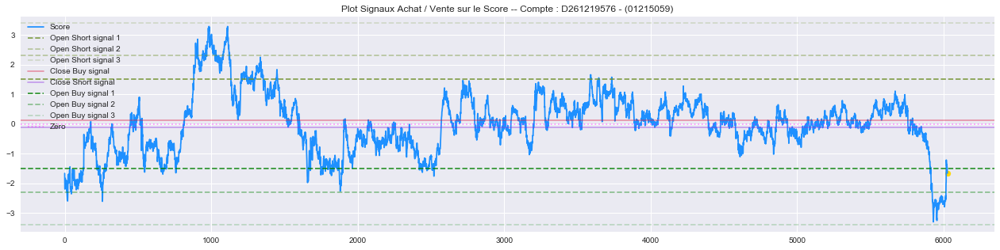



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 10.42 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 12.38 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 22.58 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 19.91 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 20.19 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 25.54 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 21.8 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 12.65 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 19.87 € --- 1.0 couches 
Heure Locale : 2020-05-28 18:30:38  (Le timer est à :  30 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILLE

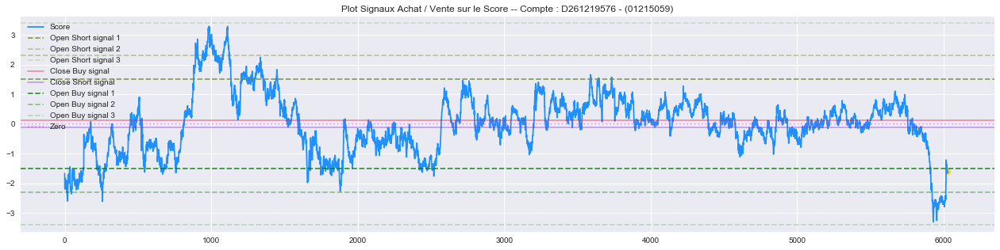



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 24.98 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 25.2 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 19.25 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 23.52 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 23.39 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 15.42 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 14.89 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 5.85 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 14.06 € --- 1.0 couches 
Heure Locale : 2020-05-28 18:35:33  (Le timer est à :  35 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILLES

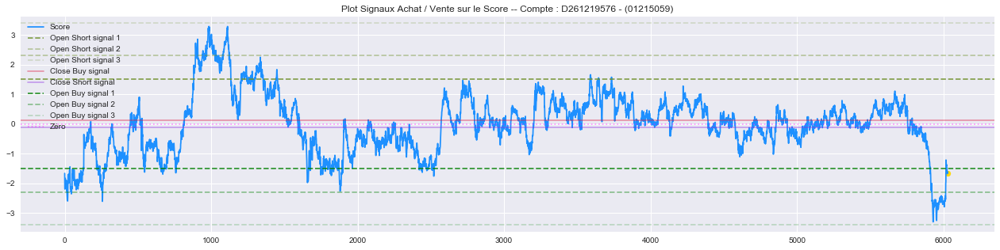



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 13.41 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 16.24 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 5.48 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 5.41 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -11.12 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -29.42 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -14.63 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -11.85 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -21.09 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -15.94 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -15.79 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -18.75 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -15.11 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -11.02 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 2.0 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -8.18 € --- 1.0 couches 
Dynamic  PNL ( LO

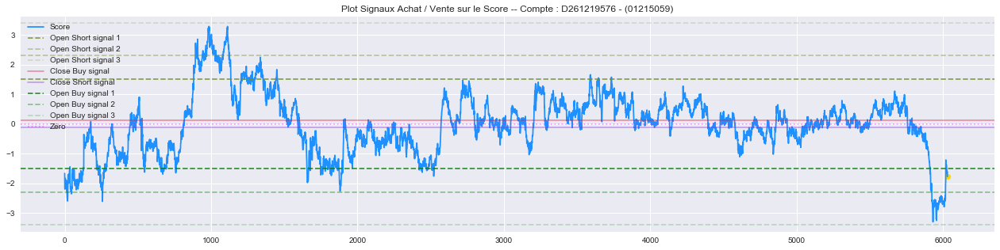



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -5.89 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -2.54 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -13.61 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -12.09 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -3.41 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -2.72 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 2.75 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 12.54 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 16.79 € --- 1.0 couches 
Heure Locale : 2020-05-28 18:50:29  (Le timer est à :  50 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16




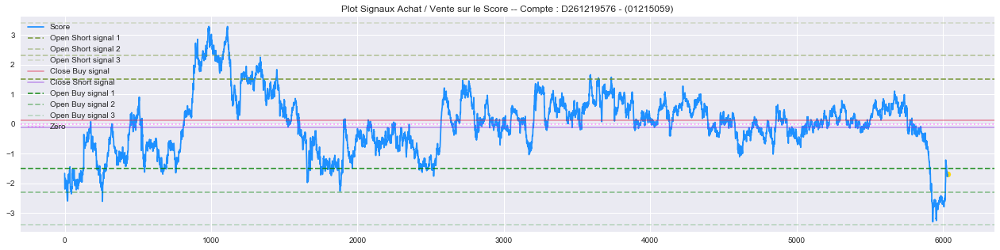



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 8.81 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 1.23 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 7.08 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 15.05 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 12.15 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 14.33 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 17.41 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 1.36 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -4.15 € --- 1.0 couches 
Heure Locale : 2020-05-28 18:55:31  (Le timer est à :  55 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILLES D

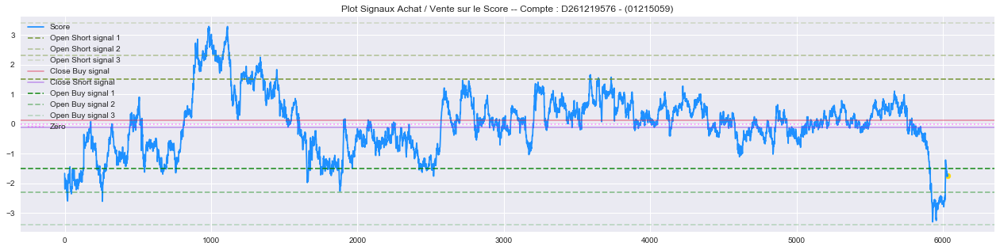



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 0.37 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 0.23 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -2.21 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -4.36 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 0.31 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -0.64 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -6.2 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 7.12 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 17.1 € --- 1.0 couches 
Heure Locale : 2020-05-28 19:00:43  (Le timer est à :  0 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILLES DES 

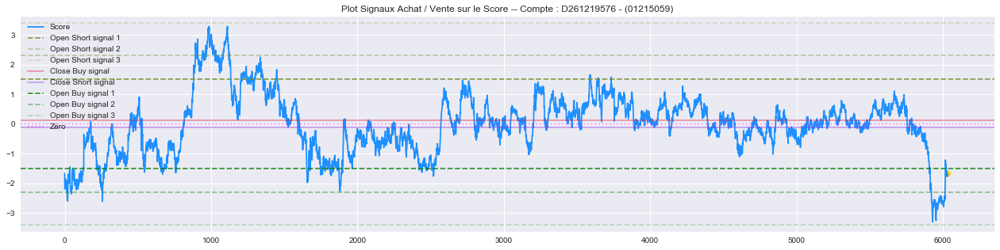



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 5.23 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 1.17 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -5.73 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -1.55 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -5.64 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -14.87 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -16.08 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -14.5 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -14.73 € --- 1.0 couches 
Heure Locale : 2020-05-28 19:05:31  (Le timer est à :  5 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILL

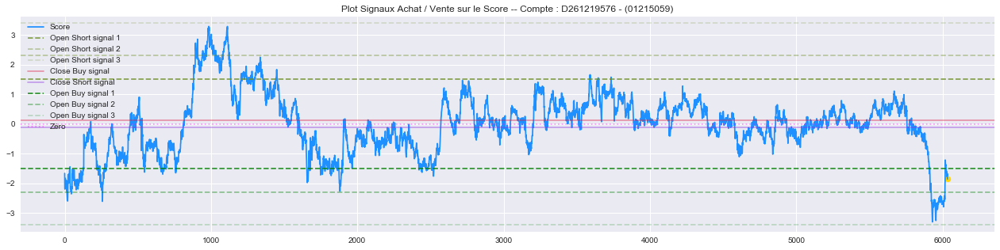



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -19.76 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -19.08 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -18.93 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -20.08 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -28.91 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -23.24 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -26.03 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -29.21 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -21.45 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -10.46 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -11.47 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -1.34 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 7.17 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 1.31 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 2.23 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 6.47 € --- 1.0 couches 
Dynamic  PNL

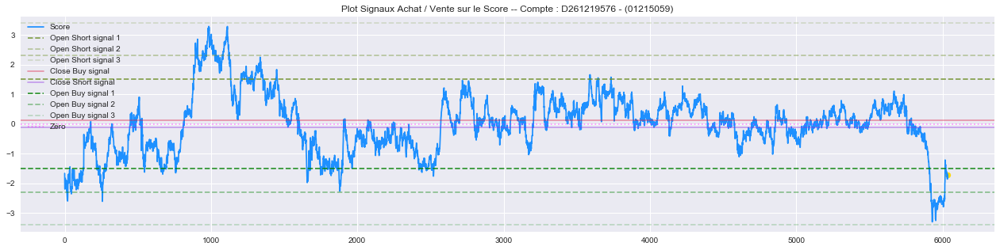



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 5.31 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 3.61 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 11.44 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 1.31 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -3.63 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -0.14 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -2.91 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 2.74 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 9.45 € --- 1.0 couches 
Heure Locale : 2020-05-28 19:20:38  (Le timer est à :  20 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILLES DE

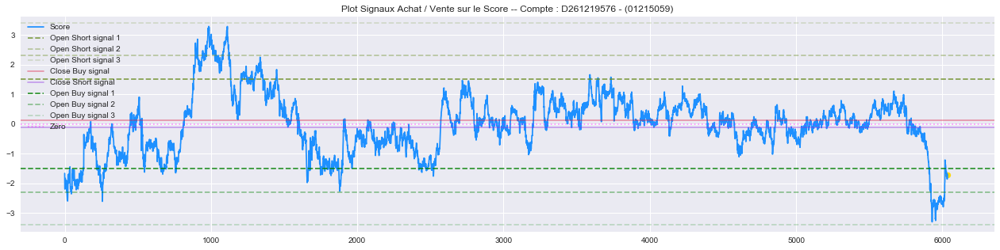



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 6.65 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 2.55 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 3.15 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 11.23 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 9.91 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 12.88 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 19.17 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 31.5 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 27.69 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 31.8 € --- 1.0 couches 
Heure Locale : 2020-05-28 19:25:56  (Le timer est à :  25 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
R

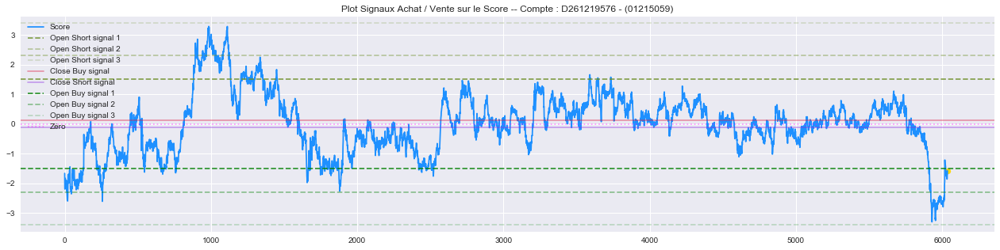



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 29.36 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 23.89 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 25.95 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 30.89 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 33.75 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 25.0 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 24.17 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 15.94 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 18.06 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 22.98 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 26.8 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 18.08 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 19.91 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 11.97 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 10.85 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 16.41 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 

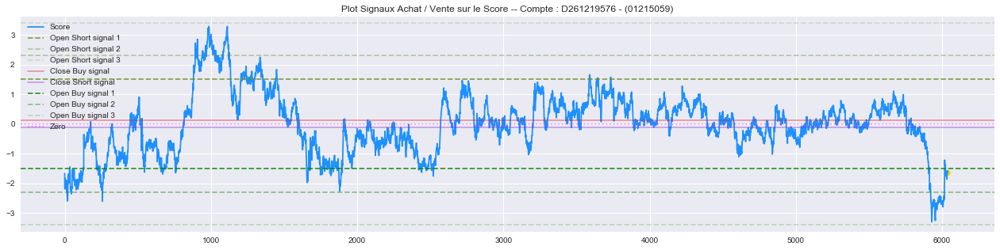



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 22.96 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 26.67 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 27.14 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 33.78 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 34.31 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 27.17 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 26.9 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 27.99 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 24.17 € --- 1.0 couches 
Heure Locale : 2020-05-28 19:40:33  (Le timer est à :  40 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILLE

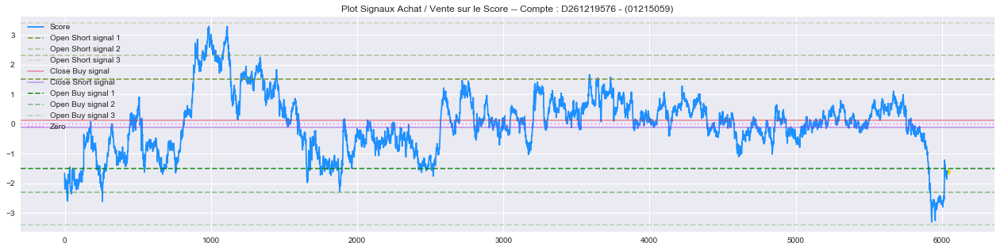



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 26.65 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 38.18 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 32.06 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 30.48 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 31.05 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 30.37 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 31.58 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 33.37 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 33.43 € --- 1.0 couches 
Heure Locale : 2020-05-28 19:45:34  (Le timer est à :  45 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILL

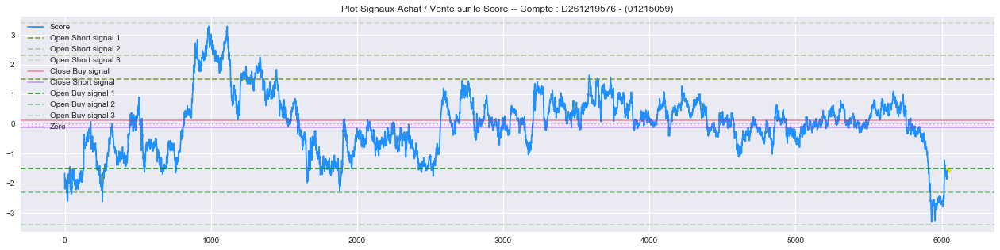



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 33.67 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 38.78 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 39.11 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 40.24 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 50.18 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 43.7 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 38.37 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 40.43 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 41.6 € --- 1.0 couches 
Heure Locale : 2020-05-28 19:50:30  (Le timer est à :  50 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILLES

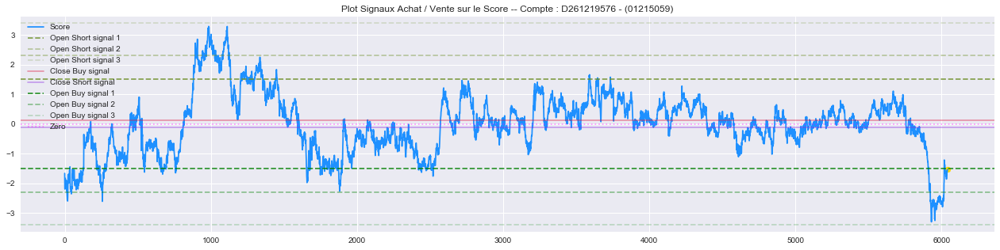



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 36.89 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 31.48 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 33.69 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 35.67 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 39.75 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 41.96 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 37.81 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 37.13 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 31.19 € --- 1.0 couches 
Heure Locale : 2020-05-28 19:55:34  (Le timer est à :  55 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e-16


TAILL

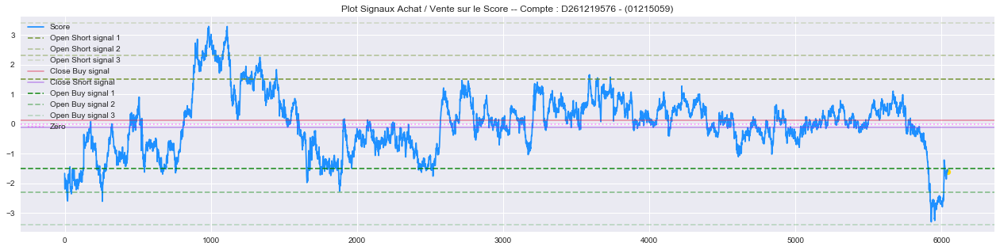



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 24.12 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 16.6 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 20.0 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 23.13 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 20.29 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 20.13 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 25.22 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 21.36 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 24.58 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 23.75 € --- 1.0 couches 
Heure Locale : 2020-05-28 20:00:58  (Le timer est à :  0 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.001829901406029138

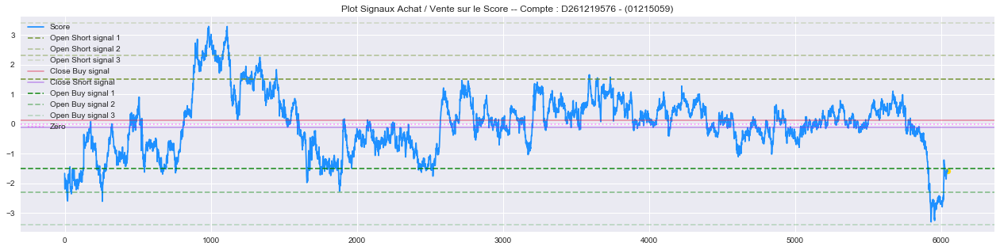



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 24.62 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 24.49 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 30.16 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 24.45 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 25.34 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 24.56 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 31.9 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 28.47 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 29.62 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 38.59 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 33.83 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 30.36 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 31.71 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 33.83 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 36.45 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 42.05 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ):

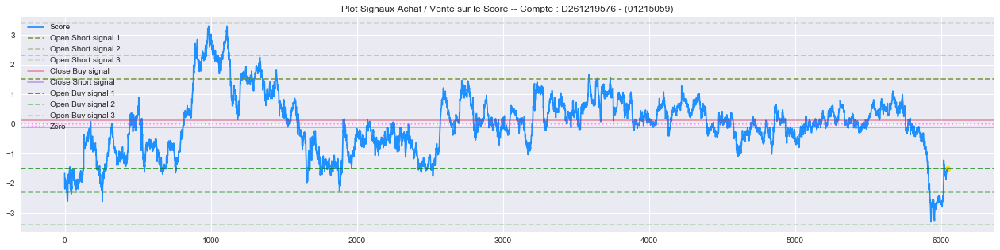



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 44.72 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 43.64 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 46.24 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 40.56 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 43.48 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 41.07 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 31.51 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 34.97 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 34.7 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 36.49 € --- 1.0 couches 
Heure Locale : 2020-05-28 20:15:52  (Le timer est à :  15 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291

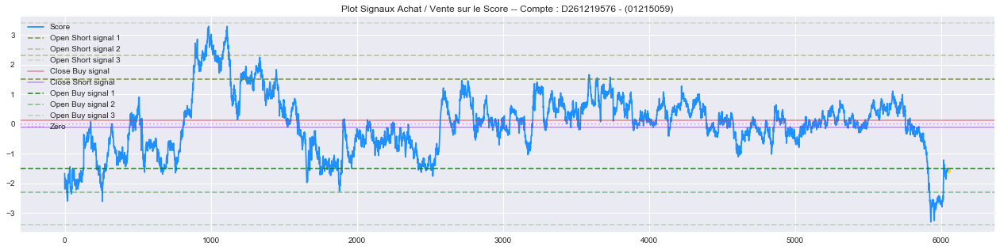



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 33.34 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 31.73 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 33.02 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 25.13 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 30.0 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 28.03 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 28.39 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 27.7 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 25.64 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 20.06 € --- 1.0 couches 
Heure Locale : 2020-05-28 20:20:50  (Le timer est à :  20 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00182990140602913

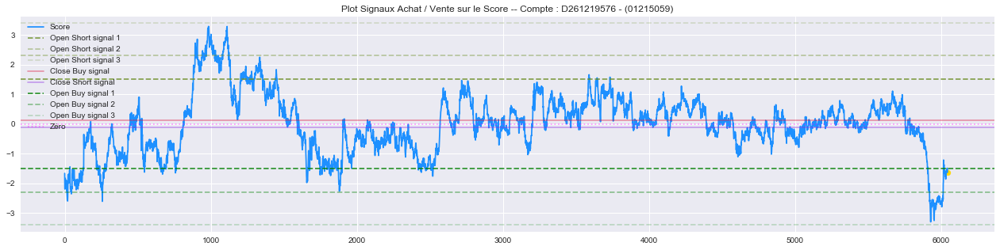



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 17.85 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 18.97 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 22.68 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 26.35 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 21.79 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 21.31 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 13.02 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 9.63 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 12.03 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 11.38 € --- 1.0 couches 
Heure Locale : 2020-05-28 20:25:51  (Le timer est à :  25 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291

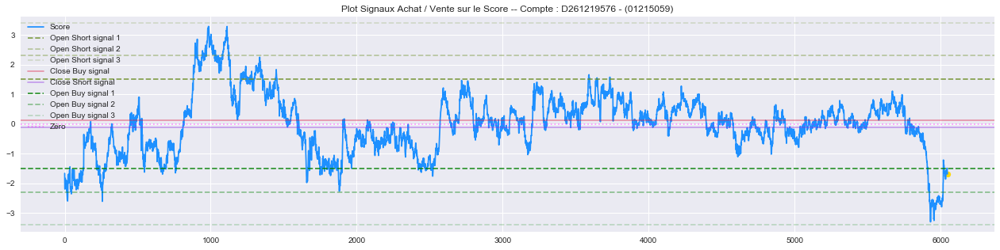



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 7.72 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 6.73 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 11.09 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 8.44 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 12.47 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 13.39 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 7.9 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 14.05 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 13.41 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 15.15 € --- 1.0 couches 
Heure Locale : 2020-05-28 20:30:50  (Le timer est à :  30 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388


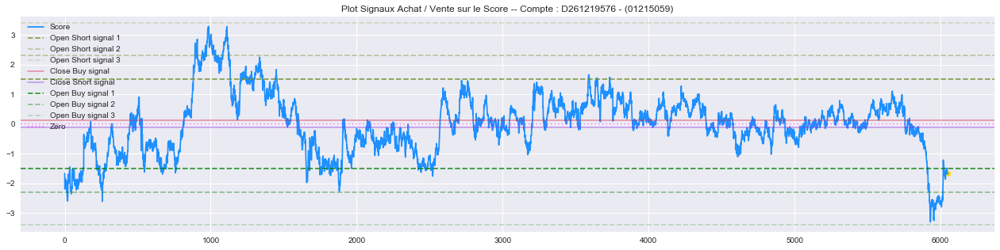



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 15.5 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 16.28 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 17.83 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 12.11 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 8.67 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 7.09 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 2.05 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -1.34 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -5.1 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -1.12 € --- 1.0 couches 
Heure Locale : 2020-05-28 20:35:53  (Le timer est à :  35 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388


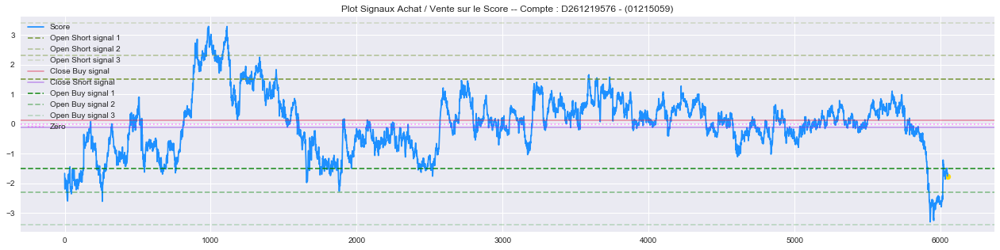



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -4.97 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -4.2 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 3.12 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 1.66 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -1.67 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -2.21 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -6.45 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -4.92 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -9.36 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -4.71 € --- 1.0 couches 
Heure Locale : 2020-05-28 20:40:55  (Le timer est à :  40 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00182990140602

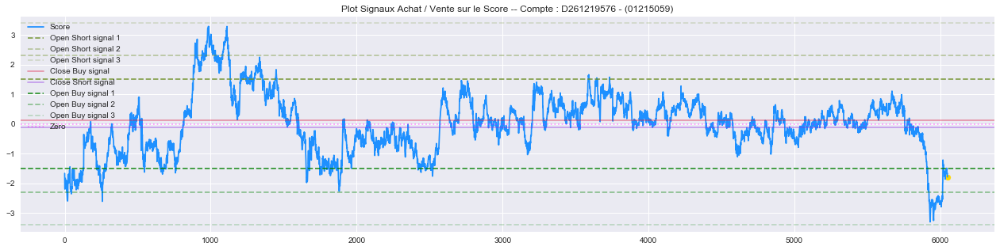



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -9.71 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -8.83 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -11.12 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -17.87 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -16.57 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -13.7 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -11.65 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -14.76 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -16.15 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -17.79 € --- 1.0 couches 
Heure Locale : 2020-05-28 20:45:51  (Le timer est à :  45 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018

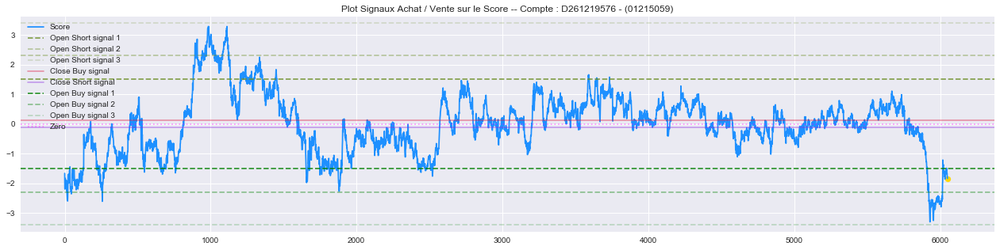



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -18.77 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -19.74 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -23.95 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -23.77 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -26.13 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -22.92 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -20.0 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -13.45 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -11.94 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -11.24 € --- 1.0 couches 
Heure Locale : 2020-05-28 20:50:49  (Le timer est à :  50 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00

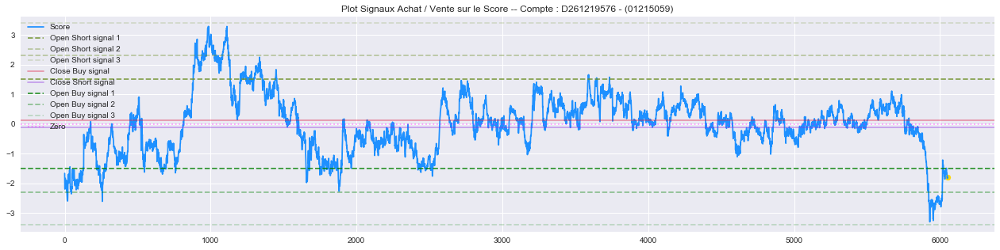



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -10.63 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -9.56 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -11.94 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -11.44 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -9.66 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 1.62 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 10.77 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 6.79 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 6.83 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 9.06 € --- 1.0 couches 
Heure Locale : 2020-05-28 20:55:49  (Le timer est à :  55 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.001829901406

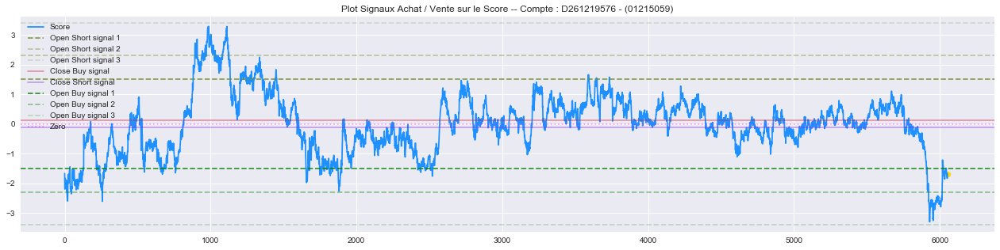



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 1 ): 6.75 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 7.79 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -1.78 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 5.28 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 6.39 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 8.63 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 6.72 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 0.14 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -0.41 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -5.54 € --- 1.0 couches 
Heure Locale : 2020-05-28 21:00:50  (Le timer est à :  0 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rap

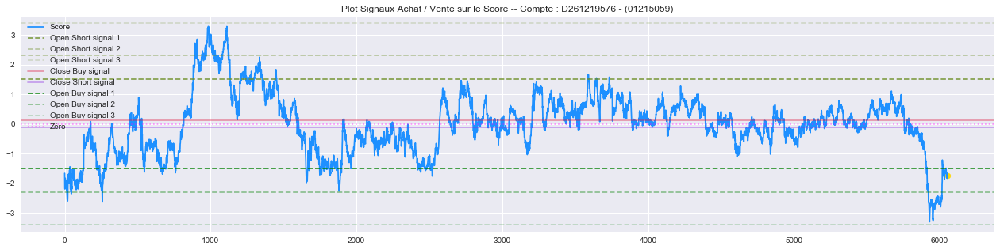



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -3.12 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -6.17 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -6.29 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -5.98 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -11.95 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -8.34 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -5.37 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -8.22 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -10.89 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -11.95 € --- 1.0 couches 
Heure Locale : 2020-05-28 21:05:50  (Le timer est à :  5 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.001829901

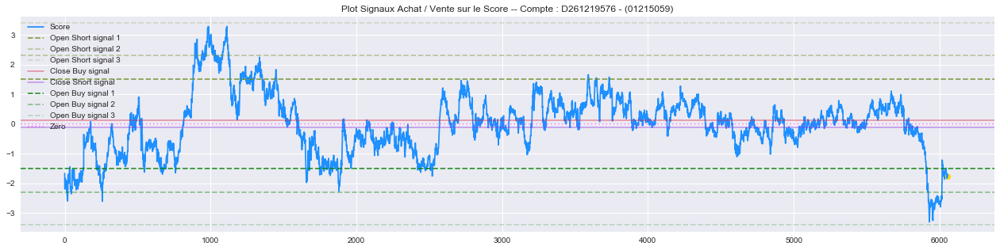



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -5.31 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -1.49 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 9.61 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 1.87 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 5.53 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -6.82 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 0.69 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 9.58 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 0.26 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -3.85 € --- 1.0 couches 
Heure Locale : 2020-05-28 21:10:53  (Le timer est à :  10 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00182990140602913

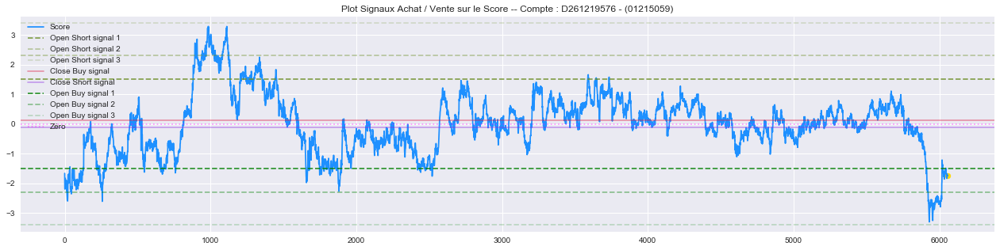



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -1.35 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -1.28 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -0.78 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -5.37 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -3.29 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): 2.1 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -3.5 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -7.16 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -7.06 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -11.41 € --- 1.0 couches 
Heure Locale : 2020-05-28 21:15:56  (Le timer est à :  15 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060

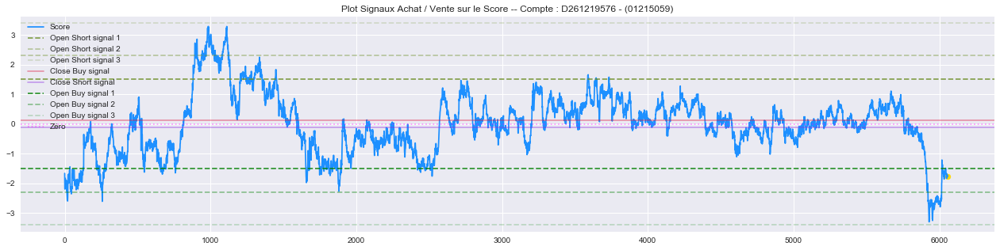



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -8.78 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -8.35 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -8.25 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -8.7 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -17.48 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -24.5 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -33.04 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -18.41 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -24.98 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -30.03 € --- 1.0 couches 
Heure Locale : 2020-05-28 21:20:49  (Le timer est à :  20 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299

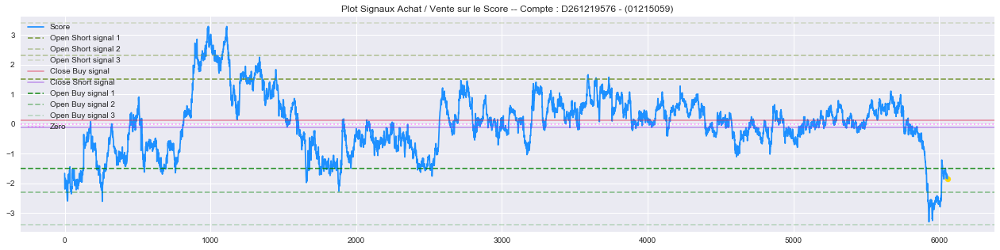



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -18.3 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -19.83 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -19.74 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -19.37 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -37.58 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -32.03 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -26.24 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -37.15 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -41.77 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -40.29 € --- 1.0 couches 
Heure Locale : 2020-05-28 21:25:53  (Le timer est à :  25 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00

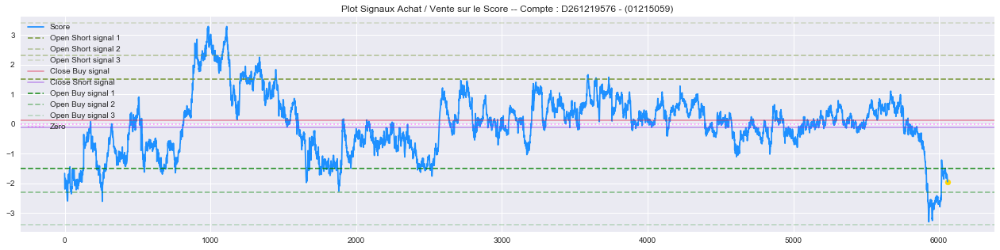



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -40.22 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -43.6 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -44.62 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -38.47 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -32.21 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -41.32 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -49.25 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -48.17 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -51.69 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -54.66 € --- 1.0 couches 
Heure Locale : 2020-05-28 21:30:47  (Le timer est à :  30 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00

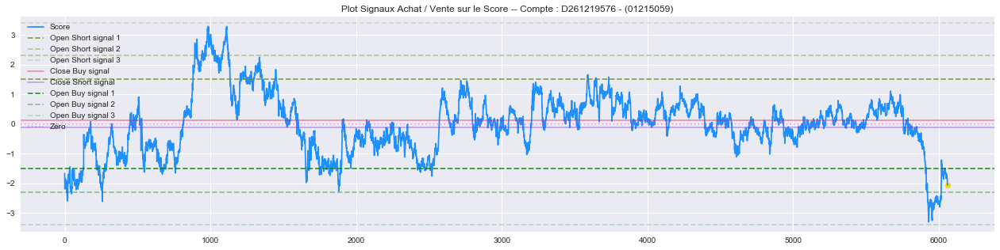



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -60.7 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -60.14 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -59.44 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -56.91 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -68.15 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -64.01 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -75.16 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -60.99 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -66.21 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -63.36 € --- 1.0 couches 
Heure Locale : 2020-05-28 21:35:52  (Le timer est à :  35 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00

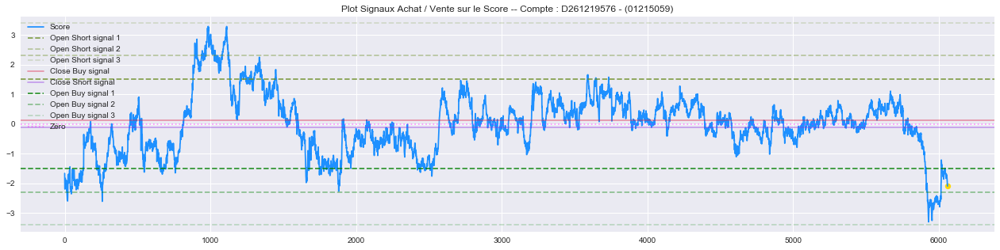



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -69.6 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -78.45 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -67.17 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -59.4 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -55.95 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -75.45 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -72.15 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -69.86 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -69.06 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -80.57 € --- 1.0 couches 
Heure Locale : 2020-05-28 21:40:46  (Le timer est à :  40 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.001

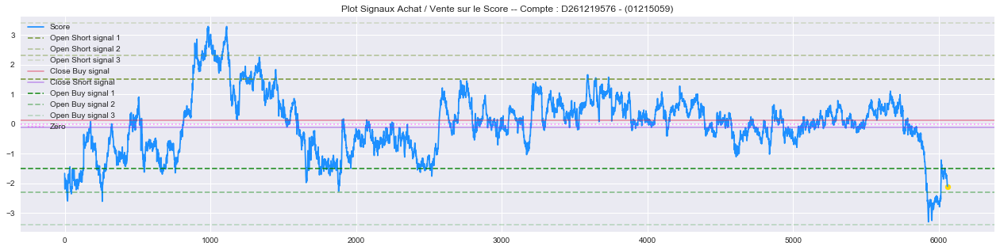



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -69.26 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -76.07 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -77.92 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -78.77 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -85.05 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -76.27 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -95.57 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -97.35 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -96.48 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -93.58 € --- 1.0 couches 
Heure Locale : 2020-05-28 21:45:48  (Le timer est à :  45 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0

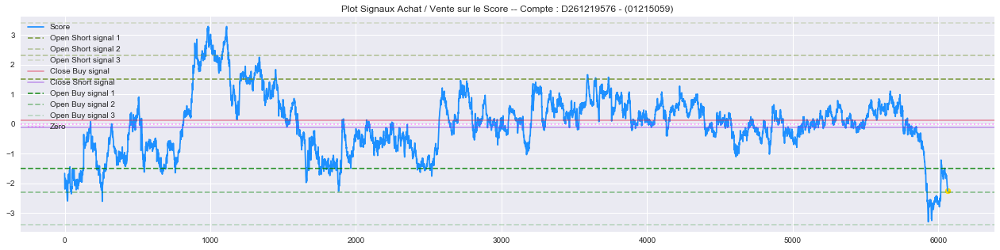



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -98.37 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -97.98 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -98.65 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -100.57 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -106.05 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -100.9 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -109.93 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -101.58 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -87.8 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -89.77 € --- 1.0 couches 
Heure Locale : 2020-05-28 21:50:49  (Le timer est à :  50 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 

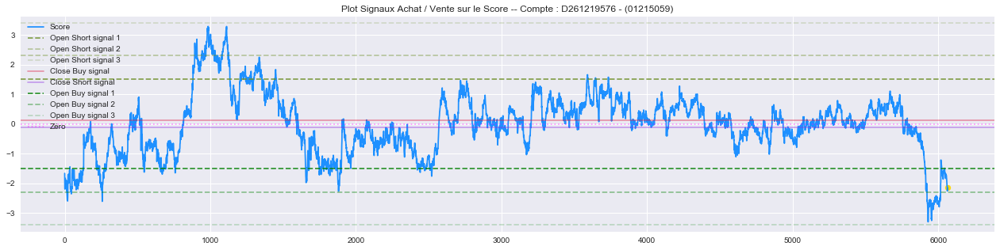



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -76.64 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -73.61 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -71.09 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -72.38 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -83.95 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -73.79 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -87.2 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -91.85 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -87.0 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -82.06 € --- 1.0 couches 
Heure Locale : 2020-05-28 21:55:48  (Le timer est à :  55 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.001

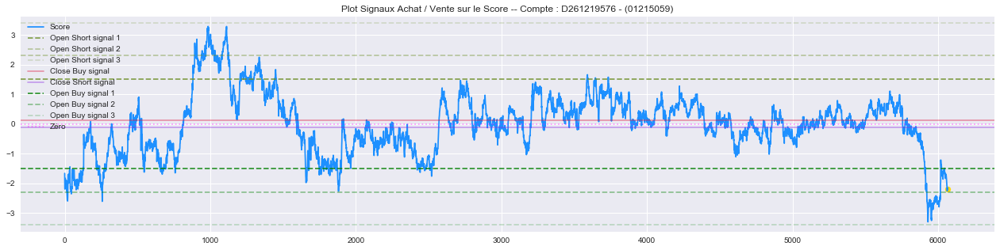



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -86.84 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -93.39 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -93.83 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -102.6 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -94.37 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -109.07 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -110.45 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -113.42 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -117.03 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -103.69 € --- 1.0 couches 
Heure Locale : 2020-05-28 22:00:48  (Le timer est à :  0 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std

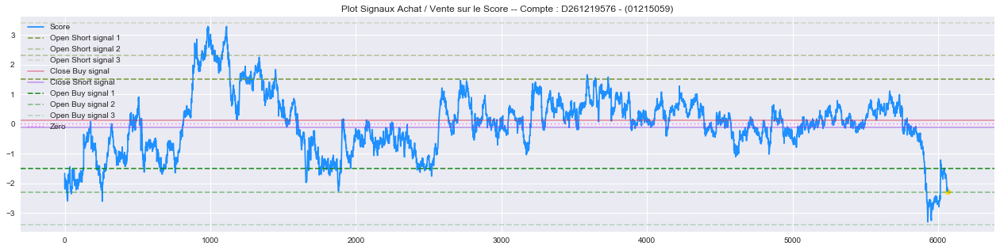



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -104.08 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -95.39 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -99.47 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -89.3 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -85.43 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -86.57 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -90.06 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -91.58 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -87.2 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -74.37 € --- 1.0 couches 
Heure Locale : 2020-05-28 22:05:47  (Le timer est à :  5 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.001

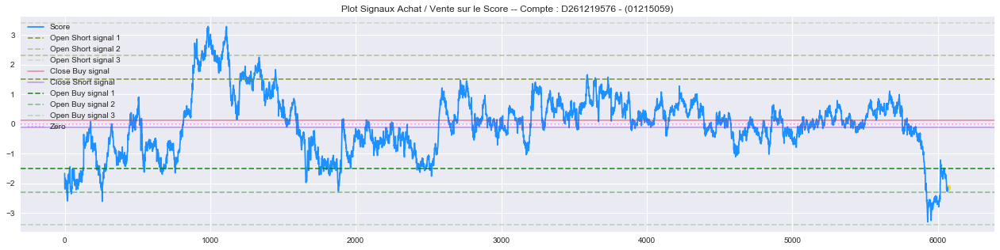



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -75.86 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -78.62 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -78.34 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -77.22 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -69.42 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -74.16 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -70.85 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -71.4 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -73.59 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -72.44 € --- 1.0 couches 
Heure Locale : 2020-05-28 22:10:46  (Le timer est à :  10 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00

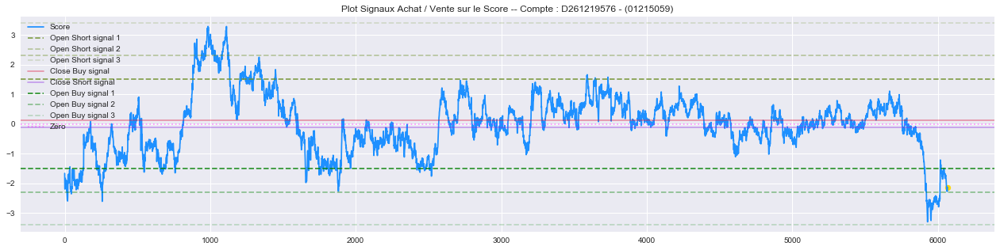



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -76.89 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -76.18 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -70.72 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -69.25 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -66.06 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -61.97 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -61.28 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -56.33 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -61.06 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -63.35 € --- 1.0 couches 
Heure Locale : 2020-05-28 22:15:45  (Le timer est à :  15 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0

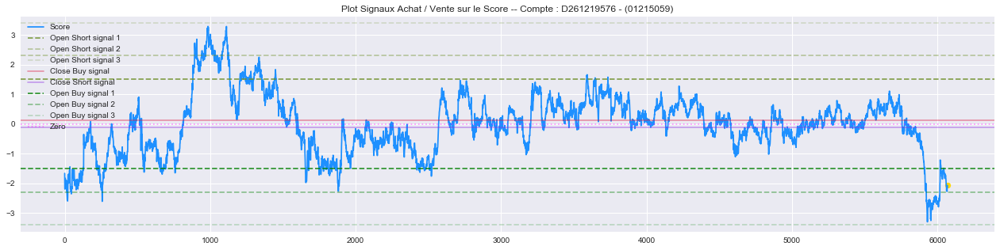



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -65.46 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -69.89 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -58.35 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -60.35 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -58.83 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -57.65 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -55.74 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -64.55 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -63.4 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -65.43 € --- 1.0 couches 
Heure Locale : 2020-05-28 22:20:44  (Le timer est à :  20 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00

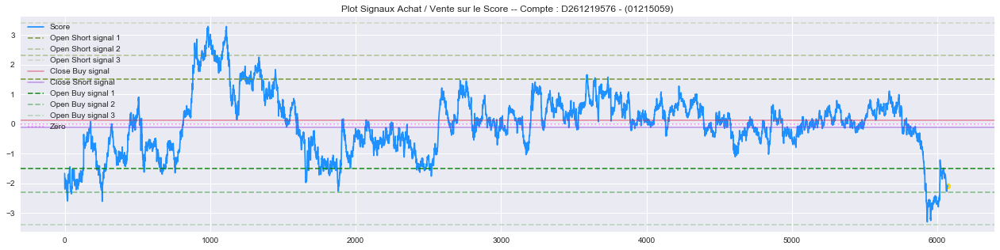



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -69.08 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -74.0 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -74.12 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -67.64 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -74.67 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -73.44 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -62.95 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -67.94 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -72.62 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -71.83 € --- 1.0 couches 
Heure Locale : 2020-05-28 22:25:46  (Le timer est à :  25 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00

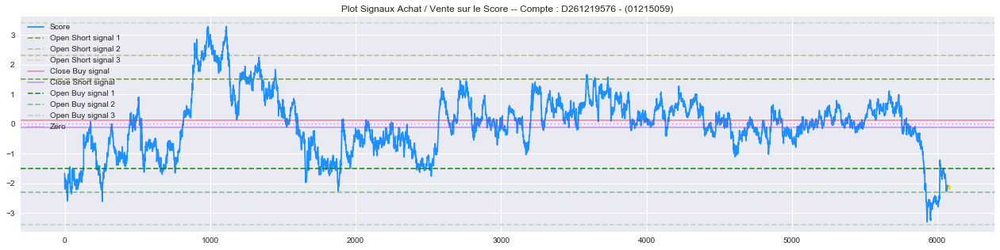



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -74.46 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -76.75 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -77.66 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -77.7 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -79.58 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -78.58 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -78.96 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -76.82 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -66.22 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -93.11 € --- 1.0 couches 
Heure Locale : 2020-05-28 22:30:48  (Le timer est à :  30 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00

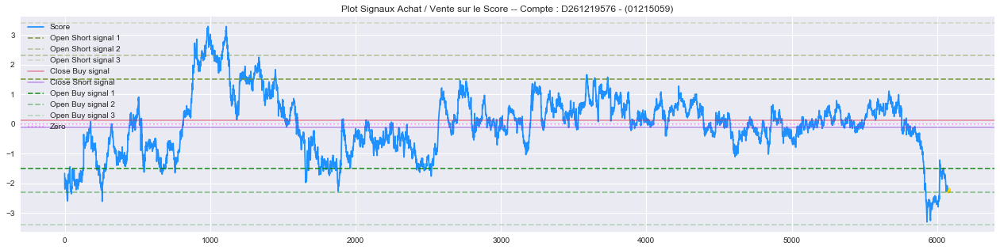



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -90.49 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -90.34 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -93.63 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -93.78 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -91.26 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -90.9 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -91.54 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -93.31 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -93.53 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -101.34 € --- 1.0 couches 
Heure Locale : 2020-05-28 22:35:45  (Le timer est à :  35 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0

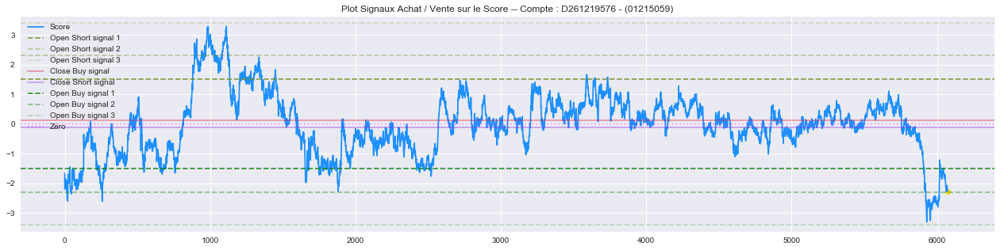



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 1 ): -103.87 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -102.09 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -105.0 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -106.79 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -113.89 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -120.89 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -115.29 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -112.63 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -115.73 € --- 1.0 couches 
Dynamic  PNL ( LONG 1 ): -117.78 € --- 1.0 couches 
Heure Locale : 2020-05-28 22:40:46  (Le timer est à :  40 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel d

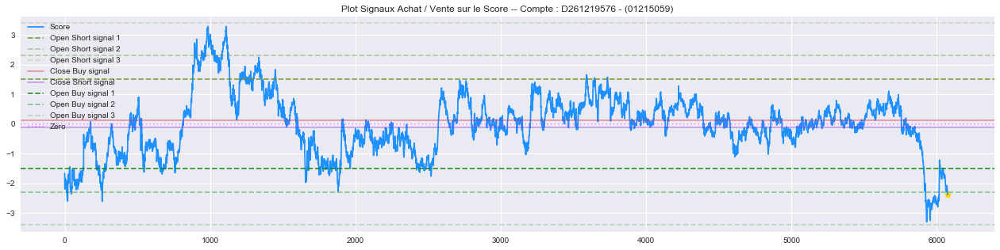



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

Sauvegarde du ficher Log

Heure locale du trade : 2020-05-28 22:40:48
 ACTION OPEN LONG  Niveau 2 


TAILLES DES POSITIONS (coef x mise en devise):
AUD/USD  :  111.55621453682826
USD/SEK  :  22.145684593196975
NZD/USD  :  16.20822542442885
USD/CAD  :  66.9714880241908
USD/ZAR  :  3.631428508876574



Taille pour AUD/USD  :  111.55621453682826
Taille pour USD/SEK  :  22.1457
Taille pour NZD/USD  :  16.2082
Taille pour USD/CAD  :  66.9715
Taille pour USD/ZAR  :  3.6314
                     0
t                    1
ratePrecision        0
tradeId               
accountName           
accountId             
roll                 0
com                  0
open                 0
valueDate             
grossPL       -160.436
close                0
visiblePL        671.4
isDisabled       False
currency              
isBuy            False
amountK            437
currencyPoint        0
time              None
usedMargin  

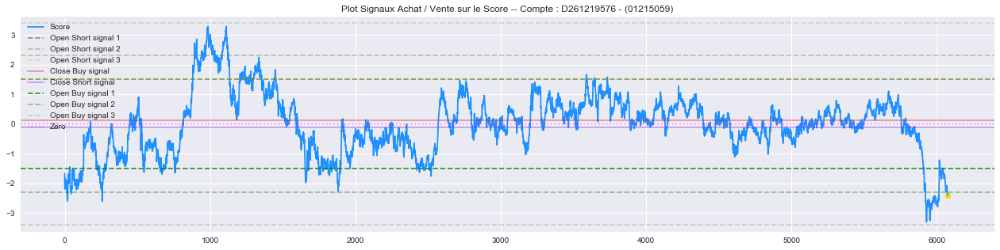



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -166.72 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -175.24 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -167.38 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -172.02 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -145.02 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -150.1 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -154.85 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -164.0 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -176.63 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -182.42 € --- 2.0 couches 
Heure Locale : 2020-05-28 22:50:42  (Le timer est à :  50 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du

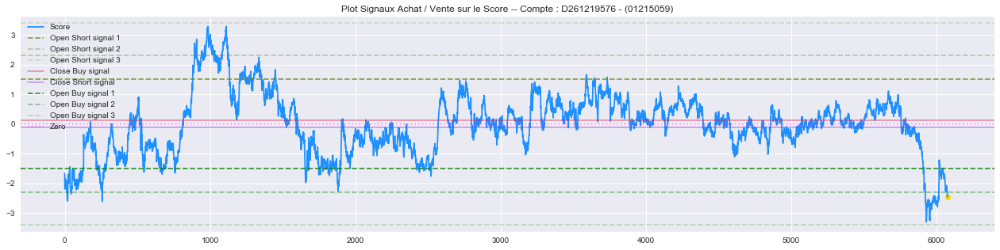



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -193.48 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -189.59 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -192.71 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -210.88 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -207.07 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -215.97 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -212.13 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -211.19 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -208.4 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -207.61 € --- 2.0 couches 
Heure Locale : 2020-05-28 22:55:42  (Le timer est à :  55 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel d

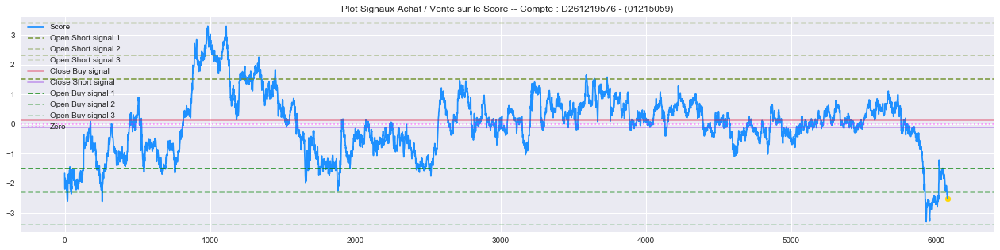



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -218.1 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -213.81 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -217.62 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -224.27 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -237.6 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -246.63 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -284.76 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -235.51 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -225.29 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -367.58 € --- 2.0 couches 
Heure Locale : 2020-05-28 23:00:44  (Le timer est à :  0 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du 

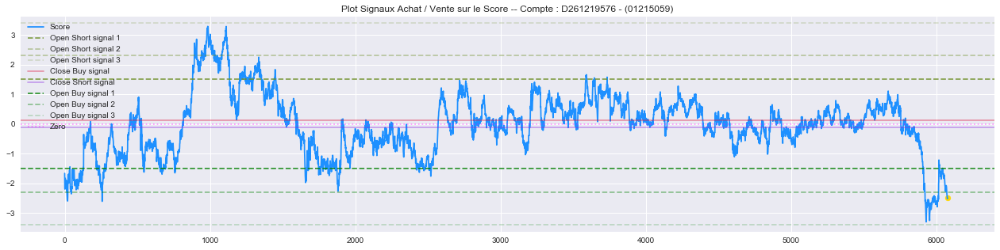



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -314.4 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -317.91 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -307.44 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -305.49 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -305.49 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -307.5 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -302.27 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -302.27 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -297.03 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -281.61 € --- 2.0 couches 
Heure Locale : 2020-05-28 23:05:43  (Le timer est à :  5 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du 

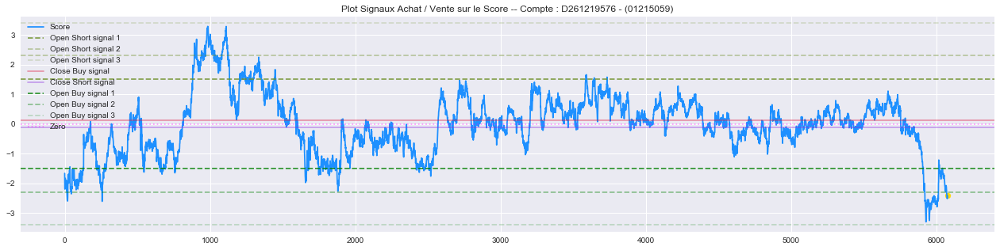



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -281.6 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -282.47 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -301.59 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -297.76 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -303.14 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -290.11 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -262.99 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -263.25 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -226.87 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -241.73 € --- 2.0 couches 
Heure Locale : 2020-05-28 23:10:42  (Le timer est à :  10 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel d

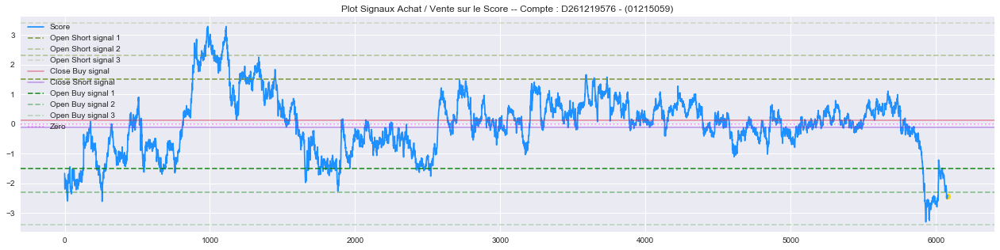



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -247.36 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -264.19 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -203.84 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -196.07 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -212.64 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -191.24 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -230.65 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -234.87 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -231.69 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -231.31 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -232.18 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -197.83 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -203.75 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -253.77 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -244.8 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -218.75 € --- 2

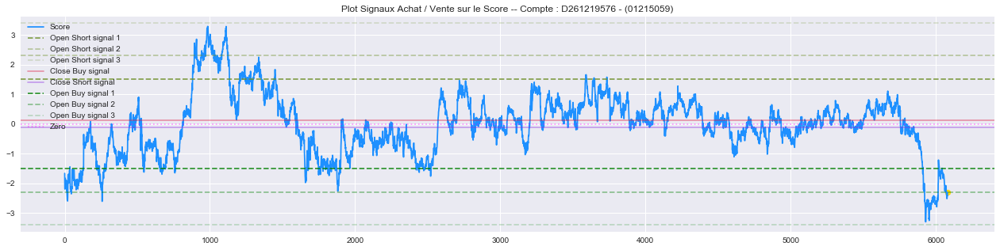



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -192.8 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -189.7 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -189.06 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -202.08 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -192.79 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -211.89 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -209.16 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -205.4 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -205.69 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -202.18 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -203.96 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -202.22 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -194.2 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -219.61 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -215.91 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -198.16 € --- 2.0 

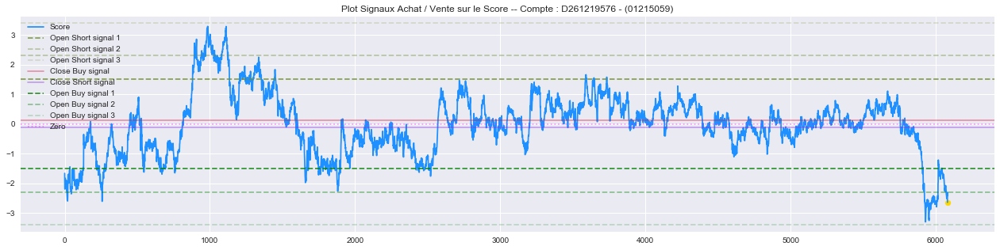



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -317.29 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -309.16 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -327.95 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -543.11 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -588.53 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -572.6 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -406.18 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -463.47 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -514.2 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -396.5 € --- 2.0 couches 
Heure Locale : 2020-05-28 23:50:42  (Le timer est à :  50 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du 

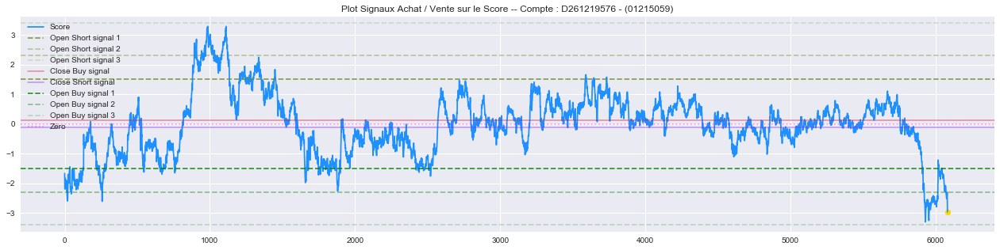



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -415.88 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -431.78 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -442.38 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -420.91 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -463.09 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -456.46 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -433.96 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -458.52 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -471.26 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -449.72 € --- 2.0 couches 
Heure Locale : 2020-05-28 23:55:43  (Le timer est à :  55 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel 

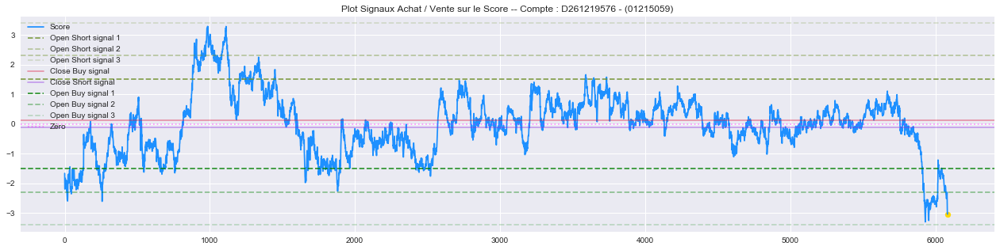



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -445.31 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -446.18 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -457.67 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -458.21 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -446.23 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -446.01 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -454.47 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -460.53 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -454.85 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -389.47 € --- 2.0 couches 
Heure Locale : 2020-05-29 00:00:43  (Le timer est à :  0 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel d

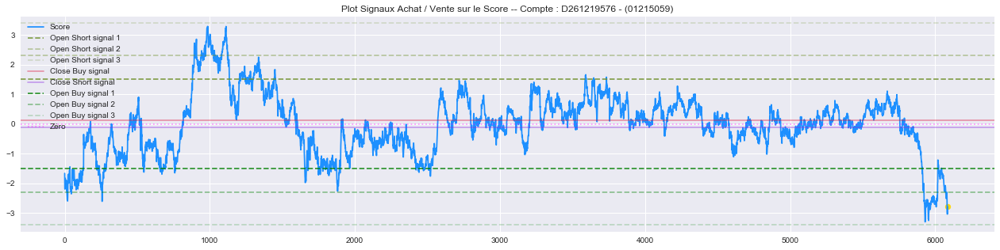



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -331.77 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -331.64 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -317.72 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -354.2 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -361.42 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -332.99 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -329.04 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -326.76 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -334.33 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -336.45 € --- 2.0 couches 
Heure Locale : 2020-05-29 00:05:43  (Le timer est à :  5 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du

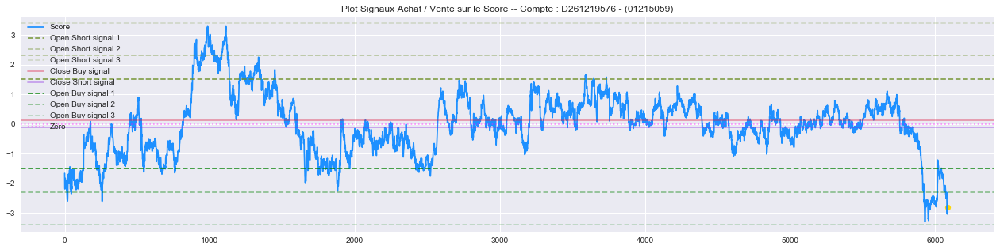



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -349.53 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -336.36 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -365.61 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -356.47 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -356.05 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -338.31 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -330.19 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -301.65 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -296.25 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -333.05 € --- 2.0 couches 
Heure Locale : 2020-05-29 00:10:43  (Le timer est à :  10 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel 

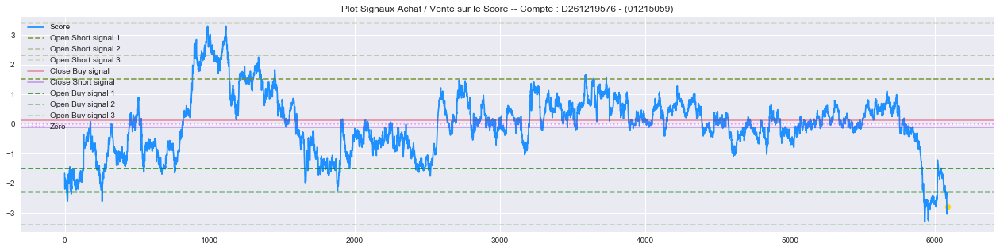



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -329.1 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -334.82 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -312.05 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -307.08 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -302.3 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -312.78 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -302.41 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -306.42 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -311.1 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -319.67 € --- 2.0 couches 
Heure Locale : 2020-05-29 00:15:44  (Le timer est à :  15 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du 

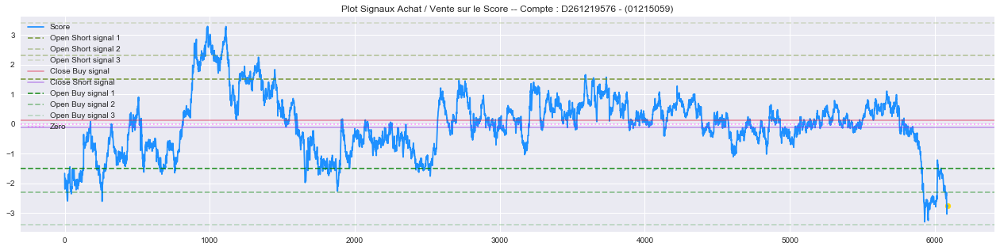



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -305.27 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -319.85 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -318.78 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -303.92 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -294.33 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -320.76 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -325.33 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -308.05 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -319.38 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -303.74 € --- 2.0 couches 
Heure Locale : 2020-05-29 00:20:43  (Le timer est à :  20 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel 

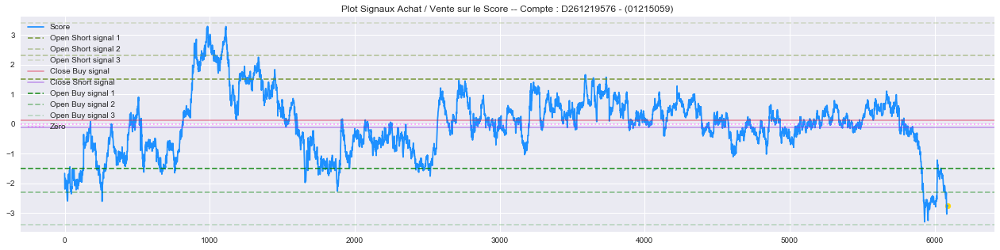



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -312.34 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -312.53 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -308.72 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -301.58 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -285.78 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -287.56 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -283.85 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -293.93 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -293.67 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -331.1 € --- 2.0 couches 
Heure Locale : 2020-05-29 00:25:44  (Le timer est à :  25 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel d

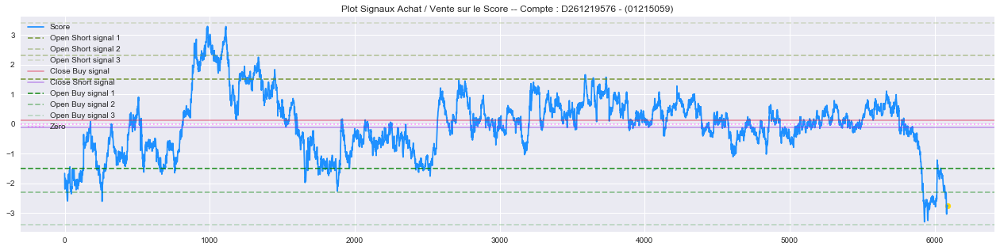



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -320.24 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -315.77 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -319.83 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -302.25 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -307.31 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -287.72 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -292.75 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -300.42 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -289.63 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -276.63 € --- 2.0 couches 
Heure Locale : 2020-05-29 00:30:44  (Le timer est à :  30 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel 

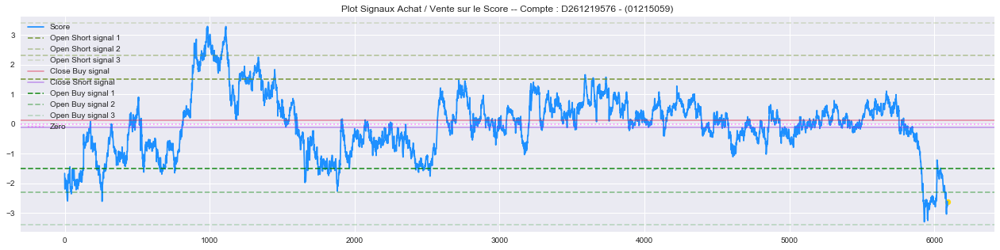



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -255.05 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -256.39 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -301.5 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -284.11 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -287.31 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -295.3 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -306.88 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -292.47 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -280.1 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -310.8 € --- 2.0 couches 
Heure Locale : 2020-05-29 00:35:44  (Le timer est à :  35 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du s

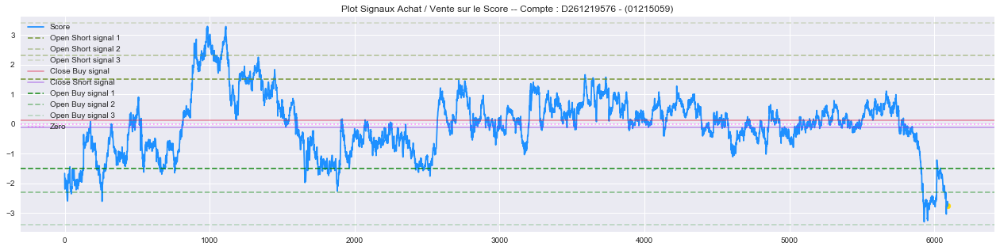



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -309.0 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -283.53 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -271.9 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -272.99 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -267.67 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -269.32 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -275.64 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -265.51 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -268.45 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -255.92 € --- 2.0 couches 
Heure Locale : 2020-05-29 00:40:46  (Le timer est à :  40 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du

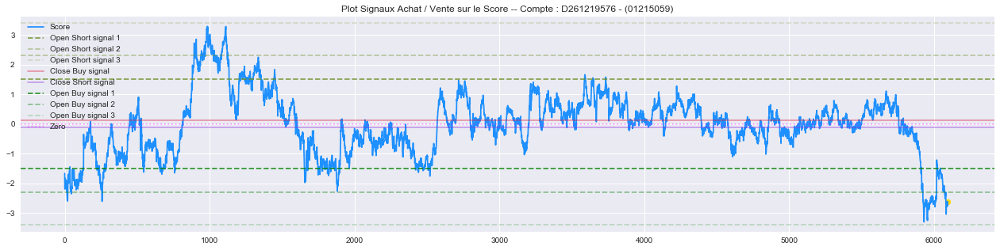



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -261.46 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -262.36 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -266.77 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -270.7 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -250.32 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -248.89 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -259.83 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -259.74 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -265.75 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -244.39 € --- 2.0 couches 
Heure Locale : 2020-05-29 00:45:47  (Le timer est à :  45 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel d

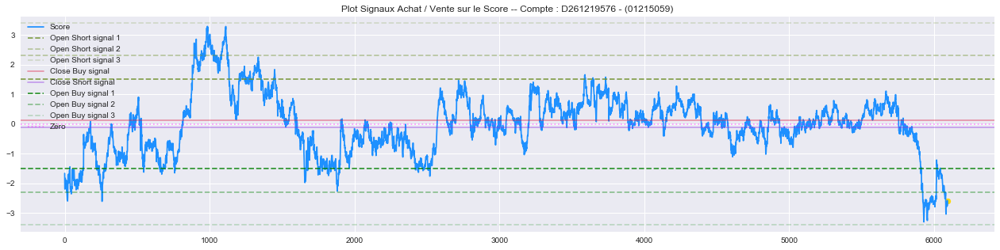



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -241.4 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -245.28 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -238.26 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -255.55 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -241.73 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -234.42 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -231.21 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -224.36 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -229.27 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -235.57 € --- 2.0 couches 
Heure Locale : 2020-05-29 00:50:48  (Le timer est à :  50 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel d

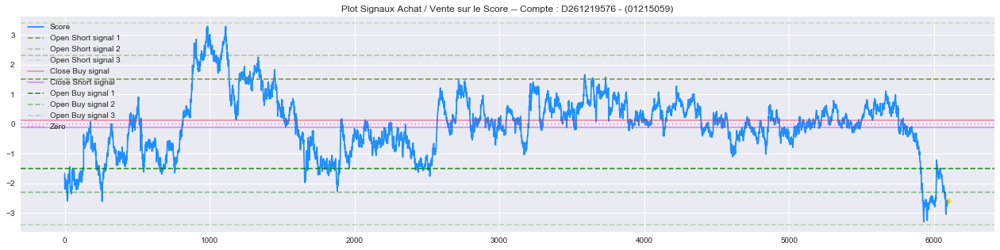



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -243.88 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -248.25 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -232.8 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -226.21 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -214.72 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -216.41 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -203.99 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -213.14 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -204.09 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -209.43 € --- 2.0 couches 
Heure Locale : 2020-05-29 00:55:51  (Le timer est à :  55 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel d

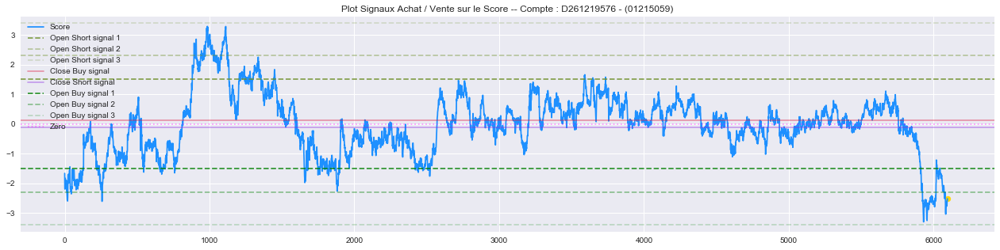



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -220.31 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -219.08 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -220.71 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -231.74 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -224.86 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -215.67 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -214.0 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -205.44 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -200.4 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -202.08 € --- 2.0 couches 
Heure Locale : 2020-05-29 01:00:51  (Le timer est à :  0 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du 

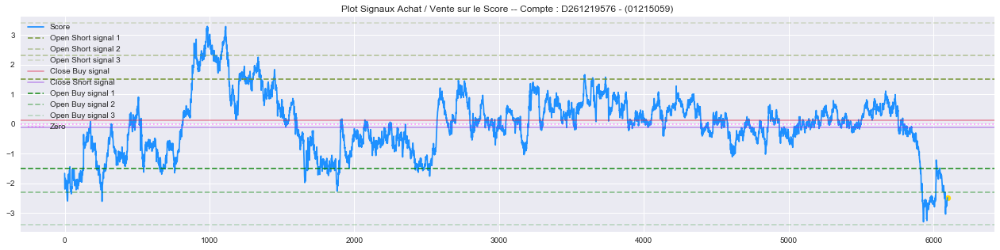



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -206.38 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -204.73 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -201.43 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -199.98 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -192.88 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -208.73 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -195.7 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -202.38 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -199.41 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -191.63 € --- 2.0 couches 
Heure Locale : 2020-05-29 01:05:51  (Le timer est à :  5 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du

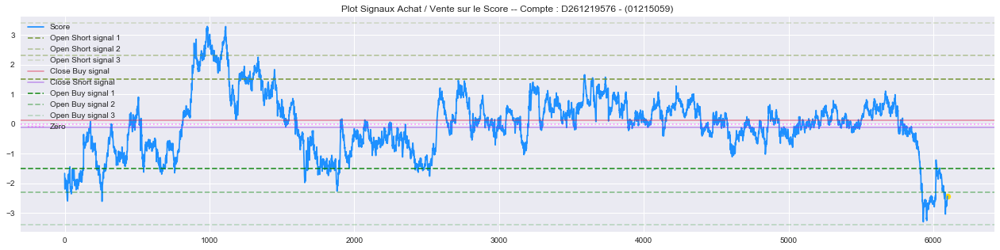



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -188.85 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -186.77 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -192.21 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -182.92 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -182.91 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -179.81 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -181.33 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -184.98 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -178.27 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -182.56 € --- 2.0 couches 
Heure Locale : 2020-05-29 01:10:48  (Le timer est à :  10 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel 

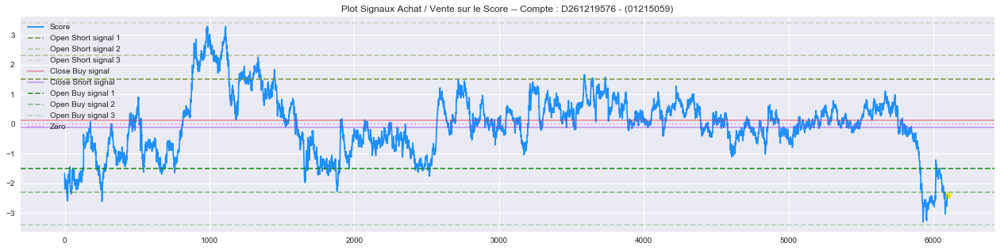



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -183.06 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -180.9 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -186.67 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -186.13 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -187.81 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -182.29 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -183.2 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -182.24 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -187.63 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -186.89 € --- 2.0 couches 
Heure Locale : 2020-05-29 01:15:52  (Le timer est à :  15 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du

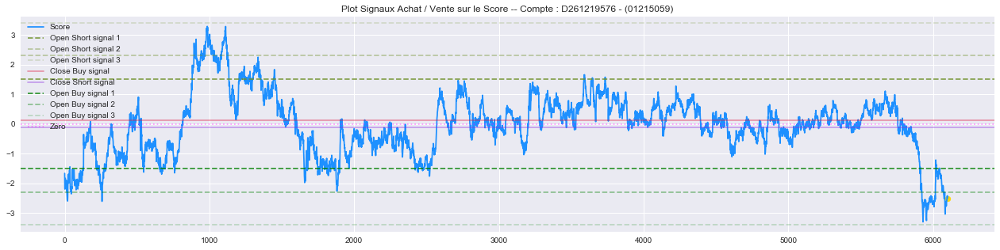



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -210.93 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -212.45 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -206.35 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -202.85 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -205.62 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -209.85 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -210.33 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -211.94 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -206.46 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -208.76 € --- 2.0 couches 
Heure Locale : 2020-05-29 01:20:53  (Le timer est à :  20 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel 

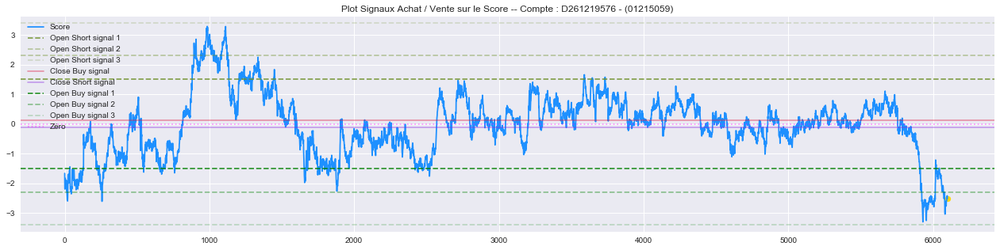



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -207.75 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -211.52 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -206.02 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -205.68 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -213.47 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -208.52 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -209.46 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -205.04 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -206.82 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -213.05 € --- 2.0 couches 
Heure Locale : 2020-05-29 01:25:48  (Le timer est à :  25 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel 

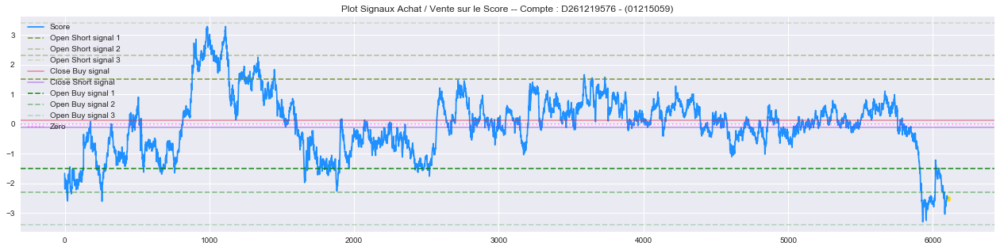



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -211.82 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -218.55 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -209.36 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -221.53 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -210.14 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -209.35 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -212.24 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -208.64 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -210.71 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -204.11 € --- 2.0 couches 
Heure Locale : 2020-05-29 01:30:50  (Le timer est à :  30 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel 

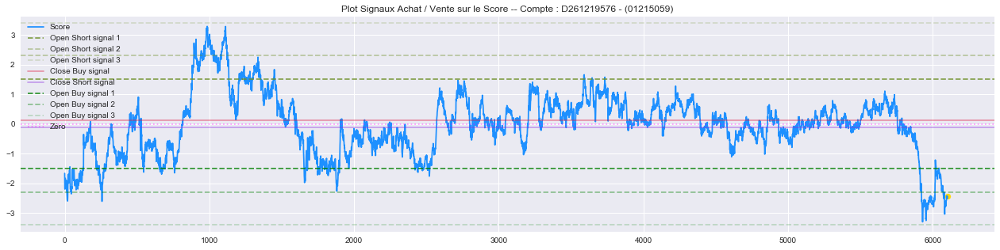



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -190.9 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -181.61 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -185.41 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -181.58 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -179.93 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -178.85 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -196.98 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -200.52 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -209.01 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -207.53 € --- 2.0 couches 
Heure Locale : 2020-05-29 01:35:48  (Le timer est à :  35 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel d

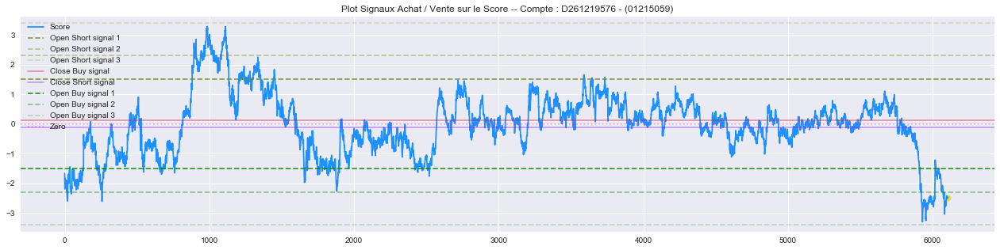



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -203.48 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -193.73 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -183.69 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -179.54 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -183.49 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -173.14 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -174.7 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -171.26 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -168.16 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -171.67 € --- 2.0 couches 
Heure Locale : 2020-05-29 01:40:49  (Le timer est à :  40 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel d

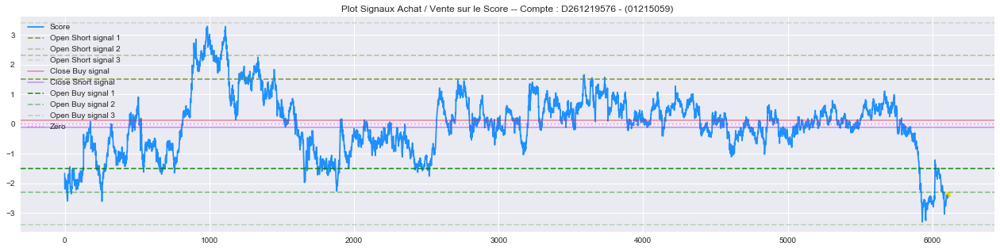



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -168.57 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -168.21 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -154.99 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -149.91 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -151.3 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -140.9 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -140.29 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -142.75 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -131.42 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -138.55 € --- 2.0 couches 
Heure Locale : 2020-05-29 01:45:49  (Le timer est à :  45 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du

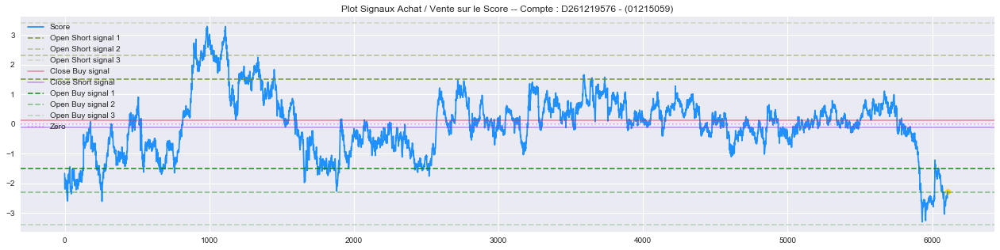



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -127.48 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -128.23 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -132.04 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -127.83 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -127.1 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -115.32 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -118.21 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -119.74 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -123.34 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -122.51 € --- 2.0 couches 
Heure Locale : 2020-05-29 01:50:51  (Le timer est à :  50 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel d

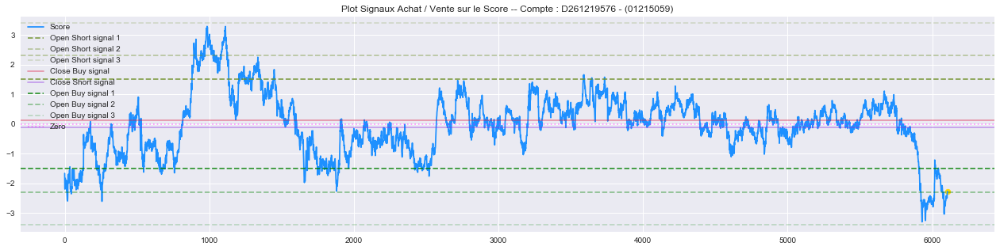



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -126.14 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -130.84 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -131.86 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -134.96 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -131.24 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -132.1 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -126.76 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -128.34 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -134.06 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -131.27 € --- 2.0 couches 
Heure Locale : 2020-05-29 01:55:50  (Le timer est à :  55 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel d

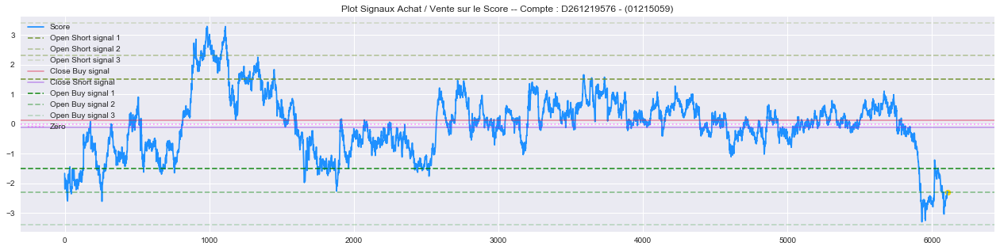



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -134.62 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -140.56 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -149.83 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -141.53 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -131.24 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -133.46 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -135.47 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -136.71 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -125.29 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -110.73 € --- 2.0 couches 
Heure Locale : 2020-05-29 02:00:49  (Le timer est à :  0 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel d

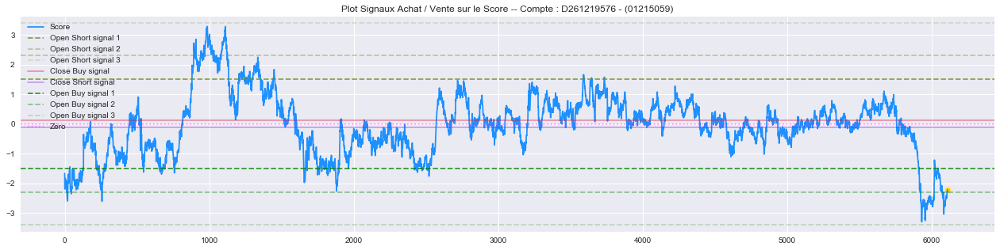



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -109.21 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -104.31 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -103.52 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -107.16 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -94.19 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -115.24 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -120.47 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -136.72 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -131.92 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -131.24 € --- 2.0 couches 
Heure Locale : 2020-05-29 02:05:50  (Le timer est à :  5 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du

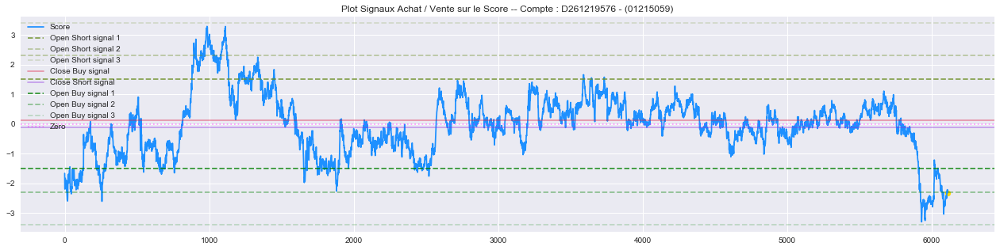



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -142.08 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -144.53 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -161.58 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -156.0 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -154.07 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -169.55 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -165.91 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -178.0 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -168.18 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -161.43 € --- 2.0 couches 
Heure Locale : 2020-05-29 02:10:55  (Le timer est à :  10 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du

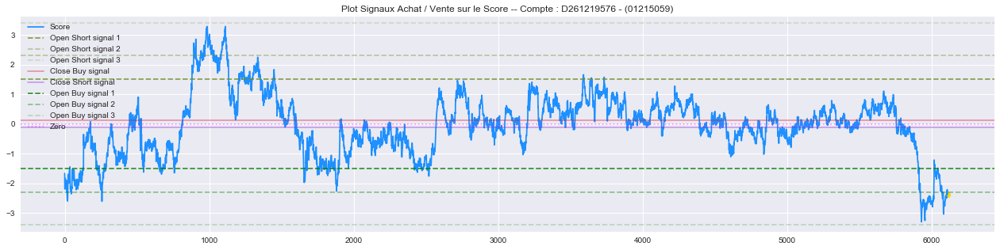



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -158.63 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -158.54 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -161.91 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -162.72 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -173.61 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -171.69 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -167.28 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -163.34 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -182.73 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -178.73 € --- 2.0 couches 
Heure Locale : 2020-05-29 02:15:49  (Le timer est à :  15 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel 

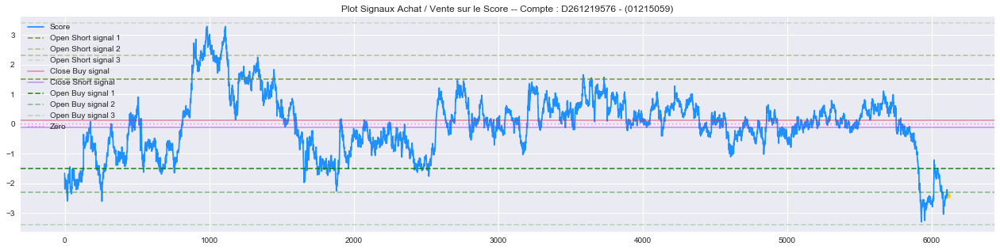



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -178.75 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -176.97 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -193.29 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -198.73 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -188.81 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -199.7 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -182.45 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -183.22 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -186.6 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -179.5 € --- 2.0 couches 
Heure Locale : 2020-05-29 02:20:58  (Le timer est à :  20 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du 

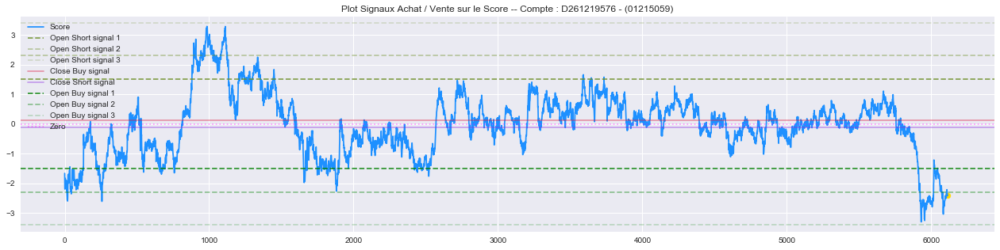



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -169.49 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -172.35 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -168.8 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -143.18 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -99.81 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -99.52 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -108.82 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -94.65 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -71.81 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -55.46 € --- 2.0 couches 
Heure Locale : 2020-05-29 02:25:49  (Le timer est à :  25 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std

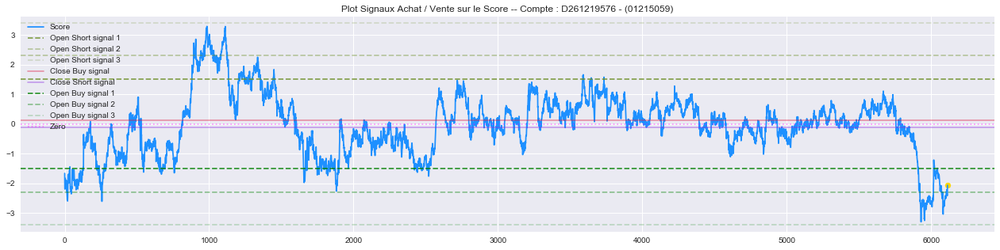



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -49.63 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -49.59 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -57.05 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -51.07 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -48.64 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -64.32 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -36.71 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -40.33 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -56.57 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -58.91 € --- 2.0 couches 
Heure Locale : 2020-05-29 02:30:50  (Le timer est à :  30 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0

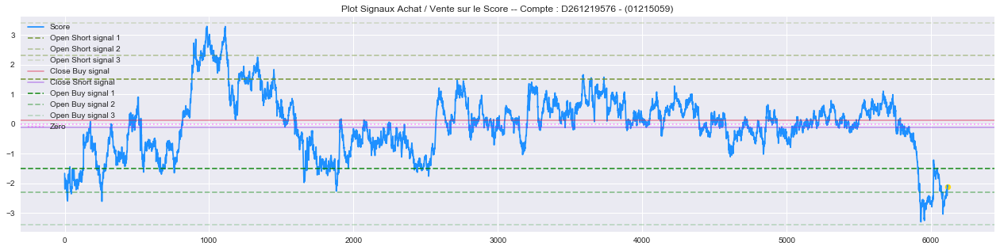



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -65.12 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -66.05 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -49.47 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -36.35 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -30.86 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -33.39 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -57.75 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -65.49 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -78.04 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -75.26 € --- 2.0 couches 
Heure Locale : 2020-05-29 02:35:52  (Le timer est à :  35 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0

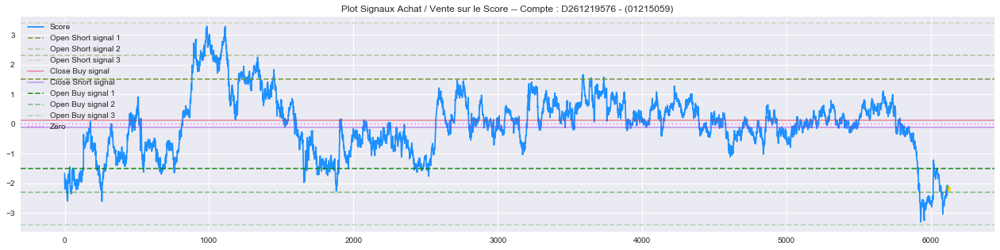



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -79.52 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -78.42 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -85.37 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -74.98 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -72.73 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -75.57 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -39.74 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -43.98 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -55.89 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -48.29 € --- 2.0 couches 
Heure Locale : 2020-05-29 02:40:50  (Le timer est à :  40 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0

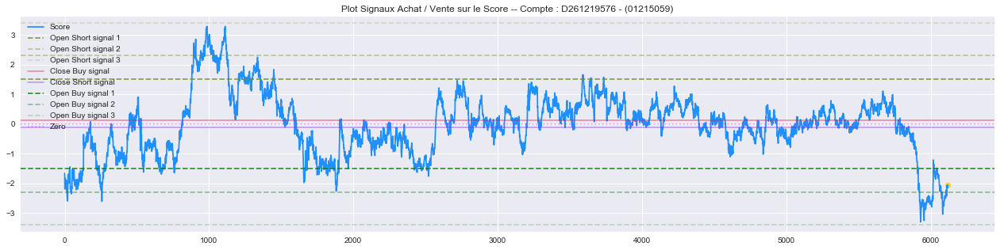



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -42.33 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -44.83 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -12.28 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -20.8 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -32.33 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -31.43 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -51.6 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -49.24 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -51.85 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -10.55 € --- 2.0 couches 
Heure Locale : 2020-05-29 02:45:52  (Le timer est à :  45 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.001

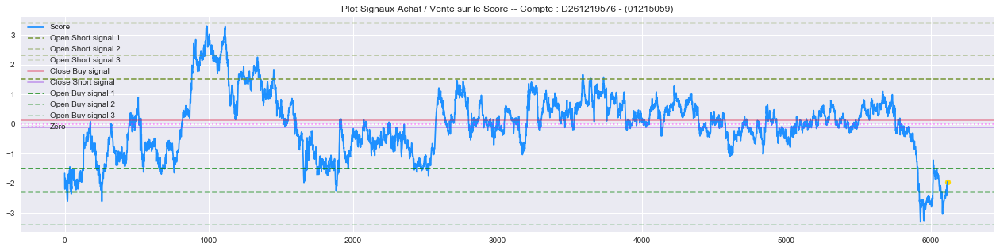



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic PNL ( LONG 2 ): 0.72 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -3.42 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -19.37 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -8.93 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): 3.55 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): 10.02 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): 2.18 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -8.12 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -22.86 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -43.36 € --- 2.0 couches 
Heure Locale : 2020-05-29 02:50:52  (Le timer est à :  50 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.001829901406029

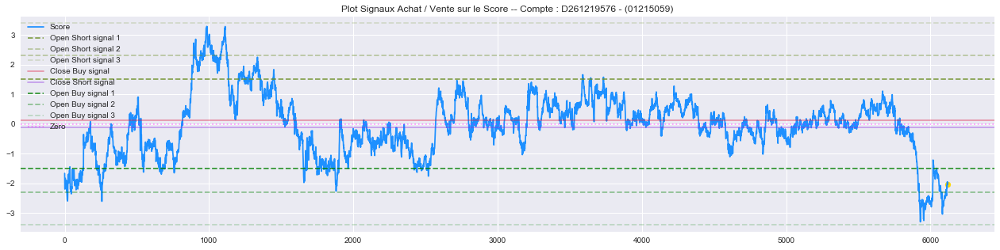



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -37.27 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -40.12 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -40.1 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -32.49 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -29.48 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -51.31 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -31.97 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -11.98 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): 18.58 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): 23.46 € --- 2.0 couches 
Heure Locale : 2020-05-29 02:55:51  (Le timer est à :  55 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018

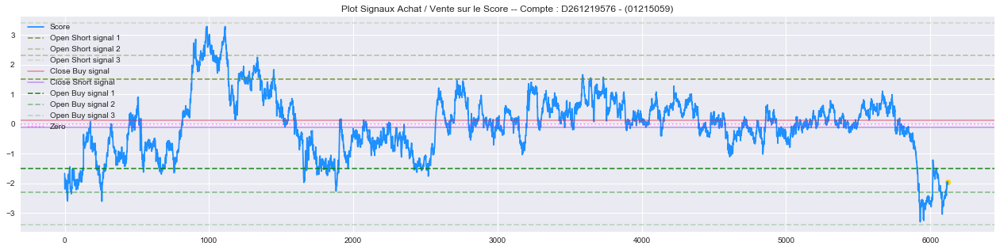



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -8.11 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -16.6 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -60.66 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -56.7 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -102.14 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -75.13 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -72.06 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -53.58 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -77.4 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -82.75 € --- 2.0 couches 
Heure Locale : 2020-05-29 03:00:50  (Le timer est à :  0 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00182

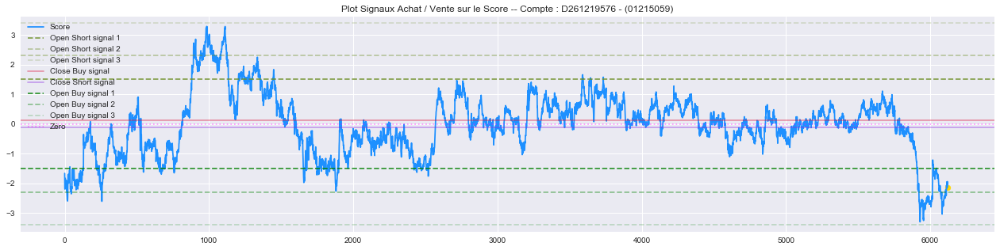



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -69.29 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -52.76 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -34.43 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -45.95 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -42.15 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -28.49 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -46.14 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -32.96 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -38.59 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -65.95 € --- 2.0 couches 
Heure Locale : 2020-05-29 03:05:52  (Le timer est à :  5 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00

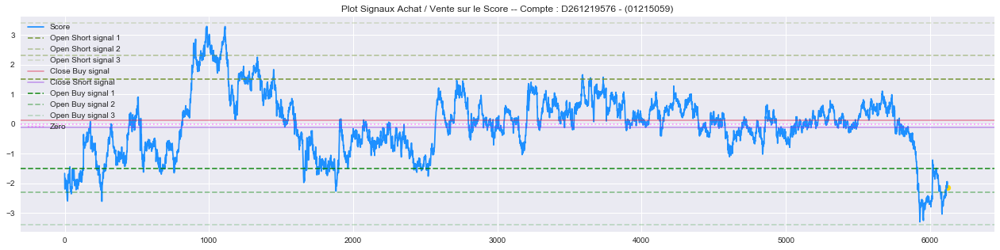



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -73.84 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -88.18 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -82.42 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -101.51 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -94.94 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -95.51 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -105.92 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -97.27 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -86.85 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -93.4 € --- 2.0 couches 
Heure Locale : 2020-05-29 03:10:53  (Le timer est à :  10 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.

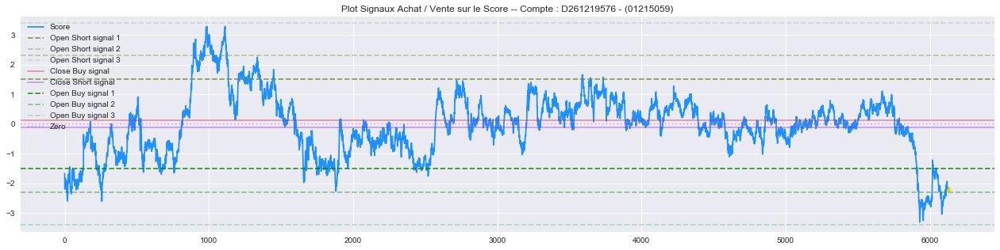



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -98.44 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -109.42 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -106.54 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -117.86 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -110.3 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -122.92 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -109.88 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -129.37 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -123.96 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -135.53 € --- 2.0 couches 
Heure Locale : 2020-05-29 03:15:52  (Le timer est à :  15 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du

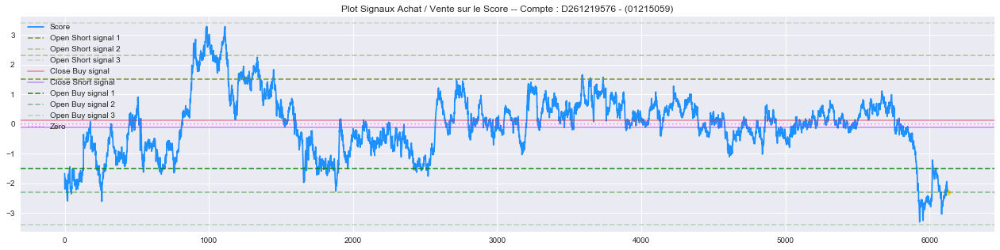



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -135.77 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -127.87 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -114.37 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -109.56 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -78.65 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -81.62 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -81.62 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -94.29 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -139.51 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -117.89 € --- 2.0 couches 
Heure Locale : 2020-05-29 03:20:57  (Le timer est à :  20 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du s

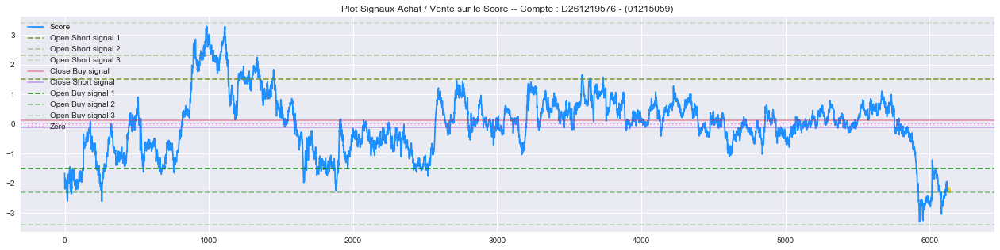



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -108.68 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -107.46 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -113.27 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -95.69 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -84.38 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -83.8 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -92.98 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -101.02 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -78.89 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -80.36 € --- 2.0 couches 
Heure Locale : 2020-05-29 03:25:52  (Le timer est à :  25 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 

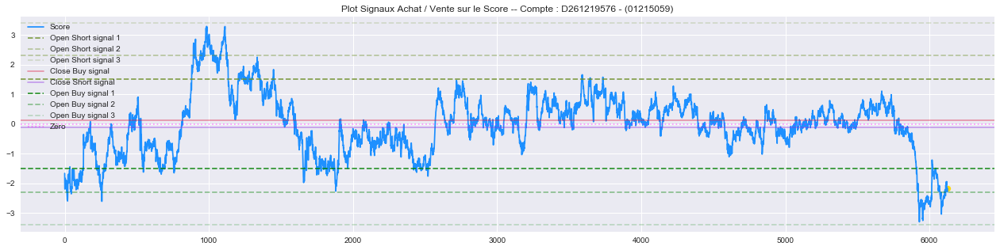



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -88.66 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -77.61 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -73.58 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -59.97 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -25.58 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -38.75 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -41.56 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -31.17 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -32.62 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -50.02 € --- 2.0 couches 
Heure Locale : 2020-05-29 03:30:53  (Le timer est à :  30 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0

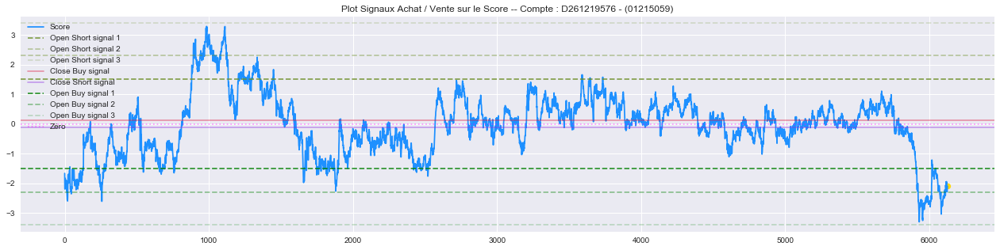



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -58.78 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -56.22 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -41.57 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -67.49 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -55.71 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -32.32 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -26.44 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -26.25 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -30.39 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -26.88 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -12.4 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -18.65 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): 5.96 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): 14.9 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): 12.88 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -5.75 € --- 2.0 couches 
Dynamic  P

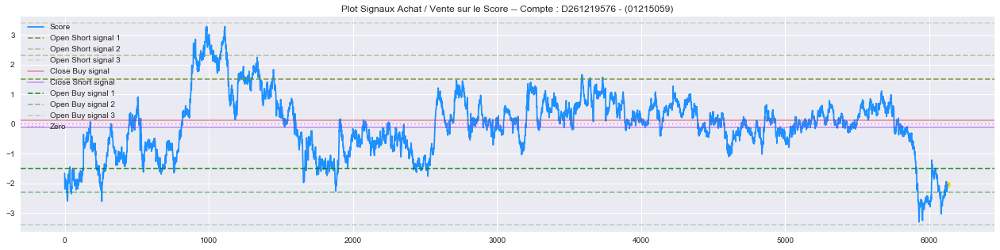



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -29.55 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -25.91 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -85.69 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -66.38 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -75.14 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -50.4 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -71.5 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -85.38 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -79.95 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -67.44 € --- 2.0 couches 
Heure Locale : 2020-05-29 03:45:53  (Le timer est à :  45 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.001

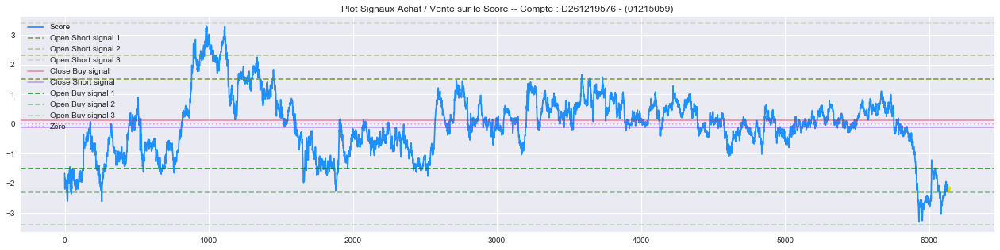



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -86.63 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -83.52 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -70.0 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -66.83 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -61.9 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -55.68 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -28.47 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -59.13 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -60.57 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -57.74 € --- 2.0 couches 
Heure Locale : 2020-05-29 03:50:56  (Le timer est à :  50 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.001

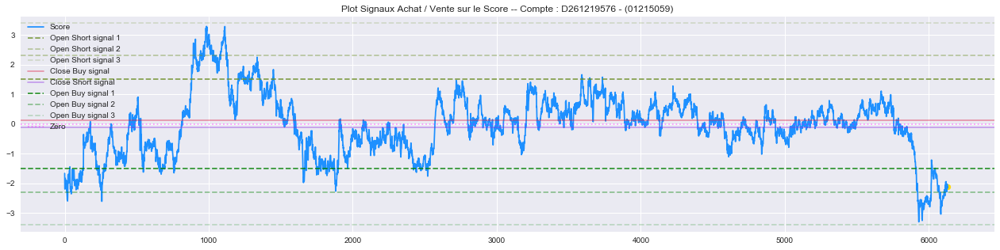



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -52.1 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -60.01 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -43.5 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -44.55 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -75.82 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -72.57 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -80.73 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -78.29 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -85.36 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -77.23 € --- 2.0 couches 
Heure Locale : 2020-05-29 03:55:54  (Le timer est à :  55 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.001

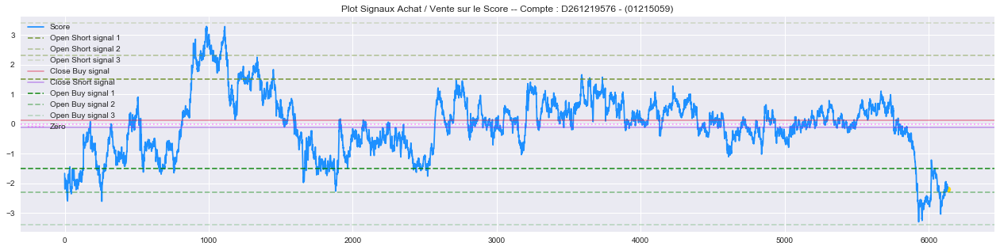



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -91.34 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -97.33 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -86.68 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -78.73 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -75.08 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -68.59 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -71.46 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -84.39 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -84.86 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -71.11 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -54.82 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -46.99 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -64.8 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -48.27 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -71.1 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -82.0 € --- 2.0 couches 
Dynami

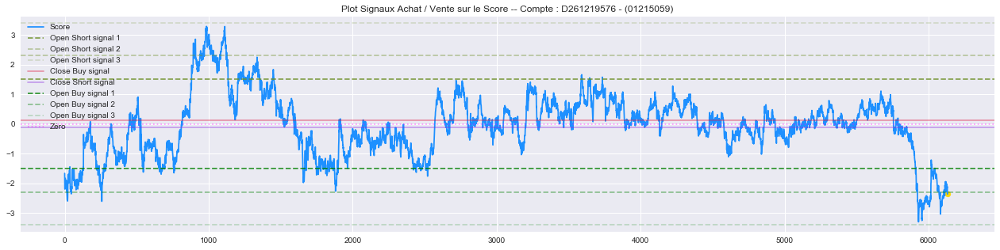



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -154.35 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -153.86 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -152.52 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -157.62 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -149.57 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -133.92 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -125.31 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -142.67 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -144.79 € --- 2.0 couches 
Heure Locale : 2020-05-29 04:20:30  (Le timer est à :  20 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.79802

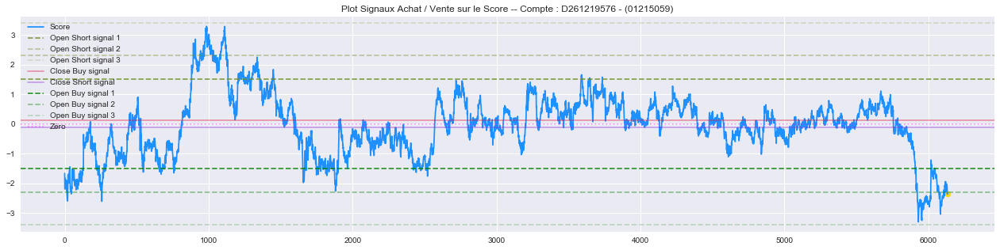



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -145.79 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -130.41 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -118.87 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -126.54 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -107.22 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -100.19 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -104.9 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -109.22 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -102.49 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -102.42 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -97.02 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -85.83 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -75.17 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -77.27 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -68.76 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -63.71 € --- 2.0 cou

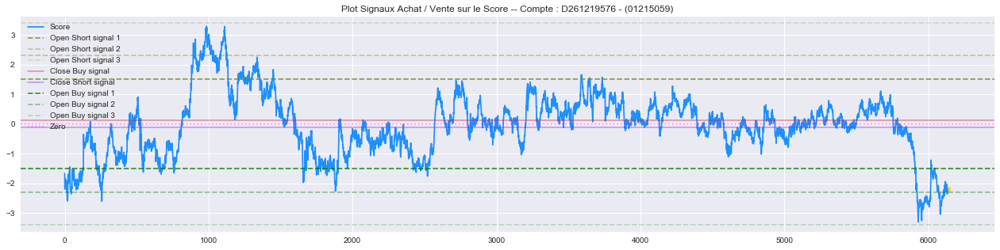



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -93.99 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -80.76 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -88.09 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -86.08 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -79.39 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -65.16 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -73.1 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -92.48 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -91.52 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -96.89 € --- 2.0 couches 
Heure Locale : 2020-05-29 04:35:56  (Le timer est à :  35 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00

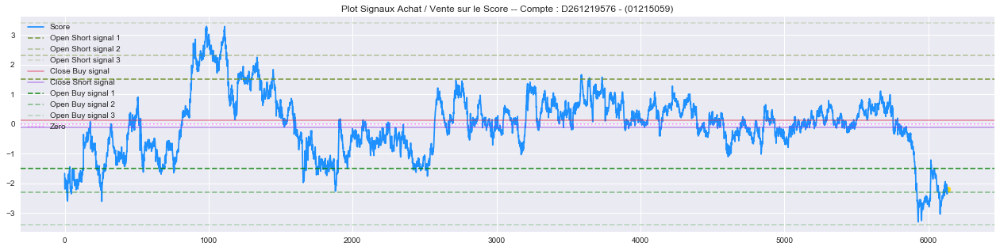



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -87.59 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -87.13 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -86.12 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -79.43 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -75.19 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -70.13 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -91.39 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -81.59 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -77.94 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -84.26 € --- 2.0 couches 
Heure Locale : 2020-05-29 04:40:55  (Le timer est à :  40 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0

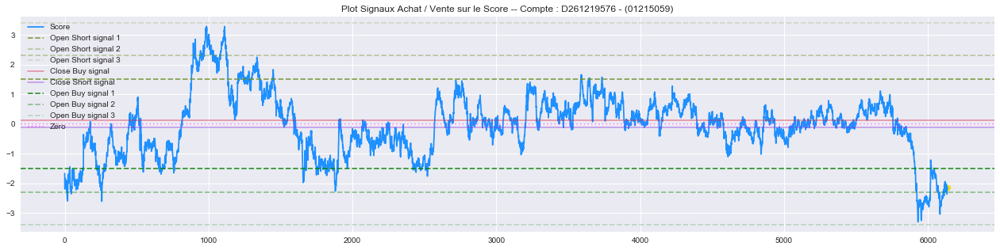



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -70.49 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -72.37 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -82.84 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -82.58 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -78.56 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -73.76 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -85.56 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -77.46 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -67.36 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -82.74 € --- 2.0 couches 
Heure Locale : 2020-05-29 04:45:57  (Le timer est à :  45 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0

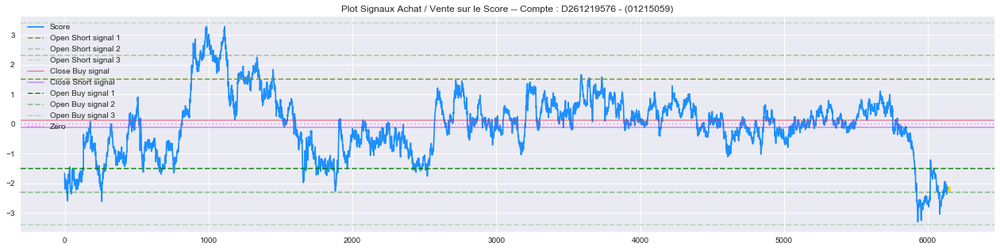



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -81.33 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -86.61 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -52.58 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -54.07 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -59.48 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -57.21 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -58.87 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -39.21 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -42.49 € --- 2.0 couches 
Heure Locale : 2020-05-29 04:50:29  (Le timer est à :  50 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.79802242834489

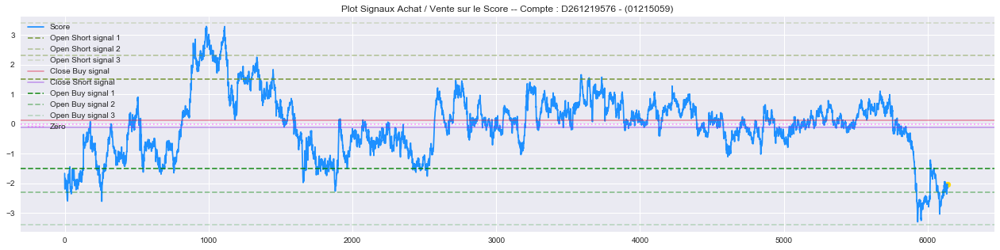



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -35.5 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -43.8 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -54.27 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -33.67 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -34.29 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -37.25 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -42.94 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -67.13 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -62.27 € --- 2.0 couches 
Heure Locale : 2020-05-29 04:55:31  (Le timer est à :  55 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e

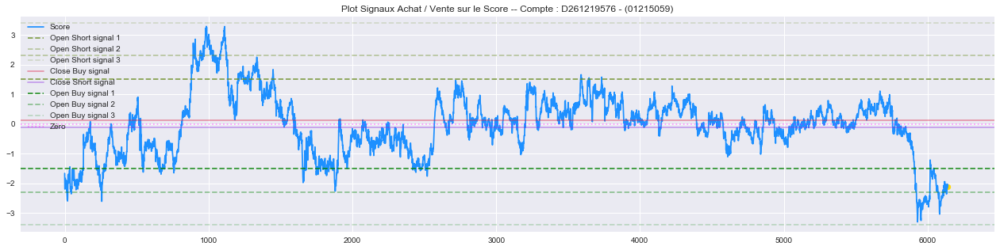



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -65.96 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -60.99 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -58.29 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -56.23 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -63.61 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -61.06 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -63.77 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -55.86 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -54.68 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -76.26 € --- 2.0 couches 
Heure Locale : 2020-05-29 05:00:53  (Le timer est à :  0 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.00

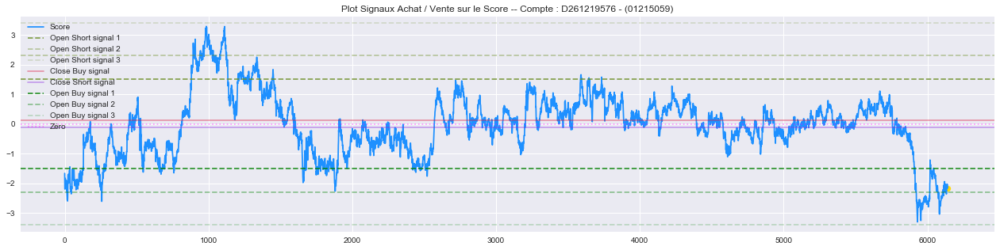



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -80.49 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -79.71 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -79.05 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -87.25 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -85.58 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -108.3 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -114.36 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -115.32 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -110.01 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -117.95 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -129.51 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -129.27 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -120.3 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -115.94 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -131.61 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -128.3 € --- 2.0 couc

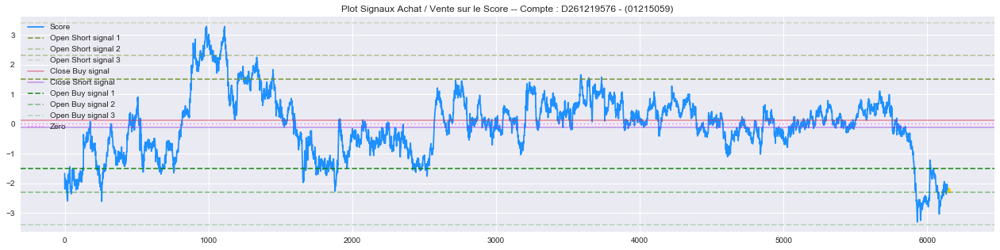



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -105.19 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -103.48 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -107.41 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -108.1 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -107.0 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -103.14 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -78.23 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -67.26 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -75.15 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -82.22 € --- 2.0 couches 
Heure Locale : 2020-05-29 05:15:54  (Le timer est à :  15 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std

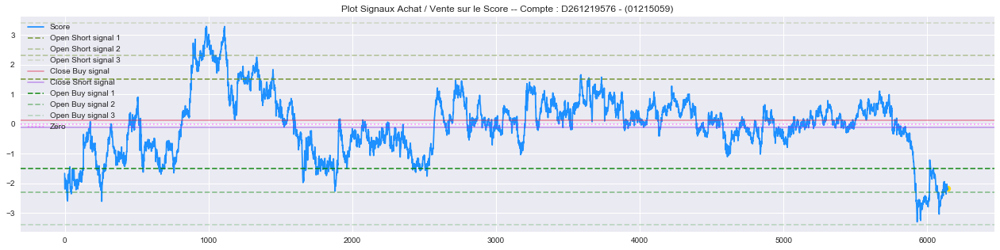



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -80.39 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -84.12 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -60.42 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -59.88 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -55.86 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -72.11 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -65.9 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -56.71 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -55.21 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -61.5 € --- 2.0 couches 
Heure Locale : 2020-05-29 05:20:56  (Le timer est à :  20 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.001

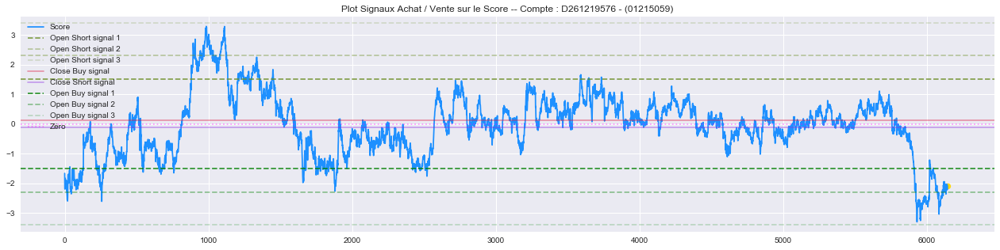



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -55.51 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -53.06 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -60.76 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -62.37 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -63.79 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -57.42 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -49.45 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -49.8 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -48.68 € --- 2.0 couches 
Heure Locale : 2020-05-29 05:25:31  (Le timer est à :  25 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897

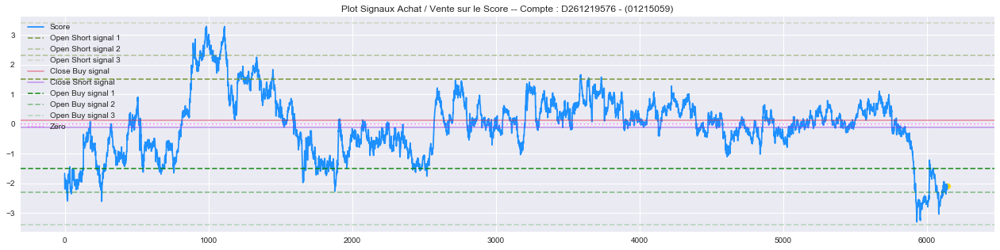



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -53.16 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -57.03 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -56.17 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -56.67 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -64.6 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -48.25 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -42.32 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -42.2 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -40.24 € --- 2.0 couches 
Heure Locale : 2020-05-29 05:30:31  (Le timer est à :  30 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e

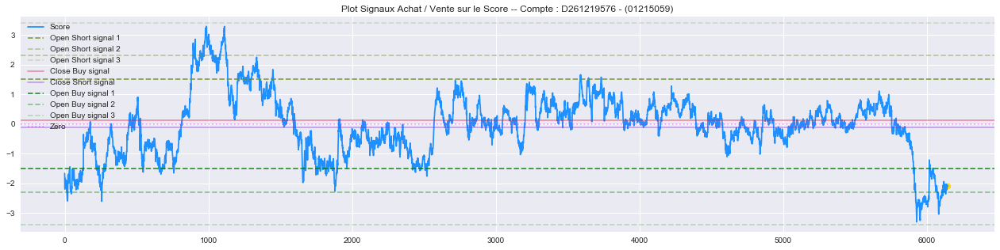



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -57.54 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -60.98 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -56.73 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -35.25 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -23.08 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -19.09 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -26.4 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -30.04 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -34.86 € --- 2.0 couches 
Heure Locale : 2020-05-29 05:35:40  (Le timer est à :  35 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897

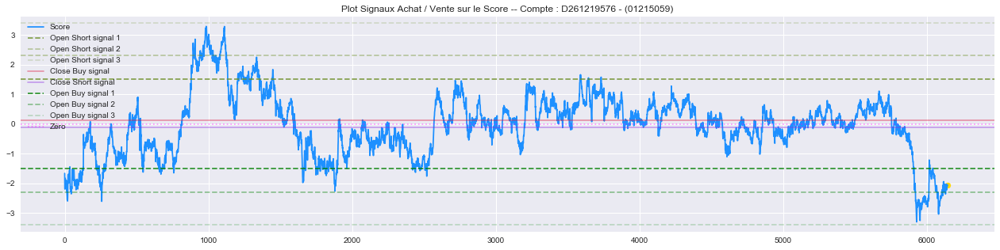



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -39.2 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -29.95 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -25.88 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -27.81 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -24.38 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -21.84 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -15.18 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -15.36 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -9.31 € --- 2.0 couches 
Heure Locale : 2020-05-29 05:40:41  (Le timer est à :  40 )
CALCUL DU DYNAMIC SCORE
   C A L C U L    D E    D Y N _ S  
Rappel des TICKERS ['AUD/USD', 'USD/SEK', 'NZD/USD', 'USD/CAD', 'USD/ZAR']
Rappel des coef [1.88766109 0.145292   0.82648598 0.57021808]
Rappel de cste -0.253390857276665
Rappel du std 0.0018299014060291388
Rappel du mean -1.798022428344897e

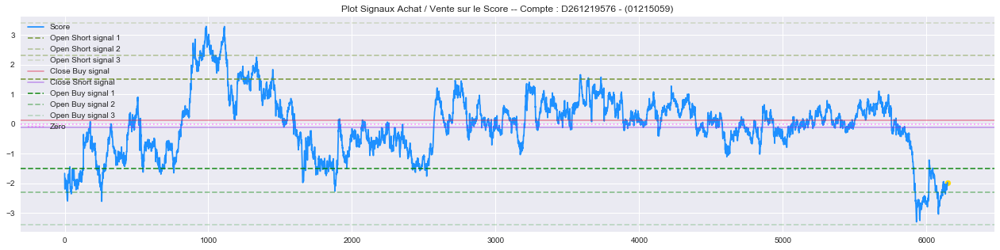



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -11.06 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -18.37 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -23.2 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -22.48 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -16.62 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -15.29 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -9.67 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -5.19 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -5.45 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -16.27 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -13.97 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -26.21 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -28.46 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -20.5 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -4.15 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): 0.93 € --- 2.0 couches 
Dynamic  PN

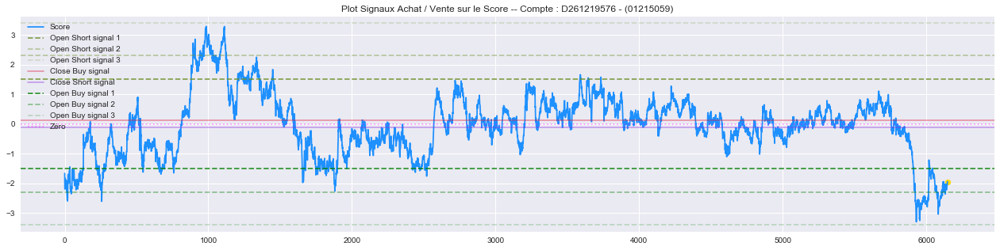



EXECUTION DU PROTOCOLE STAT-ARB



  ./\_-°oO-_____S H O O T_____-Oo°-_./\ 

 NONE ===> ITERATION SUIVANTE


Travaux effectués. Retour à la veille jusqu'à la prochaine fenêtre
Dynamic NET PNL ( LONG 2 ): -1.49 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -0.07 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -3.52 € --- 2.0 couches 
Dynamic  PNL ( LONG 2 ): -9.37 € --- 2.0 couches 
Heure Locale : 2020-05-29 05:52:44 

SSLError: HTTPSConnectionPool(host='api-demo.fxcm.com', port=443): Max retries exceeded with url: /candles/30/m5?num=1 (Caused by SSLError(SSLError("bad handshake: SysCallError(54, 'ECONNRESET')")))

In [5]:
#########################
### CONNEXION A L'API ###
#########################

___Author___='LumberJack Jyss'
print('Global Optimized LumberJack Environment Motor for FOR_EX\nLumberJack Jyss 5780(c)')
print(Fore.BLUE,'°0Oo_D.A.G._26_oO0°')
print(Fore.YELLOW,Back.BLUE,'--- Go!em ForeX #v0.38 ---',Style.RESET_ALL)

for key,val in D.items():
    exec(key + '=val')

print('')
os.system('say " Initialisation du Gaulem faurex"')
os.system('say "Connexion du Gaulem hà la Péh e"')


try:
    con.is_connected() == True
    os.system('say "already Connected"')
    print(Fore.GREEN+'Connexion rétablie'+Style.RESET_ALL)
    print('Compte utilisé : ',con.get_account_ids())
    print('')
    
except:
    try:
        con = conX()
        con.is_connected() == True
        print(Fore.GREEN+'Connexion établie'+Style.RESET_ALL)
        print('Compte utilisé : ',con.get_account_ids())
        os.system('say "Connected"')
    except:
        print(Fore.RED+'Connexion non établie'+Style.RESET_ALL)
        os.system('say "Not Connected, sal rass de mor"')
        print('')



#########################
####### OPERATIVE #######
#########################

os.system('say "ep grade dé daunai"')
balance = con.get_accounts().balance
balance = balance[0]
equity = con.get_accounts().equity
equity = equity[0]
resum = con.get_open_positions()
usable_margin = con.get_accounts_summary().usableMargin3Perc[0]
D['balance'] = balance
D['equity'] = equity
D['usable_margin'] = usable_margin


print('Balance : ',balance)

print('Equity : ',equity)

print('Marge disponible ;',usable_margin,'%')

for key,val in D.items():
    exec(key + '=val')

if len(resum) == 0:
    print('\nPas de position actuellement en cours. Vous pouvez procéder à la suite\n')
    main_func(D)

else:
    
    if (len(resum)%5) != 0:
        print(Back.LIGHTYELLOW_EX,Fore.BLACK,'\nAnomalie détectée. Fermeture de toutes les positions en cours\n',Style.RESET_ALL)
        D = close_all(D)
        for key,val in D.items():
            exec(key + '=val')
        main_func(D)
    
    else:
        print('Récupération des données du Log')
        d = shelve.open('varlog'+compte) 
        for key,val in d.items():
            exec(key + '=val') 
        for key,val in D.items():
            exec(key + '=val')
        d.close()
       
        try:
            dyn_net_pnl = con.get_summary().netPL.sum()
        except:
            dyn_net_pnl = 0
        if dyn_net_pnl >0:
            print('\r'+Fore.GREEN+'Dynamic NET PNL (',sens,'): ',round(dyn_net_pnl,2),'€ --- ',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')            
        elif dyn_net_pnl <0:
            print('\r'+Fore.RED+'Dynamic NET PNL (',sens,'): ',round(dyn_net_pnl,2),'€ --- ',len(con.get_open_positions())/5,'couches \n'+Style.RESET_ALL,end='')
        print('Liste Combo récupérés',TICKERS)
        print('Reprise de la boucle en mode continuum')
        continuum(D)



[]

In [ ]:
######################################################################################################################################################################
######################################################################################################################################################################
#############################################     A     R     C     H     I     V     E     S    #####################################################################
######################################################################################################################################################################
######################################################################################################################################################################

In [ ]:
import shelve

d = shelve.open('varlog'+compte)  # open -- file may get suffix added by low-level
                           # library

d[key] = data              # store data at key (overwrites old data if
                           # using an existing key)
data = d[key]              # retrieve a COPY of data at key (raise KeyError
                           # if no such key)
del d[key]                 # delete data stored at key (raises KeyError
                           # if no such key)

flag = key in d            # true if the key exists
klist = list(d.keys())     # a list of all existing keys (slow!)

# as d was opened WITHOUT writeback=True, beware:
d['xx'] = [0, 1, 2]        # this works as expected, but...
d['xx'].append(3)          # *this doesn't!* -- d['xx'] is STILL [0, 1, 2]!

# having opened d without writeback=True, you need to code carefully:
temp = d['xx']             # extracts the copy
temp.append(5)             # mutates the copy
d['xx'] = temp             # stores the copy right back, to persist it

# or, d=shelve.open(filename,writeback=True) would let you just code
# d['xx'].append(5) and have it work as expected, BUT it would also
# consume more memory and make the d.close() operation slower.

d.close()                  # close it


In [ ]:
VARIABLES = ['_os', 'ol', 'cs', 'cl', 'buy1', 'buy2', 'buy3', 'sell1', 'sell2', 'sell3', 'nbposs', 'nbposl', 'nbpos', 'nbre_trade', 'nbre_trade_long', 'nbre_trade_short', 'pnll', 'pnls', 'amplitude', 'cste', 'mise', 'mark', 'lim_s1', 'lim_s2', 'lim_s3', 'lim_l1', 'lim_l2', 'lim_l3', 'lim_cs', 'lim_cl', 'dyn_S', '_mean', '_std', 'big_len', 'chi_square_value', 'p_value', 'ev', 'v', 'jh_results', 'v1', 'v2', 'skew', 'kurtosis', 'dynf', 'residu', 'p0ol', 'p1ol', 'p2ol', 'p3ol', 'p4ol', 'p0os', 'p1os', 'p2os', 'p3os', 'p4os', 'debut', 'fin', 'split', 'pair', 'pair0', 'pair1', 'pair2', 'pair3', 'pair4', 'coef', 'S', 'PAIR', 'CSTE', 'DYNS', 'BIG_TICKERS', 'INDEX', 'INSTRUMENTS', 'PACK', 'SL_PACK', 'SHORT_LIST', 'TOKEN', 'server', 'user_id', 'compte', 'password', 'period', 'number', 'invers', 'diloug', 'break_it', 'stop', 'full_stop', 'sens', 'name', 'dyn_net_pnl', 'amplitude','mark', 'lim_cl', 'lim_cs', 'lim_l1', 'lim_l2', 'lim_l3', 'lim_s1', 'lim_s2', 'lim_s3', 'dyn_S', 'dynf', 'DYNS', 'deviamax', '_os', 'ol', 'cs', 'cl', 'buy1', 'buy2', 'buy3', 'sell1', 'sell2', 'sell3', 'nbposs', 'nbposl', 'nbpos', 'nbre_trade', 'nbre_trade_long', 'nbre_trade_short', 'pnll', 'pnls', 'p0ol', 'p1ol', 'p2ol', 'p3ol', 'p4ol', 'p0os', 'p1os', 'p2os', 'p3os', 'p4os', 'mark', 'sens', 'deviamax', '_os', 'ol', 'cs', 'cl', 'buy1', 'buy2', 'buy3', 'sell1', 'sell2', 'sell3', 'nbposs', 'nbposl', 'nbpos', 'nbre_trade', 'nbre_trade_long', 'nbre_trade_short', 'pnll', 'pnls', 'residu', 'amplitude', 'cste', 'mise', 'mark', 'lim_s1', 'lim_s2', 'lim_s3', 'lim_l1', 'lim_l2', 'lim_l3', 'lim_cs', 'lim_cl', 'dyn_S', '_mean', '_std', 'big_len', 'kmo_all', 'chi_square_value', 'p_value', 'ev', 'v', 'jh_results', 'v1', 'v2', 'skew', 'kurtosis', 'df', 'residu', 'p0ol', 'p1ol', 'p2ol', 'p3ol', 'p4ol', 'p0os', 'p1os', 'p2os', 'p3os', 'p4os', 'debut', 'fin', 'split', 'base_pair0', 'base_pair1', 'base_pair2', 'base_pair3', 'base_pair4', 'pair', 'pair0', 'pair1', 'pair2', 'pair3', 'pair4', 'coef', 'S', 'PAIR', 'CSTE', 'DYNS', 'TICKERS', 'BIG_TICKERS', 'TIME_FRAME', 'INDEX', 'INSTRUMENTS', 'PACK', 'SL_PACK', 'SHORT_LIST', 'TOKEN', 'server', 'user_id', 'compte', 'password', 'period', 'number', 'invers', 'diloug', 'break_it', 'stop', 'full_stop', 'sens', 'name', 'dyn_net_pnl', 'deviamax', 'mise', 'sens', 'dyn_net_pnl' ]
print(len(VARIABLES))
VARIABLES = list(set(VARIABLES))
print(len(VARIABLES))
print('')
print(VARIABLES)


In [ ]:
def def_mise():
    
    # DEPRECATED SINCE v0.37

    if '/USD' in TICKERS[0]:
        mise = target/_std
        mise = abs(round(mise))
        print('\n Mise en devise :',abs(mise),'pour une target par déviation de',target,'$ \n')
    if 'USD/' in TICKERS[0]:
        mise = ((target/_std) * 2) / (con.get_last_price(TICKERS[0]).Bid + con.get_last_price(TICKERS[0]).Ask)
        mise = abs(round(mise))
        print('\n Mise en devise :',abs(mise),'pour une target par déviation de',target,'$ \n')


    # DEPRECATED SINCE V0.34
    
    taux_pond_list = []
    expo_list = []
    taux = []

    if '/USD' in TICKERS[0]:
        taux.append((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2)
    if 'USD/' in TICKERS[0]:
        taux.append(1/((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2))

    if '/USD' in TICKERS[1]:
        taux.append((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2)
    if 'USD/' in TICKERS[1]:
        taux.append(1/((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2))

    if '/USD' in TICKERS[2]:
        taux.append((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2)
    if 'USD/' in TICKERS[2]:
        taux.append(1/((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2))

    if '/USD' in TICKERS[3]:
        taux.append((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2)
    if 'USD/' in TICKERS[3]:
        taux.append(1/((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2))

    if '/USD' in TICKERS[4]:
        taux.append((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2)
    if 'USD/' in TICKERS[4]:
        taux.append(1/((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2))

    taux_pond_list.append(taux[0])
    for t in range(1,5):
        taux_pond_list.append(abs(coef[t-1] * taux[t]))

    mise = (balance * 4)/(sum(taux_pond_list))
    
    '''
    if '/USD' in TICKERS[0]:
        mise = (balance * 2)/(sum(taux_pond_list))
    if 'USD/' in TICKERS[0]:
        mise = (balance * 2)/(abs(coef[0]) + abs(coef[1]) + abs(coef[2]) + abs(coef[3]))
        '''

    return(mise)

In [ ]:
def _dyns_close(D):
    global nbre_trade, PAIR, mise, cs, pnls, _std, sens, name, skew, nbposl, v1, nbre_trade_long, lim_l2, BIG_TICKERS, nbposs, compte, fin, p3ol, full_stop, pnll, buy2, lim_cs, amplitude, lim_s1, break_it, base_pair0, p3os, chi_square_value, period, split, lim_s2, TOKEN, _mean, coef, base_pair2, base_pair1, user_id, p0ol, sell1, sell2, p_value, p2os, buy3, jh_results, TICKERS, kmo_all, DYNS, SL_PACK, cl, p1os, lim_s3, _os, dyn_S, pair4, pair3, v, S, PACK, lim_cl, sell3, nbpos, buy1, SHORT_LIST, stop, daf, p1ol, diloug, p4ol, v2, big_len, invers, lim_l3, dynf, INSTRUMENTS, base_pair4, deviamax, password, pair2, TIME_FRAME, p2ol, cste, kurtosis, CSTE, residu, p4os, lim_l1, server, number, base_pair3, dyn_net_pnl, mark, pair1, ol, ev, pair0, nbre_trade_short, p0os, pair, INDEX, debut, dynamic_combo, dynamic_residu,take_profit
    
    for key,val in D.items():
        exec(key + '=val')
     
    print(Back.LIGHTBLUE_EX,Fore.YELLOW,' C A L C U L    D E    D Y N _ S ',Style.RESET_ALL)

    print('\n\nTAILLES DES POSITIONS (coef x mise en devise en valeur relative):')
    try:
        if '/USD' in TICKERS[0]:
            print(TICKERS[0],' : ', mise)
        if 'USD/' in TICKERS[0]:
            print(TICKERS[0],' : ', mise / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2))
    except:
        print(TICKERS[0],' => NON VALIDE')

    try:
        if '/USD' in TICKERS[1]:
            print(TICKERS[1],' : ', mise * (coef[0]))
        if 'USD/' in TICKERS[1]:
            print(TICKERS[1],' : ', mise * (coef[0]) / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2))
    except:
        print(TICKERS[1],' => NON VALIDE')
    try:
        if '/USD' in TICKERS[2]:
            print(TICKERS[2],' : ', mise * (coef[1]))
        if 'USD/' in TICKERS[2]:
            print(TICKERS[2],' : ', mise * (coef[1]) / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2))
    except:
        print(TICKERS[2],' => NON VALIDE')
    try:
        if '/USD' in TICKERS[3]:
            print(TICKERS[3],' : ', mise * (coef[2]))
        if 'USD/' in TICKERS[3]:
            print(TICKERS[3],' : ', mise * (coef[2]) / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2))
    except:
        print(TICKERS[3],' => NON VALIDE')
    try:
        if '/USD' in TICKERS[4]:
            print(TICKERS[4],' : ', mise * (coef[3]))
        if 'USD/' in TICKERS[4]:
            print(TICKERS[4],' : ', mise * (coef[3]) / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2))
    except:
        print(TICKERS[4],' => NON VALIDE')
    print('\n')

    print('Le Score max est : ',max(S),' et le Score min : ',min(S))

    mark = -1
   
    if '/USD' in TICKERS[0]:
        dyn_pair0  = scrap_close(ticker=TICKERS[0],invers = 'non')
    if 'USD/' in TICKERS[0]:
        dyn_pair0  = scrap_close(ticker=TICKERS[0],invers = 'oui')
    dyn_pair0 ['Local time'] = dyn_pair0 .index
    dyn_pair0 .reset_index(drop=True, inplace=True)
    D['dyn_pair0'] = dyn_pair0
    #dyn_pair0  = dyn_pair0 .iloc[-576:,:]
    if '/USD' in TICKERS[1]:
        dyn_pair1  = scrap_close(ticker=TICKERS[1],invers = 'non')
    if 'USD/' in TICKERS[1]:
        dyn_pair1  = scrap_close(ticker=TICKERS[1],invers = 'oui')
    dyn_pair1['Local time'] = dyn_pair1.index
    dyn_pair1.reset_index(drop=True, inplace=True)
    D['dyn_pair1'] = dyn_pair1
    #dyn_pair1 = dyn_pair1.iloc[-576:,:]
    if '/USD' in TICKERS[2]:
        dyn_pair2  = scrap_close(ticker=TICKERS[2],invers = 'non')
    if 'USD/' in TICKERS[2]:
        dyn_pair2  = scrap_close(ticker=TICKERS[2],invers = 'oui')
    dyn_pair2['Local time'] = dyn_pair2.index
    dyn_pair2.reset_index(drop=True, inplace=True)
    D['dyn_pair2'] = dyn_pair2
    #dyn_pair2 = dyn_pair2.iloc[-576:,:]
    if '/USD' in TICKERS[3]:
        dyn_pair3  = scrap_close(ticker=TICKERS[3],invers = 'non')
    if 'USD/' in TICKERS[3]:
        dyn_pair3  = scrap_close(ticker=TICKERS[3],invers = 'oui')
    dyn_pair3['Local time'] = dyn_pair3.index
    dyn_pair3.reset_index(drop=True, inplace=True)
    D['dyn_pair3'] = dyn_pair3
    #dyn_pair3 = dyn_pair3.iloc[-576:,:]
    if '/USD' in TICKERS[4]:
        dyn_pair4  = scrap_close(ticker=TICKERS[4],invers = 'non')
    if 'USD/' in TICKERS[4]:
        dyn_pair4  = scrap_close(ticker=TICKERS[4],invers = 'oui')
    dyn_pair4['Local time'] = dyn_pair4.index
    dyn_pair4.reset_index(drop=True, inplace=True)
    D['dyn_pair4'] = dyn_pair4
    #dyn_pair4 = dyn_pair4.iloc[-576:,:]


    dynf = pd.DataFrame()
    dynf[TICKERS[0]] = list(dyn_pair0['Close'])
    dynf[TICKERS[1]] = list(dyn_pair1['Close'])
    dynf[TICKERS[2]] = list(dyn_pair2['Close'])
    dynf[TICKERS[3]] = list(dyn_pair3['Close'])
    dynf[TICKERS[4]] = list(dyn_pair4['Close'])

    #dynamic_df = df[df.index <= dyn_pair1.iloc[mark]['Local time']]
    print(Fore.MAGENTA,'')
    print('(Heure correspondant à la dernière bougie récupérée)')
    print(Style.RESET_ALL,'')
    print(Back.RED,Fore.BLACK,' A C T I V A T I O N   D U   D Y N _ C O M B O   E T   D E S   L I M I T E S',Style.RESET_ALL,'\n')
    
    dynamic_combo = coef[0] * dynf[TICKERS[1]] + coef[1] * dynf[TICKERS[2]] + coef[2] * dynf[TICKERS[3]] + coef[3] * dynf[TICKERS[4]] + cste

    dynamic_residu = dynf[TICKERS[0]] - dynamic_combo
    dyn_S = (dynamic_residu - _mean)/_std
    D['dynf'] = dynf
    D['dynamic_combo'] = dynamic_combo
    D['dynamic_residu'] = dynamic_residu
    
    #DYNS.append(dyn_S.reset_index(drop=True).iloc[-2016:])
    #DYNS = dyn_S.reset_index(drop=True).iloc[-2016:]
    dyn_S = dyn_S.iloc[-1]
    DYNS.append(dyn_S)
    D['dyn_S'] = dyn_S
    D['DYNS'] = DYNS

    lim_s1 = 1 
    lim_s2 = 2 
    lim_s3 = 3
    print('Limite short 1 : ',lim_s1,'Limite short 2 : ',lim_s2,'Limite short 3 : ',lim_s3)
    lim_l1 = -1 
    lim_l2 = -2 
    lim_l3 = -3 
    print('Limite long 1 : ',lim_l1,'Limite long 2 : ',lim_l2,'Limite long 3 : ',lim_l3)
    lim_cs = -0.13 
    print('Limite close short : ',lim_cs)
    lim_cl = 0.13 
    print('Limite close long : ',lim_cl)

    D['lim_s1'] = lim_s1
    D['lim_s2'] = lim_s2
    D['lim_s3'] = lim_s3
    D['lim_l1'] = lim_l1
    D['lim_l2'] = lim_l2
    D['lim_l3'] = lim_l3
    D['li_cs'] = lim_cs
    D['lim_cl'] = lim_cl

    

    print(Back.LIGHTBLUE_EX,Fore.YELLOW,'Dyn_S : ',dyn_S,Style.RESET_ALL)
    print('Pour mémoire le spread (résidu) dynamique est de :',dynamic_residu.iloc[-1])

    for key,val in D.items():
        exec(key + '=val')

    plt.ion()
    plt.figure(figsize=(22,5)) 
    plt.plot(DYNS,label='Score')
    plt.axhline(y=lim_s1,c='olivedrab',alpha=0.8,linestyle='--',label='Open Short signal 1')
    plt.axhline(y=lim_s2,c='olivedrab',alpha=0.4,linestyle='--',label='Open Short signal 2')
    plt.axhline(y=lim_s3,c='olivedrab',alpha=0.2,linestyle='--',label='Open Short signal 3')
    plt.axhline(y=lim_cl,c='crimson',alpha=0.4,linestyle='-',label='Close Buy signal')
    plt.axhline(y=lim_cs,c='blueviolet',alpha=0.4,linestyle='-',label='Close Short signal')
    plt.axhline(y=lim_l1,c='green',alpha=0.8,linestyle='--',label='Open Buy signal 1')
    plt.axhline(y=lim_l2,c='green',alpha=0.4,linestyle='--',label='Open Buy signal 2')
    plt.axhline(y=lim_l3,c='green',alpha=0.2,linestyle='--',label='Open Buy signal 3')
    plt.axhline(y=(lim_cl+lim_cs)/2,c='magenta',alpha=0.4,linestyle=':',label='Zéro')
    plt.legend()
    plt.title('Plot Signaux Achat / Vente sur le Score -- Compte :',user_id,' - (',compte,')')
    plt.pause(0.05)
    
    return(D)

def _dyns(D): 
    global nbre_trade, PAIR, mise, cs, pnls, _std, sens, name, skew, nbposl, v1, nbre_trade_long, lim_l2, BIG_TICKERS, nbposs, compte, fin, p3ol, full_stop, pnll, buy2, lim_cs, amplitude, lim_s1, break_it, base_pair0, p3os, chi_square_value, period, split, lim_s2, TOKEN, _mean, coef, base_pair2, base_pair1, user_id, p0ol, sell1, sell2, p_value, p2os, buy3, jh_results, TICKERS, kmo_all, DYNS, SL_PACK, cl, p1os, lim_s3, _os, dyn_S, pair4, pair3, v, S, PACK, lim_cl, sell3, nbpos, buy1, SHORT_LIST, stop, daf, p1ol, diloug, p4ol, v2, big_len, invers, lim_l3, dynf, INSTRUMENTS, base_pair4, deviamax, password, pair2, TIME_FRAME, p2ol, cste, kurtosis, CSTE, residu, p4os, lim_l1, server, number, base_pair3, dyn_net_pnl, mark, pair1, ol, ev, pair0, nbre_trade_short, p0os, pair, INDEX, debut, dynamic_combo, dynamic_residu,take_profit
    for key,val in D.items():
        exec(key + '=val')
     
    print(Back.LIGHTBLUE_EX,Fore.YELLOW,' C A L C U L    D E    D Y N _ S ',Style.RESET_ALL)

    print('\n\nTAILLES DES POSITIONS (coef x mise en devise):')
    try:
        if '/USD' in TICKERS[0]:
            print(TICKERS[0],' : ', mise)
        if 'USD/' in TICKERS[0]:
            print(TICKERS[0],' : ', mise / ((con.get_last_price(TICKERS[0]).Bid+con.get_last_price(TICKERS[0]).Ask)/2))
    except:
        print(TICKERS[0],' => NON VALIDE')

    try:
        if '/USD' in TICKERS[1]:
            print(TICKERS[1],' : ', mise * (coef[0]))
        if 'USD/' in TICKERS[1]:
            print(TICKERS[1],' : ', mise * (coef[0]) / ((con.get_last_price(TICKERS[1]).Bid+con.get_last_price(TICKERS[1]).Ask)/2))
    except:
        print(TICKERS[1],' => NON VALIDE')
    try:
        if '/USD' in TICKERS[2]:
            print(TICKERS[2],' : ', mise * (coef[1]))
        if 'USD/' in TICKERS[2]:
            print(TICKERS[2],' : ', mise * (coef[1]) / ((con.get_last_price(TICKERS[2]).Bid+con.get_last_price(TICKERS[2]).Ask)/2))
    except:
        print(TICKERS[2],' => NON VALIDE')
    try:
        if '/USD' in TICKERS[3]:
            print(TICKERS[3],' : ', mise * (coef[2]))
        if 'USD/' in TICKERS[3]:
            print(TICKERS[3],' : ', mise * (coef[2]) / ((con.get_last_price(TICKERS[3]).Bid+con.get_last_price(TICKERS[3]).Ask)/2))
    except:
        print(TICKERS[3],' => NON VALIDE')
    try:
        if '/USD' in TICKERS[4]:
            print(TICKERS[4],' : ', mise * (coef[3]))
        if 'USD/' in TICKERS[4]:
            print(TICKERS[4],' : ', mise * (coef[3]) / ((con.get_last_price(TICKERS[4]).Bid+con.get_last_price(TICKERS[4]).Ask)/2))
    except:
        print(TICKERS[4],' => NON VALIDE')
    print('\n')

    print('Le Score max est : ',max(S),' et le Score min : ',min(S))

    mark = -1
    if '/USD' in TICKERS[0]:
        dyn_pair0  = scrap_hist(ticker=TICKERS[0],invers = 'non')
    if 'USD/' in TICKERS[0]:
        dyn_pair0  = scrap_hist(ticker=TICKERS[0],invers = 'oui')
    dyn_pair0 ['Local time'] = dyn_pair0 .index
    dyn_pair0 .reset_index(drop=True, inplace=True)
    D['dyn_pair0'] = dyn_pair0
    #dyn_pair0  = dyn_pair0 .iloc[-576:,:]
    if '/USD' in TICKERS[1]:
        dyn_pair1  = scrap_hist(ticker=TICKERS[1],invers = 'non')
    if 'USD/' in TICKERS[1]:
        dyn_pair1  = scrap_hist(ticker=TICKERS[1],invers = 'oui')
    dyn_pair1['Local time'] = dyn_pair1.index
    dyn_pair1.reset_index(drop=True, inplace=True)
    D['dyn_pair1'] = dyn_pair1
    #dyn_pair1 = dyn_pair1.iloc[-576:,:]
    if '/USD' in TICKERS[2]:
        dyn_pair2  = scrap_hist(ticker=TICKERS[2],invers = 'non')
    if 'USD/' in TICKERS[2]:
        dyn_pair2  = scrap_hist(ticker=TICKERS[2],invers = 'oui')
    dyn_pair2['Local time'] = dyn_pair2.index
    dyn_pair2.reset_index(drop=True, inplace=True)
    D['dyn_pair2'] = dyn_pair2
    #dyn_pair2 = dyn_pair2.iloc[-576:,:]
    if '/USD' in TICKERS[3]:
        dyn_pair3  = scrap_hist(ticker=TICKERS[3],invers = 'non')
    if 'USD/' in TICKERS[3]:
        dyn_pair3  = scrap_hist(ticker=TICKERS[3],invers = 'oui')
    dyn_pair3['Local time'] = dyn_pair3.index
    dyn_pair3.reset_index(drop=True, inplace=True)
    D['dyn_pair3'] = dyn_pair3
    #dyn_pair3 = dyn_pair3.iloc[-576:,:]
    if '/USD' in TICKERS[4]:
        dyn_pair4  = scrap_hist(ticker=TICKERS[4],invers = 'non')
    if 'USD/' in TICKERS[4]:
        dyn_pair4  = scrap_hist(ticker=TICKERS[4],invers = 'oui')
    dyn_pair4['Local time'] = dyn_pair4.index
    dyn_pair4.reset_index(drop=True, inplace=True)
    D['dyn_pair4'] = dyn_pair4
    #dyn_pair4 = dyn_pair4.iloc[-576:,:]

    for key,val in D.items():
        exec(key + '=val')

    dynf = pd.DataFrame(index=dyn_pair1['Local time'])
    dynf[TICKERS[0]] = list(dyn_pair0 ['Close'])
    dynf[TICKERS[1]] = list(dyn_pair1['Close'])
    dynf[TICKERS[2]] = list(dyn_pair2['Close'])
    dynf[TICKERS[3]] = list(dyn_pair3['Close'])
    dynf[TICKERS[4]] = list(dyn_pair4['Close'])

    #dynamic_df = dynf[dynf.index <= dyn_pair1.iloc[mark]['Local time']]
    print(Fore.MAGENTA,'')
    print('Heure correspondant à la dernière bougie récupérée : ',dyn_pair1.iloc[mark]['Local time'])
    print('')
    print(Style.RESET_ALL,'')
    print(Back.RED,Fore.BLACK,' A C T I V A T I O N   D U   D Y N _ C O M B O   E T   D E S   L I M I T E S',Style.RESET_ALL,'\n')
    
    dynamic_combo = coef[0] * dynf[TICKERS[1]] + coef[1] * dynf[TICKERS[2]] + coef[2] * dynf[TICKERS[3]] + coef[3] * dynf[TICKERS[4]] + cste

    dynamic_residu = dynf[TICKERS[0]] - dynamic_combo
    dyn_S = (dynamic_residu - _mean)/_std
    
    D['dynf'] = dynf
    D['dynamic_combo'] = dynamic_combo
    D['dynamic_residu'] = dynamic_residu

    #DYNS.append(dyn_S.reset_index(drop=True).iloc[-2016:])
    #DYNS = dyn_S.reset_index(drop=True).iloc[-2016:]
    dyn_S = dyn_S.iloc[-1]
    DYNS.append(dyn_S)
    D['dyn_S'] = dyn_S
    D['DYNS'] = DYNS

    for key,val in D.items():
        exec(key + '=val')
    
    print("L'amplitude détectée est de ",amplitude)
    print('Limite short 1',lim_s1,'Limite short 2',lim_s2,'Limite short 3',lim_s3)
    print('Limite long 1',lim_l1,'Limite long 2',lim_l2,'Limite long 3',lim_l3)
    print('Limite close short',lim_cs)
    print('Limite close long',lim_cl)
    print(Back.LIGHTBLUE_EX,Fore.YELLOW,'Dyn_S : ',dyn_S,Style.RESET_ALL)
    print('Pour mémoire le spread (résidu) dynamique est de :',dynamic_residu.iloc[-1])

    plt.ion() 
    plt.figure(figsize=(22,5)) 
    plt.plot(DYNS,label='Score')
    plt.axhline(y=lim_s1,c='olivedrab',alpha=0.8,linestyle='--',label='Open Short signal 1')
    plt.axhline(y=lim_s2,c='olivedrab',alpha=0.4,linestyle='--',label='Open Short signal 2')
    plt.axhline(y=lim_s3,c='olivedrab',alpha=0.2,linestyle='--',label='Open Short signal 3')
    plt.axhline(y=lim_cl,c='crimson',alpha=0.4,linestyle='-',label='Close Buy signal')
    plt.axhline(y=lim_cs,c='blueviolet',alpha=0.4,linestyle='-',label='Close Short signal')
    plt.axhline(y=lim_l1,c='green',alpha=0.8,linestyle='--',label='Open Buy signal 1')
    plt.axhline(y=lim_l2,c='green',alpha=0.4,linestyle='--',label='Open Buy signal 2')
    plt.axhline(y=lim_l3,c='green',alpha=0.2,linestyle='--',label='Open Buy signal 3')
    plt.axhline(y=(lim_cl+lim_cs)/2,c='magenta',alpha=0.4,linestyle=':',label='Zéro')
    plt.legend()
    plt.title('Plot Signaux Achat / Vente sur le Score -- Compte :',user_id,' - (',compte,')')
    plt.pause(0.05)

    return(D)


In [14]:
def init_by_def(D):
    global nbre_trade, PAIR, mise, cs, pnls, _std, sens, name, skew, nbposl, v1, nbre_trade_long, lim_l2, BIG_TICKERS, nbposs, compte, fin, p3ol, full_stop, pnll, buy2, lim_cs, amplitude, lim_s1, break_it, base_pair0, p3os, chi_square_value, period, split, lim_s2, TOKEN, _mean, coef, base_pair2, base_pair1, user_id, p0ol, sell1, sell2, p_value, p2os, buy3, jh_results, TICKERS, kmo_all, DYNS, SL_PACK, cl, p1os, lim_s3, _os, dyn_S, pair4, pair3, v, S, PACK, lim_cl, sell3, nbpos, buy1, SHORT_LIST, stop, df, p1ol, diloug, p4ol, v2, big_len, invers, lim_l3, dynf, INSTRUMENTS, base_pair4, deviamax, password, pair2, TIME_FRAME, p2ol, cste, kurtosis, CSTE, residu, p4os, lim_l1, server, number, base_pair3, dyn_net_pnl, mark, pair1, ol, ev, pair0, nbre_trade_short, p0os, pair, INDEX, debut, dynamic_combo, dynamic_residu


1.0592595751218767